In [1]:
from scapy.all import rdpcap, IP, TCP, UDP
import pandas as pd
import matplotlib.pyplot as plt
import os
import numpy as np
from itertools import cycle

### Procesamiento de trazas

In [2]:
PCAP_PATH = "../escenario-prueba/pcaps"
CONTAINER_IP = "10.0.1.5"
SERVER_IP = "10.0.2.5"

In [3]:
def procesar_traza(pcap_path):
    
    try:
        packets = rdpcap(pcap_path)

        start_time = packets[0].time
        label = pcap_path.split("10.0.2.5_")[1].split(".pcap")[0].split("poblation_")[1].split("_")[:3]
        label = "_".join(label)
        
        packet_features = []
        
        total_size = 0
        outgoing = 0
        incoming = 0
        out_size = 0
        in_size = 0
        interarrival_times = []
        last_time = None

        for packet in packets:
            if IP in packet:
                
                if UDP in packet:
                    continue
                
                if not ((packet[IP].dst == SERVER_IP or packet[IP].src == SERVER_IP) and (packet[IP].dst == CONTAINER_IP or packet[IP].src == CONTAINER_IP)):
                    continue
                
                size = len(packet)
                if packet[IP].src == CONTAINER_IP:
                    direction = -1
                    outgoing += 1
                    out_size += size
                else:
                    direction = 1
                    incoming += 1
                    in_size += size
                
                total_size += size
                
                rel_time = float(packet.time - start_time)        
                            
                if last_time is not None:
                    delta = packet.time - last_time
                    interarrival_times.append(float(delta))
                last_time = packet.time

                packet_features.append([
                    direction,
                    size,
                    rel_time,
                ])

        if interarrival_times:
            iat_mean = np.mean(interarrival_times)
            iat_std = np.std(interarrival_times)
            iat_min = np.min(interarrival_times)
            iat_max = np.max(interarrival_times)
            iat_median = np.median(interarrival_times)
        else:
            iat_mean = iat_std = iat_min = iat_max = iat_median = 0

        min_packet_size = np.min([p[1] for p in packet_features]) if packet_features else 0
        max_packet_size = np.max([p[1] for p in packet_features]) if packet_features else 0
        mean_packet_size = np.mean([p[1] for p in packet_features]) if packet_features else 0
        std_packet_size = np.std([p[1] for p in packet_features]) if packet_features else 0

        global_features = {
            "total_packets": incoming + outgoing,
            "incoming_packets": incoming,
            "outgoing_packets": outgoing,
            "incoming_bytes": in_size,
            "outgoing_bytes": out_size,
            "total_size": total_size,
            "incoming_outgoing_ratio": incoming / outgoing if outgoing > 0 else 0,
            "mean_interarrival_time": float(iat_mean),
            "std_interarrival_time": float(iat_std),
            "min_interarrival_time": float(iat_min),
            "max_interarrival_time": float(iat_max),
            "median_interarrival_time": float(iat_median),
            "min_packet_size": int(min_packet_size),
            "max_packet_size": int(max_packet_size),
            "mean_packet_size": float(mean_packet_size),
            "std_packet_size": float(std_packet_size),
        }
                
        return label, global_features, packet_features

    except Exception as e:
        print(f"Error processing {pcap_path}: {e}")
        return None, None, None

In [4]:
pcaps = os.listdir(PCAP_PATH)
data = []

for pcap in pcaps[:]:
    l, g, p = procesar_traza(pcap_path=os.path.join(PCAP_PATH, pcap))
    if l == None or g == None or p == None:
        print(f"Error processing {pcap}")
        continue
    data.append({"label": l, "packet_features": p, "global_features": g})

Exportar datos

In [5]:
import json
from collections import Counter

labels = [d["label"] for d in data]
counter = Counter(labels)
num_labels = len(counter)
num_instances = int(len(data) / num_labels)

print(f"Number of labels: {num_labels}")
print(f"Number of instances per label: {num_instances}")

Number of labels: 300
Number of instances per label: 35


In [6]:
with open(f'./data/poblation_{num_labels}x{num_instances}.json', 'w') as f:
    json.dump(data, f)

Cargar datos

In [ ]:
DATA_PATH = "../data/poblation_120x20.json"

with open(DATA_PATH) as json_file:
    data = json.load(json_file)

### Procesamiento de datos

In [252]:
df = pd.json_normalize(data)
df.describe()

,global_features.total_packets,global_features.incoming_packets,global_features.outgoing_packets,global_features.incoming_bytes,global_features.outgoing_bytes,global_features.total_size,global_features.incoming_outgoing_ratio,global_features.mean_interarrival_time,global_features.std_interarrival_time,global_features.min_interarrival_time,global_features.max_interarrival_time,global_features.median_interarrival_time,global_features.min_packet_size,global_features.max_packet_size,global_features.mean_packet_size,global_features.std_packet_size
count,10500.000000,10500.000000,10500.000000,1.050000e+04,10500.000000,1.050000e+04,10500.000000,10500.000000,10500.000000,1.050000e+04,10500.000000,1.050000e+04,10500.000000,10500.0,10500.000000,10500.000000
mean,1048.818571,747.168286,301.650286,1.050613e+06,51681.315905,1.102294e+06,2.483893,0.000250,0.001693,-1.134286e-07,0.033897,3.261095e-06,65.984000,1514.0,1042.726806,646.129946
std,412.399157,298.042416,122.438698,4.399175e+05,14905.911626,4.515026e+05,0.348358,0.000093,0.000827,4.199867e-07,0.023026,9.889116e-07,0.437907,0.0,47.562889,21.003620
min,159.000000,104.000000,51.000000,1.146680e+05,9653.000000,1.372850e+05,1.138173,0.000129,0.000737,-2.100000e-05,0.009799,2.000000e-06,54.000000,1514.0,807.558824,502.947871
25%,735.000000,517.000000,215.000000,7.130982e+05,39165.000000,7.535860e+05,2.279251,0.000183,0.001145,0.000000e+00,0.012558,3.000000e-06,66.000000,1514.0,1014.934000,631.919274
50%,945.000000,672.000000,271.000000,9.483375e+05,51142.000000,9.908855e+05,2.462417,0.000226,0.001434,0.000000e+00,0.029237,3.000000e-06,66.000000,1514.0,1043.358612,647.353234
75%,1355.000000,975.000000,371.250000,1.386495e+06,63391.500000,1.446401e+06,2.669256,0.000290,0.001927,0.000000e+00,0.040508,3.000000e-06,66.000000,1514.0,1073.301014,660.675130
max,2917.000000,1874.000000,1043.000000,2.746836e+06,95953.000000,2.842789e+06,6.112903,0.001112,0.007457,1.000000e-06,0.192082,1.300000e-05,66.000000,1514.0,1267.903628,709.446535


max_packet_size y min_packet_size no aportan mucha información, las quitamos

In [253]:
df.drop(columns=["global_features.max_packet_size", "global_features.min_packet_size"], inplace=True)
df.describe()

,global_features.total_packets,global_features.incoming_packets,global_features.outgoing_packets,global_features.incoming_bytes,global_features.outgoing_bytes,global_features.total_size,global_features.incoming_outgoing_ratio,global_features.mean_interarrival_time,global_features.std_interarrival_time,global_features.min_interarrival_time,global_features.max_interarrival_time,global_features.median_interarrival_time,global_features.mean_packet_size,global_features.std_packet_size
count,10500.000000,10500.000000,10500.000000,1.050000e+04,10500.000000,1.050000e+04,10500.000000,10500.000000,10500.000000,1.050000e+04,10500.000000,1.050000e+04,10500.000000,10500.000000
mean,1048.818571,747.168286,301.650286,1.050613e+06,51681.315905,1.102294e+06,2.483893,0.000250,0.001693,-1.134286e-07,0.033897,3.261095e-06,1042.726806,646.129946
std,412.399157,298.042416,122.438698,4.399175e+05,14905.911626,4.515026e+05,0.348358,0.000093,0.000827,4.199867e-07,0.023026,9.889116e-07,47.562889,21.003620
min,159.000000,104.000000,51.000000,1.146680e+05,9653.000000,1.372850e+05,1.138173,0.000129,0.000737,-2.100000e-05,0.009799,2.000000e-06,807.558824,502.947871
25%,735.000000,517.000000,215.000000,7.130982e+05,39165.000000,7.535860e+05,2.279251,0.000183,0.001145,0.000000e+00,0.012558,3.000000e-06,1014.934000,631.919274
50%,945.000000,672.000000,271.000000,9.483375e+05,51142.000000,9.908855e+05,2.462417,0.000226,0.001434,0.000000e+00,0.029237,3.000000e-06,1043.358612,647.353234
75%,1355.000000,975.000000,371.250000,1.386495e+06,63391.500000,1.446401e+06,2.669256,0.000290,0.001927,0.000000e+00,0.040508,3.000000e-06,1073.301014,660.675130
max,2917.000000,1874.000000,1043.000000,2.746836e+06,95953.000000,2.842789e+06,6.112903,0.001112,0.007457,1.000000e-06,0.192082,1.300000e-05,1267.903628,709.446535


Renombramos las columnas que empiezan por global_features

In [254]:
gf_cols = [col for col in df.columns if col.startswith("global_features")]
mapping = { col: col.replace("global_features.", "") for col in gf_cols }
new_names = list(mapping.values())
print("Columnas renombradas:")
for old, new in mapping.items():
    print(f"  {old} → {new}")
df = df.rename(columns=mapping)
df.describe()

Columnas renombradas:
  global_features.total_packets → total_packets
  global_features.incoming_packets → incoming_packets
  global_features.outgoing_packets → outgoing_packets
  global_features.incoming_bytes → incoming_bytes
  global_features.outgoing_bytes → outgoing_bytes
  global_features.total_size → total_size
  global_features.incoming_outgoing_ratio → incoming_outgoing_ratio
  global_features.mean_interarrival_time → mean_interarrival_time
  global_features.std_interarrival_time → std_interarrival_time
  global_features.min_interarrival_time → min_interarrival_time
  global_features.max_interarrival_time → max_interarrival_time
  global_features.median_interarrival_time → median_interarrival_time
  global_features.mean_packet_size → mean_packet_size
  global_features.std_packet_size → std_packet_size


,total_packets,incoming_packets,outgoing_packets,incoming_bytes,outgoing_bytes,total_size,incoming_outgoing_ratio,mean_interarrival_time,std_interarrival_time,min_interarrival_time,max_interarrival_time,median_interarrival_time,mean_packet_size,std_packet_size
count,10500.000000,10500.000000,10500.000000,1.050000e+04,10500.000000,1.050000e+04,10500.000000,10500.000000,10500.000000,1.050000e+04,10500.000000,1.050000e+04,10500.000000,10500.000000
mean,1048.818571,747.168286,301.650286,1.050613e+06,51681.315905,1.102294e+06,2.483893,0.000250,0.001693,-1.134286e-07,0.033897,3.261095e-06,1042.726806,646.129946
std,412.399157,298.042416,122.438698,4.399175e+05,14905.911626,4.515026e+05,0.348358,0.000093,0.000827,4.199867e-07,0.023026,9.889116e-07,47.562889,21.003620
min,159.000000,104.000000,51.000000,1.146680e+05,9653.000000,1.372850e+05,1.138173,0.000129,0.000737,-2.100000e-05,0.009799,2.000000e-06,807.558824,502.947871
25%,735.000000,517.000000,215.000000,7.130982e+05,39165.000000,7.535860e+05,2.279251,0.000183,0.001145,0.000000e+00,0.012558,3.000000e-06,1014.934000,631.919274
50%,945.000000,672.000000,271.000000,9.483375e+05,51142.000000,9.908855e+05,2.462417,0.000226,0.001434,0.000000e+00,0.029237,3.000000e-06,1043.358612,647.353234
75%,1355.000000,975.000000,371.250000,1.386495e+06,63391.500000,1.446401e+06,2.669256,0.000290,0.001927,0.000000e+00,0.040508,3.000000e-06,1073.301014,660.675130
max,2917.000000,1874.000000,1043.000000,2.746836e+06,95953.000000,2.842789e+06,6.112903,0.001112,0.007457,1.000000e-06,0.192082,1.300000e-05,1267.903628,709.446535


In [255]:
label_counts = df['label'].value_counts().reset_index()
label_counts.columns = ['Label', 'Count']
display(label_counts)

,Label,Count
0,798283_45_0000,35
1,511828_57_0000,35
2,4052310_35_0000,35
3,511828_25_0000,35
4,9239647_47_0000,35
...,...,...
295,9239647_61_0000,35
296,7638443_51_0000,35
297,3871694_21_0000,35
298,511828_9_0000,35


In [256]:
df["label_size"] = df["label"].str.split("_").str[0].astype(int)
df["label_imgs"] = df["label"].str.split("_").str[1].astype(int)
combined_counts = df.groupby(['label_size', 'label_imgs']).size().reset_index(name='Count')
display(combined_counts)

,label_size,label_imgs,Count
0,511828,5,35
1,511828,7,35
2,511828,9,35
3,511828,11,35
4,511828,13,35
...,...,...,...
295,9239647,55,35
296,9239647,57,35
297,9239647,59,35
298,9239647,61,35


In [257]:
df["dif"] = df["incoming_bytes"].astype(int) - df["label_size"].astype(int)
df[df["dif"] < 0][["label", "dif"]].head(10)

,label,dif
1,4052310_35_0000,-3282503
2,511828_25_0000,-181294
3,9239647_47_0000,-7595519
4,7638443_61_0000,-5627842
5,9239647_55_0000,-7495370
6,2771049_63_0000,-1612129
7,4052310_61_0000,-2440980
8,800378_41_0000,-62599
9,3734496_33_0000,-2578057
10,4052310_49_0000,-3390149


In [258]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
import seaborn as sns

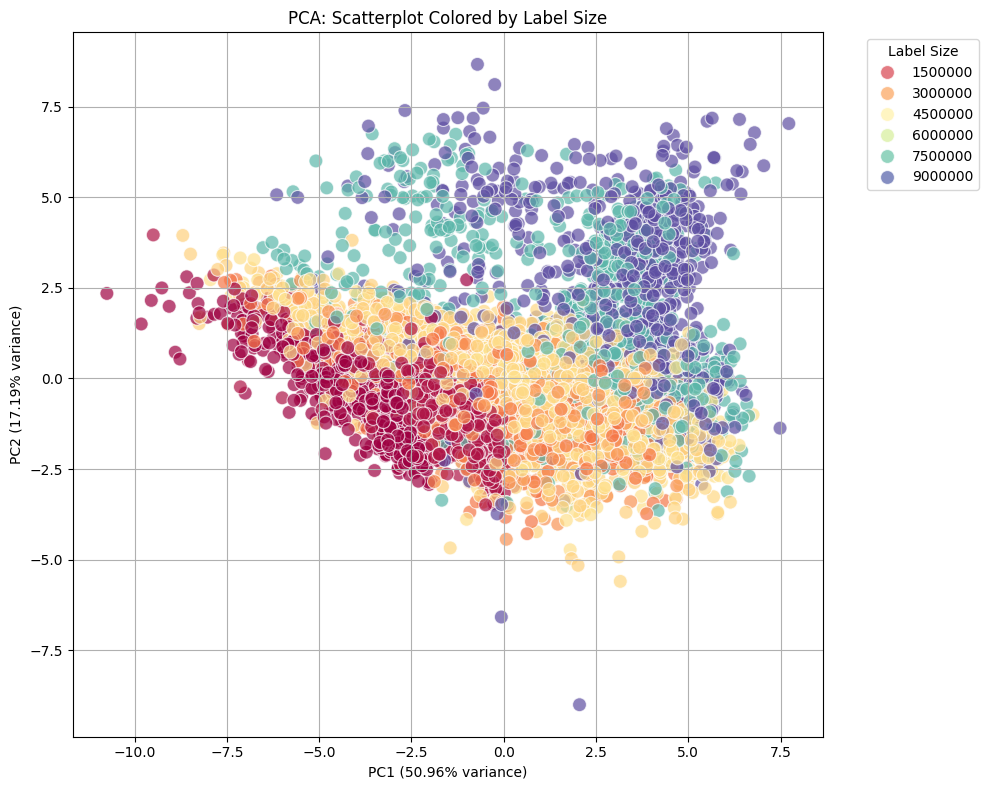

In [259]:
list_columns = [col for col in df.columns if df[col].apply(lambda x: isinstance(x, list)).any()]
exclude_columns = ['label', 'label_size', 'label_imgs'] + list_columns
feature_columns = [col for col in df.columns if col not in exclude_columns]

X = df[feature_columns].select_dtypes(include=[np.number]).values
y = df['label_size'].values

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Aplicar PCA para reducir a 2 dimensiones
pca = PCA(n_components=2, random_state=42)
X_2d = pca.fit_transform(X_scaled)

df_2d = pd.DataFrame(X_2d, columns=['PC1', 'PC2'])
df_2d['label_size'] = y

# Gráfico de dispersión
plt.figure(figsize=(10, 8))
sns.scatterplot(data=df_2d, x='PC1', y='PC2', hue='label_size', palette='Spectral', s=100, alpha=0.7)
plt.title('PCA: Scatterplot Colored by Label Size')
plt.xlabel(f'PC1 ({pca.explained_variance_ratio_[0]:.2%} variance)')
plt.ylabel(f'PC2 ({pca.explained_variance_ratio_[1]:.2%} variance)')
plt.legend(title='Label Size', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.tight_layout()
plt.show()

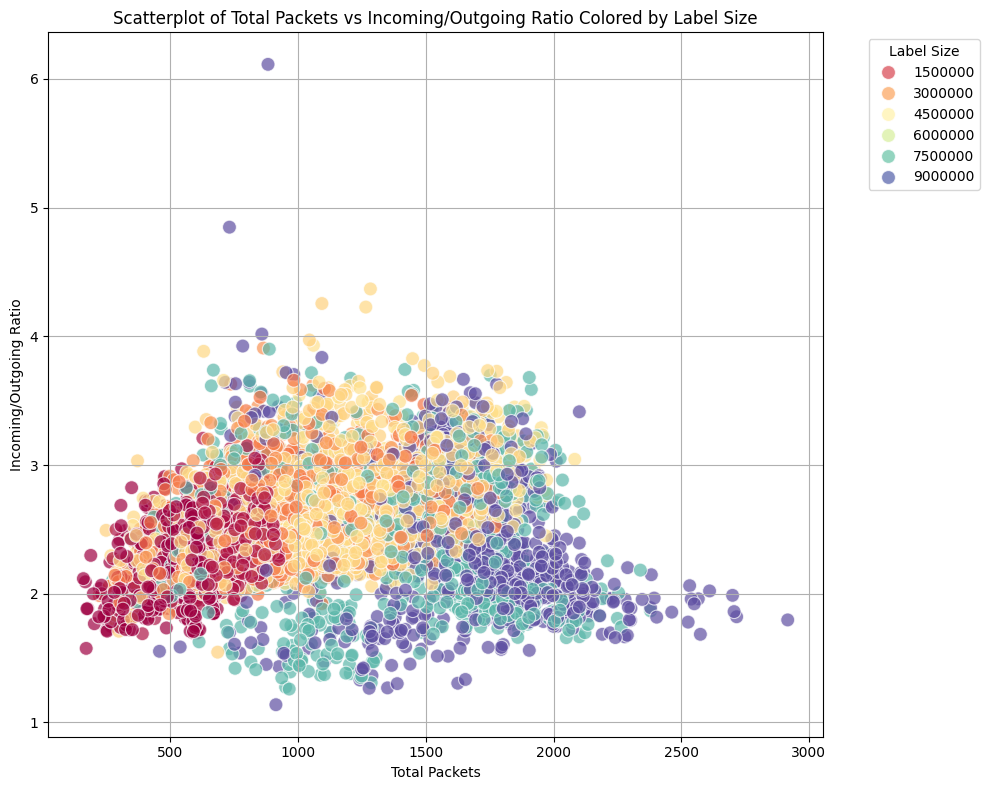

In [260]:
X = df[["total_packets", "incoming_outgoing_ratio"]]
y = df["label_size"]

# Crear DataFrame para visualización
df_plot = X.copy()
df_plot['label_size'] = y

# Gráfico de dispersión
plt.figure(figsize=(10, 8))
sns.scatterplot(data=df_plot, x='total_packets', y='incoming_outgoing_ratio', hue='label_size', palette='Spectral', s=100, alpha=0.7)
plt.title('Scatterplot of Total Packets vs Incoming/Outgoing Ratio Colored by Label Size')
plt.xlabel('Total Packets')
plt.ylabel('Incoming/Outgoing Ratio')
plt.legend(title='Label Size', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.tight_layout()
plt.show()

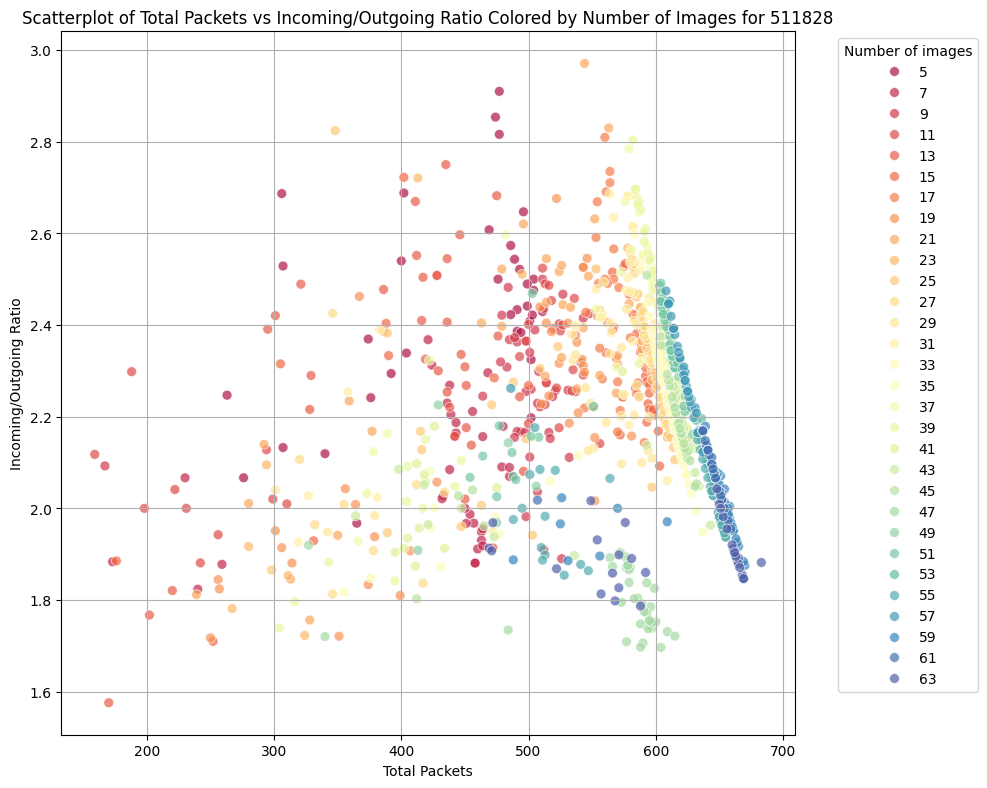

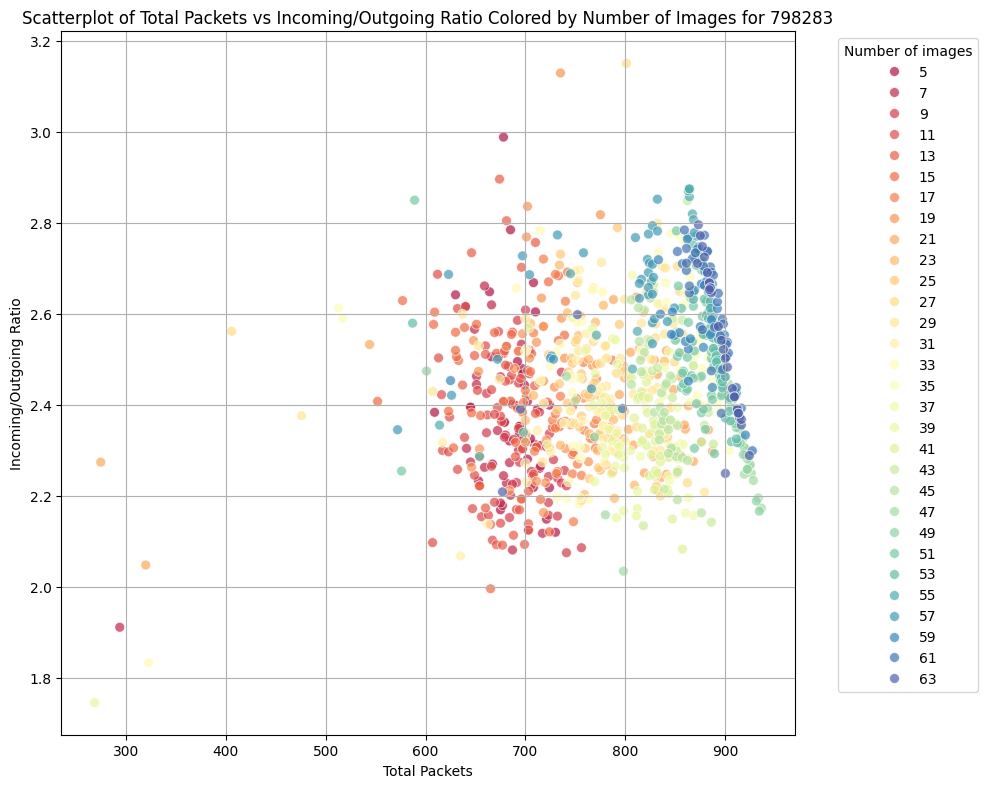

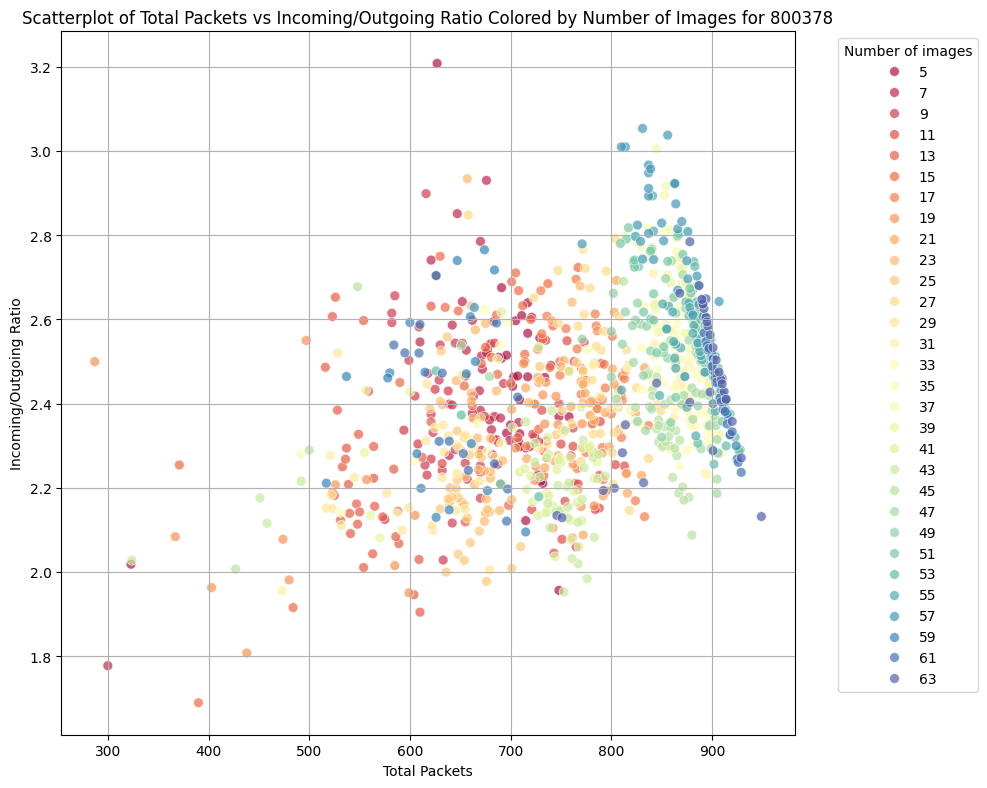

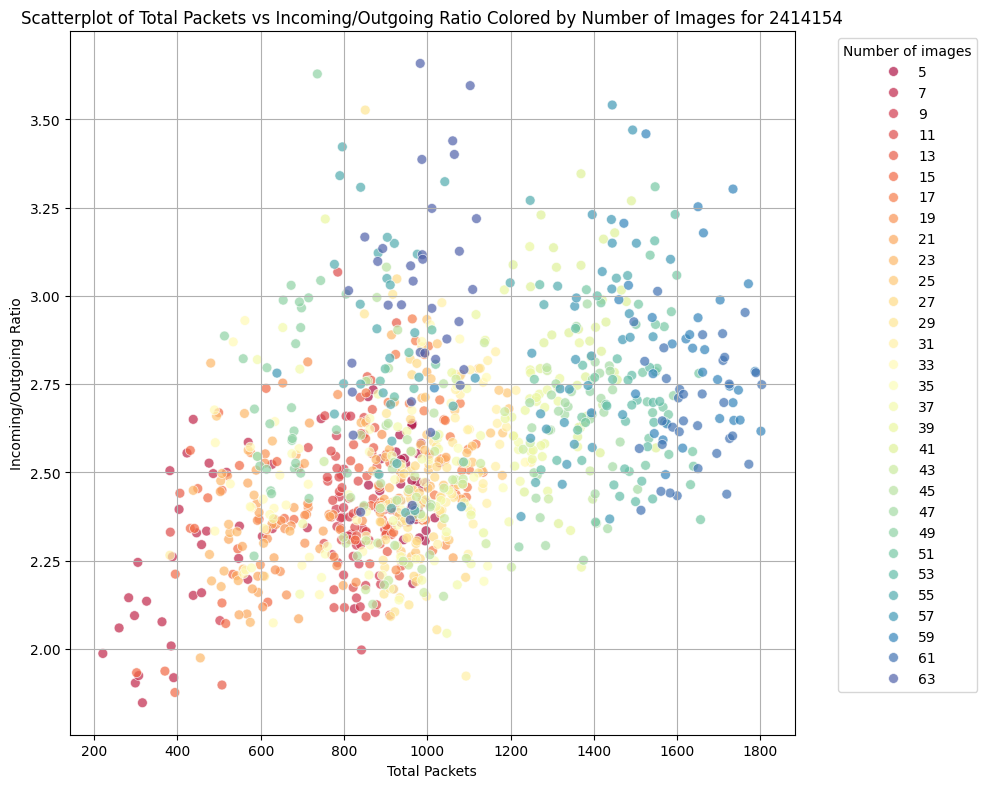

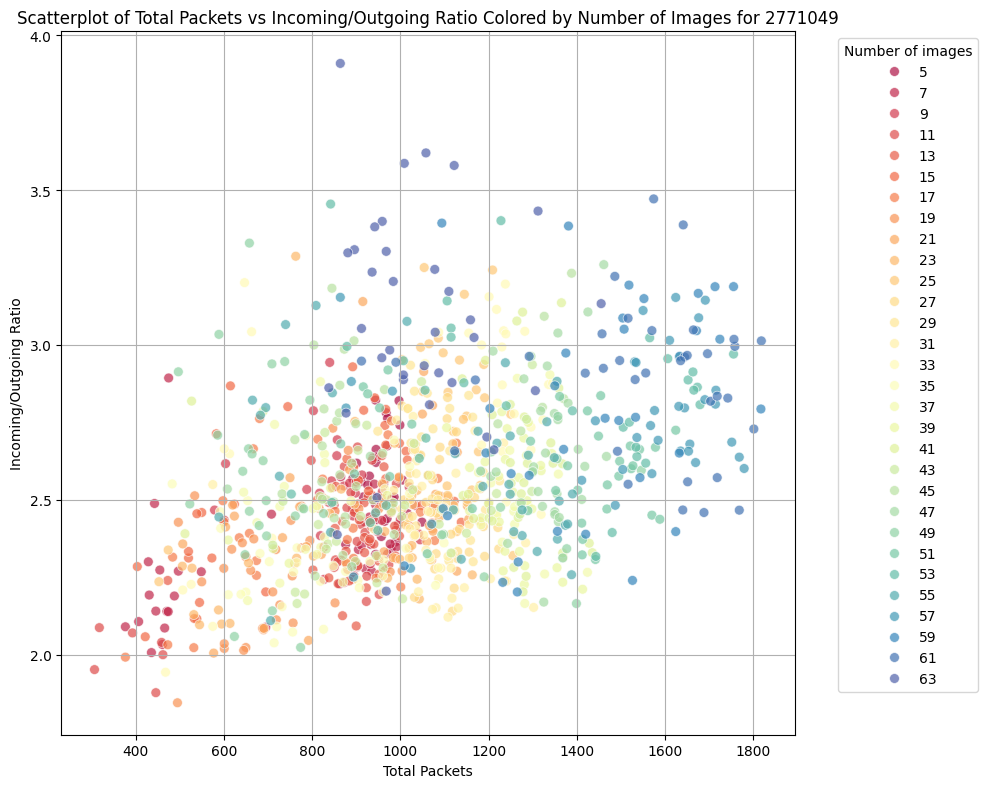

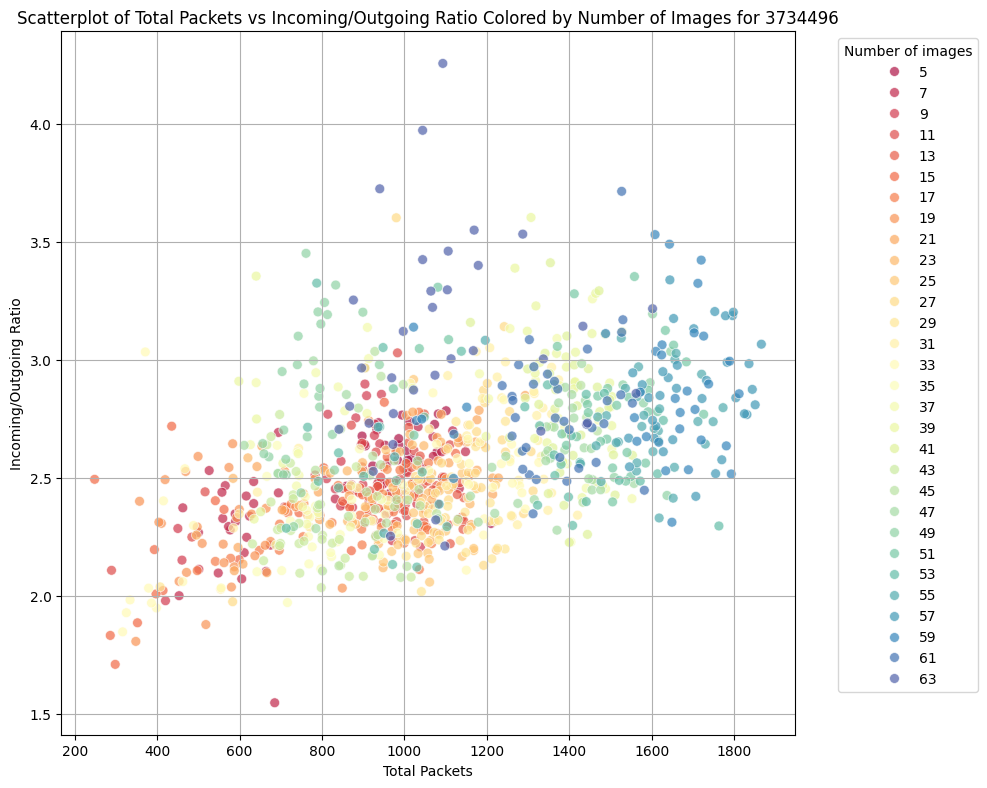

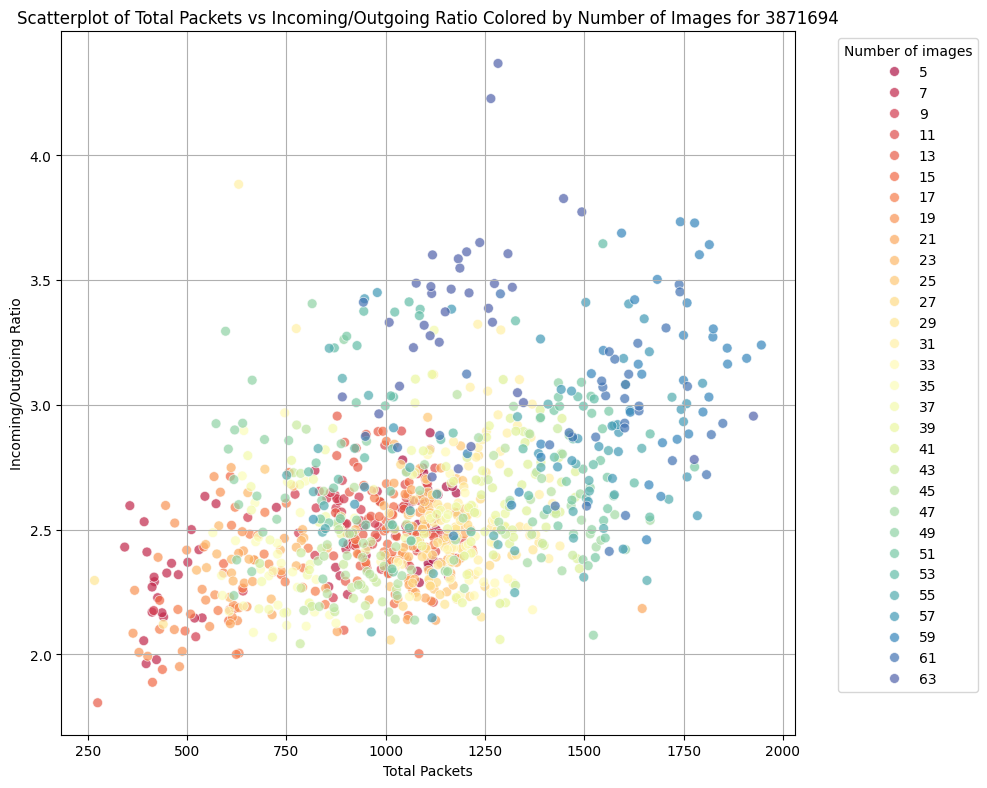

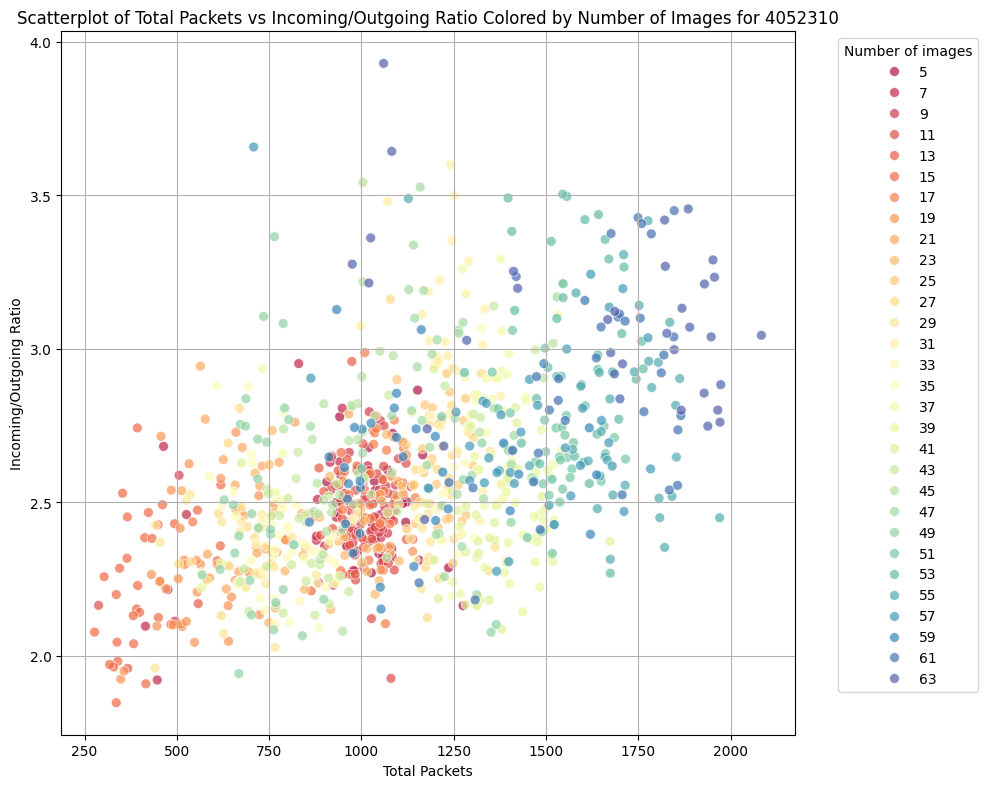

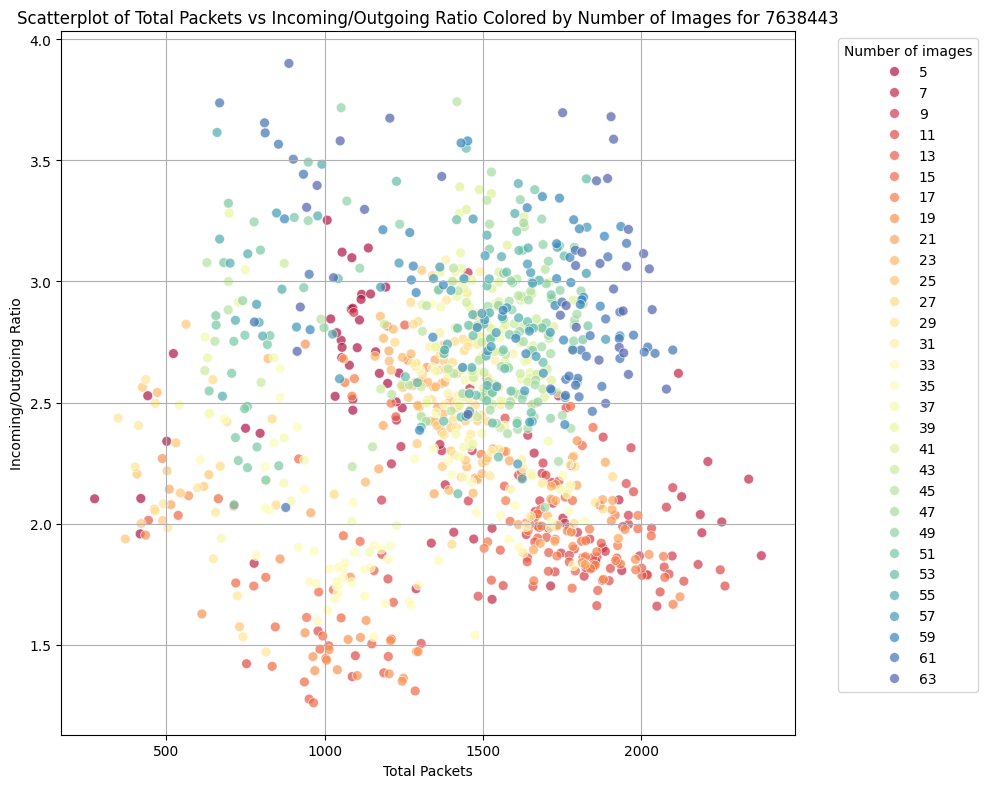

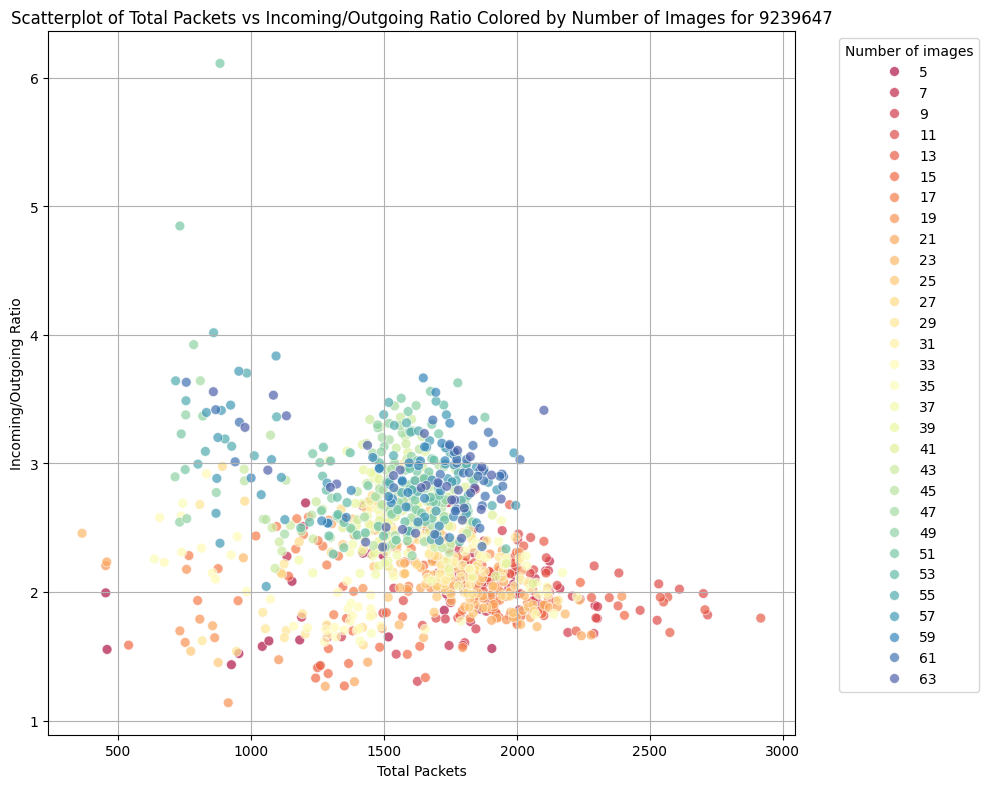

In [261]:
label_sizes = sorted(df['label_size'].unique())
for label_size in label_sizes:
    subset = df[df['label_size'] == label_size]
    X = subset[["total_packets", "incoming_outgoing_ratio"]]
    y = subset["label_imgs"]
        
    df_plot = X.copy()
    df_plot['label_imgs'] = y
    df_plot.sort_values(by='label_imgs', inplace=True)
    df_plot['label_imgs'] = df_plot['label_imgs'].astype(str)    
    
    plt.figure(figsize=(10, 8))
    sns.scatterplot(data=df_plot, x='total_packets', y='incoming_outgoing_ratio', hue='label_imgs', palette='Spectral', s=50, alpha=0.7)
    plt.title(f'Scatterplot of Total Packets vs Incoming/Outgoing Ratio Colored by Number of Images for {label_size}')
    plt.xlabel('Total Packets')
    plt.ylabel('Incoming/Outgoing Ratio')
    plt.legend(title='Number of images', bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.grid(True)
    plt.tight_layout()
    plt.show()    


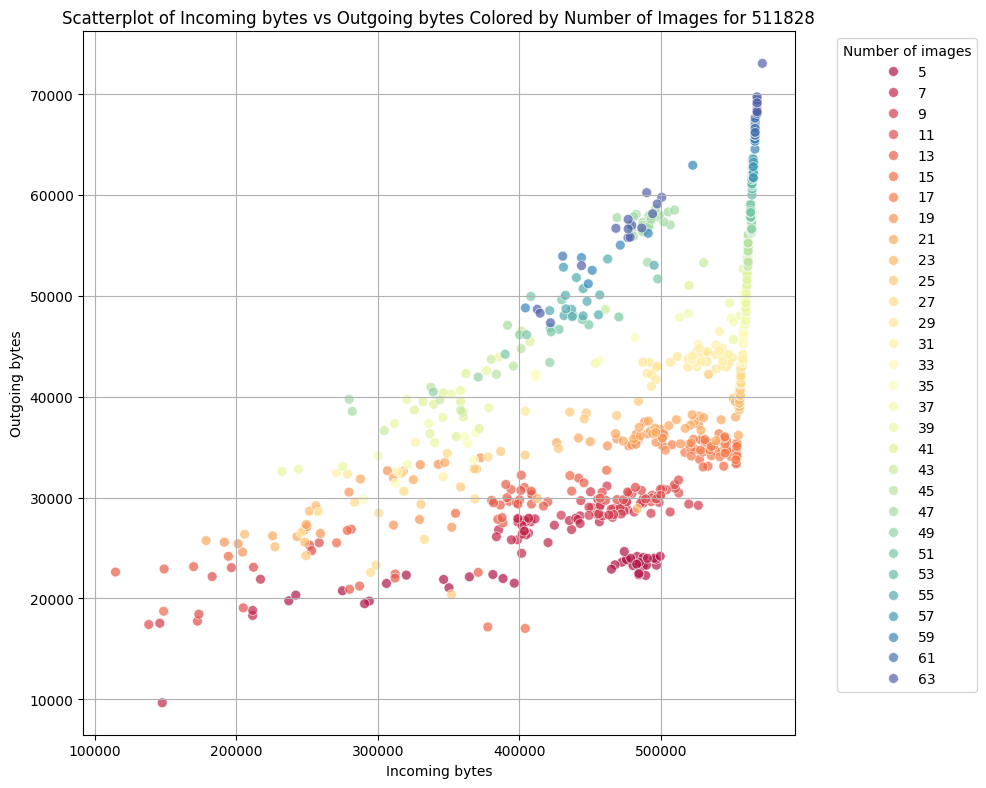

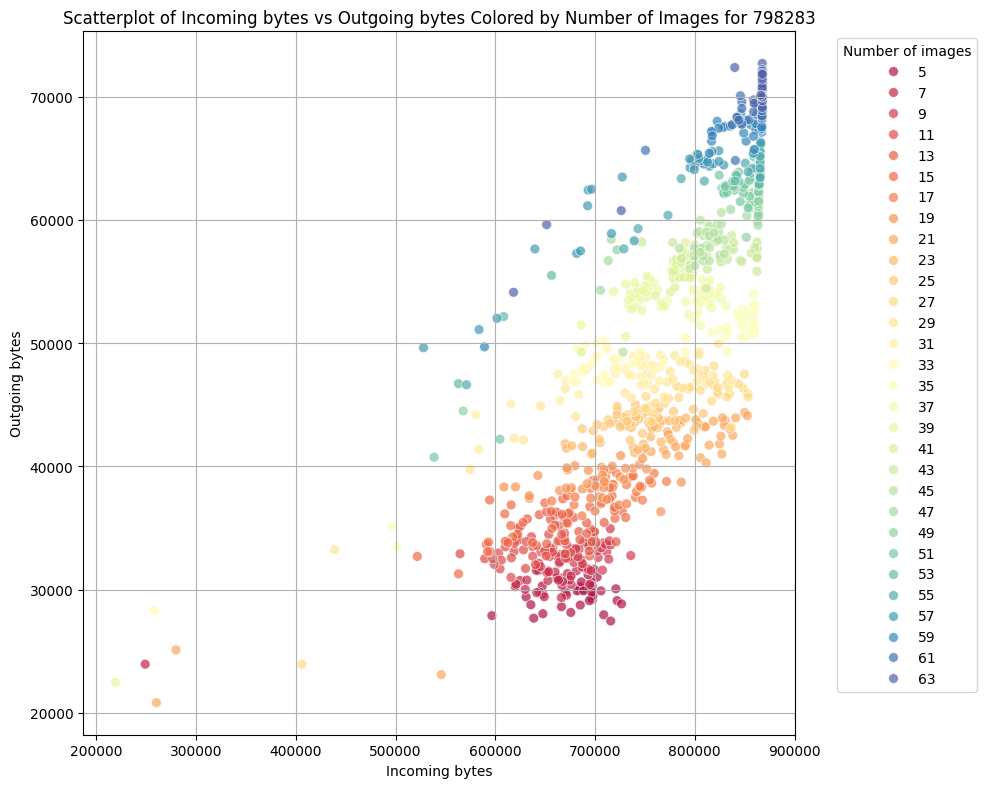

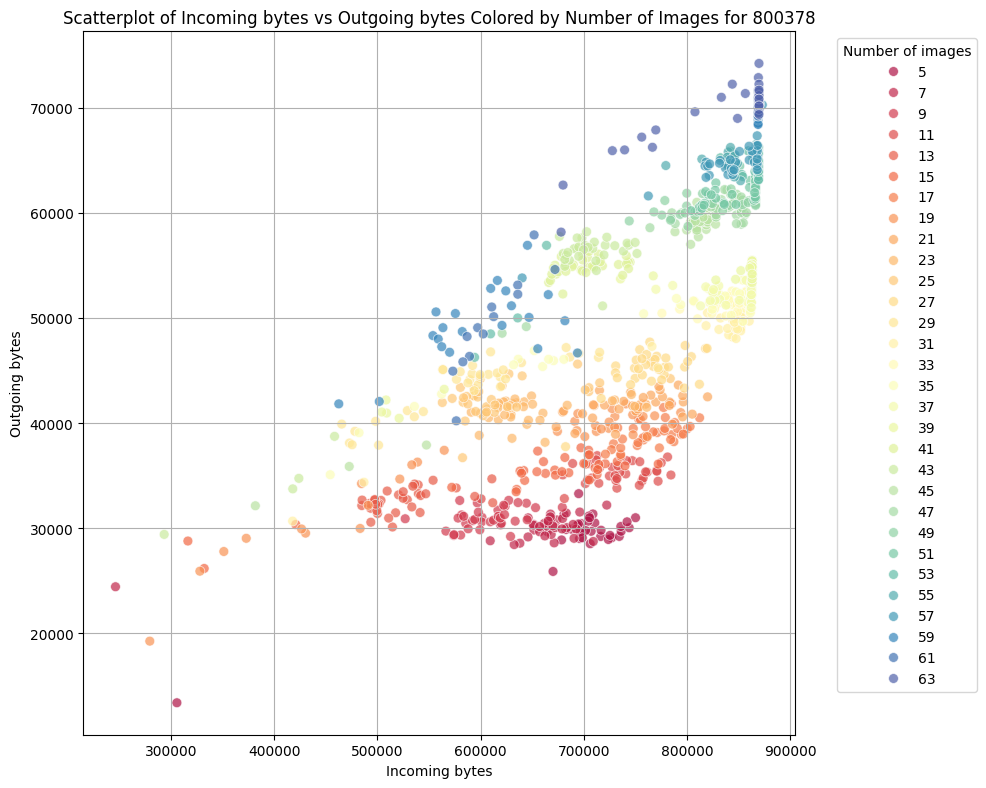

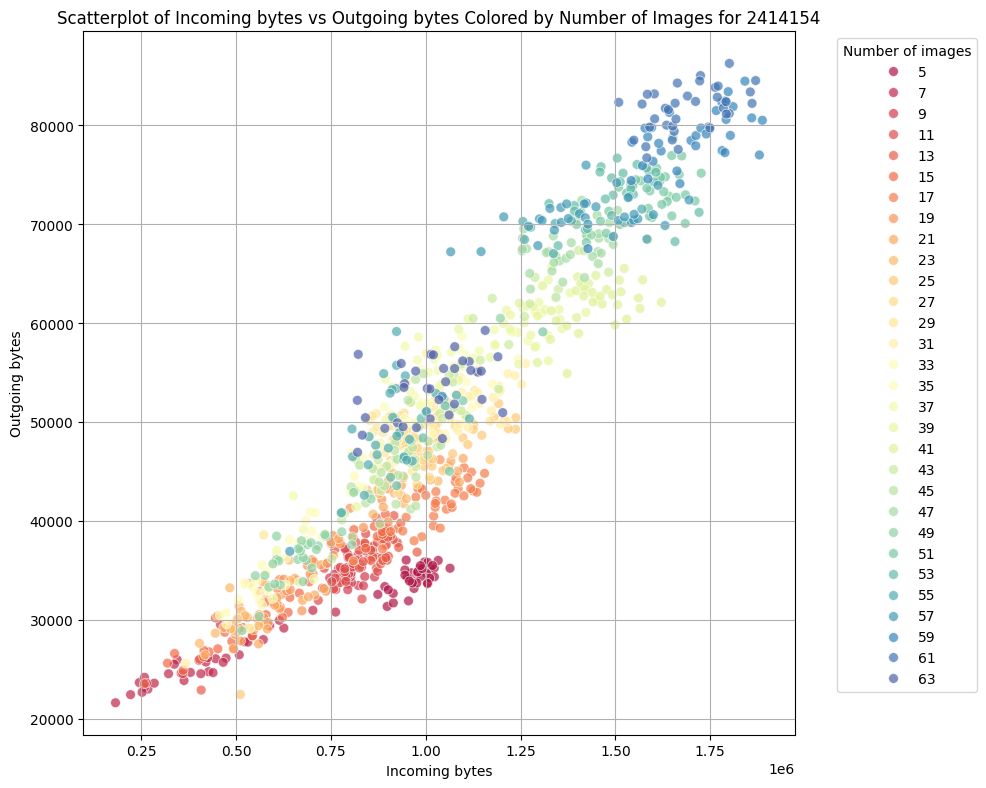

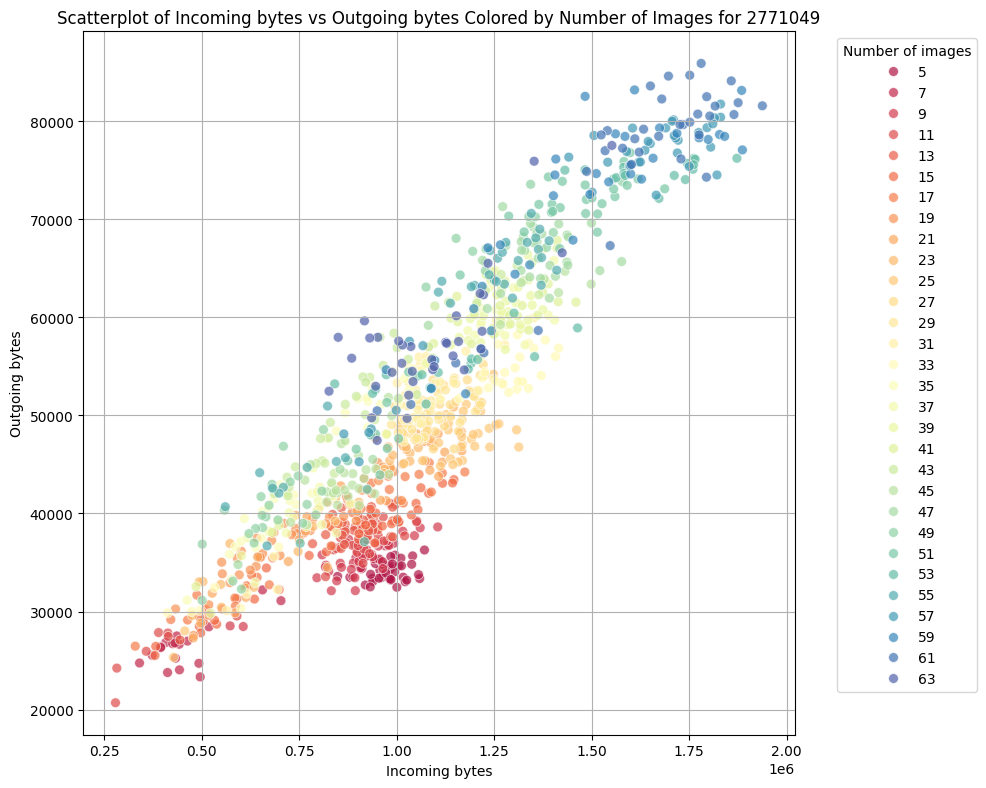

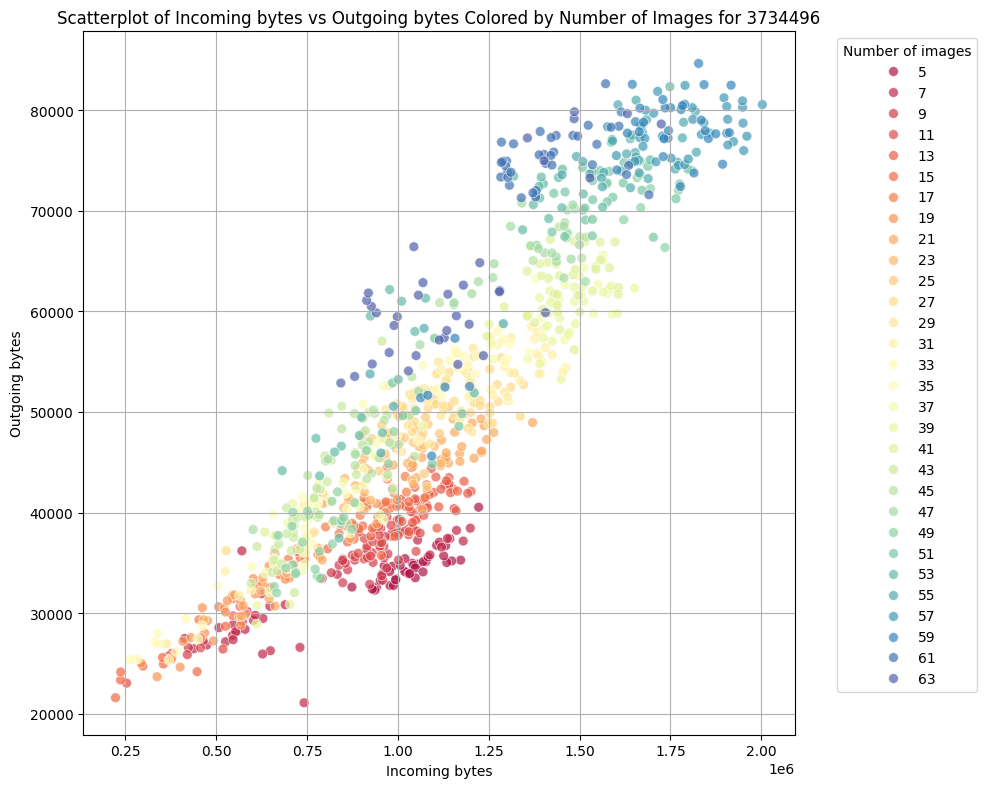

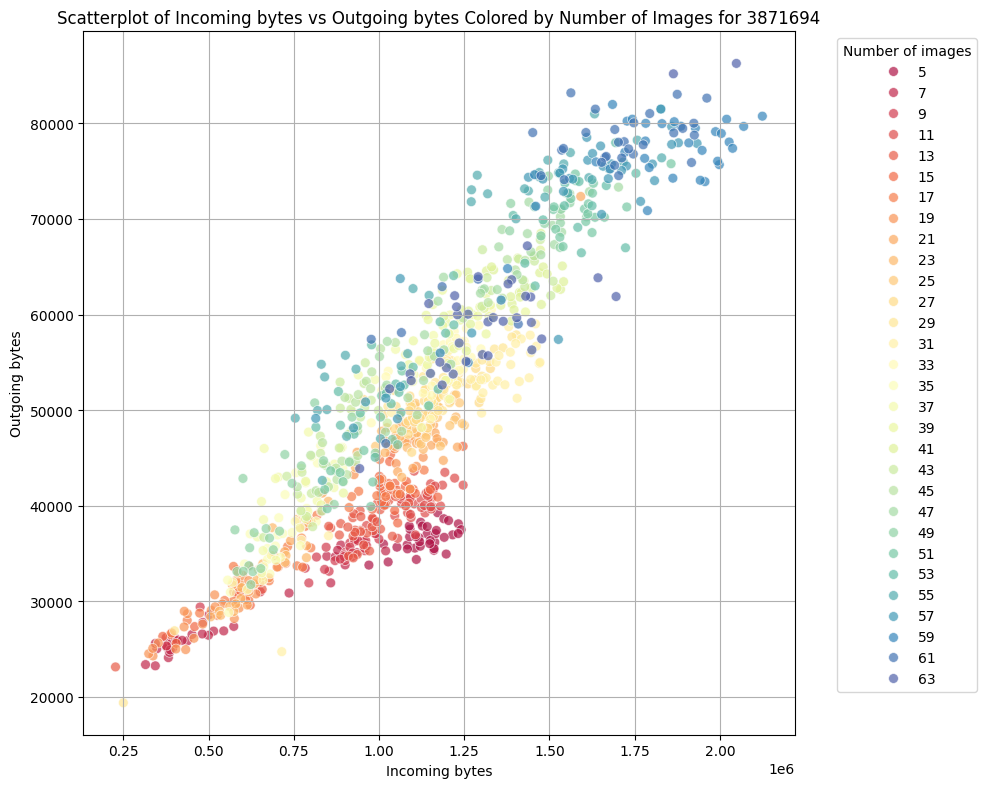

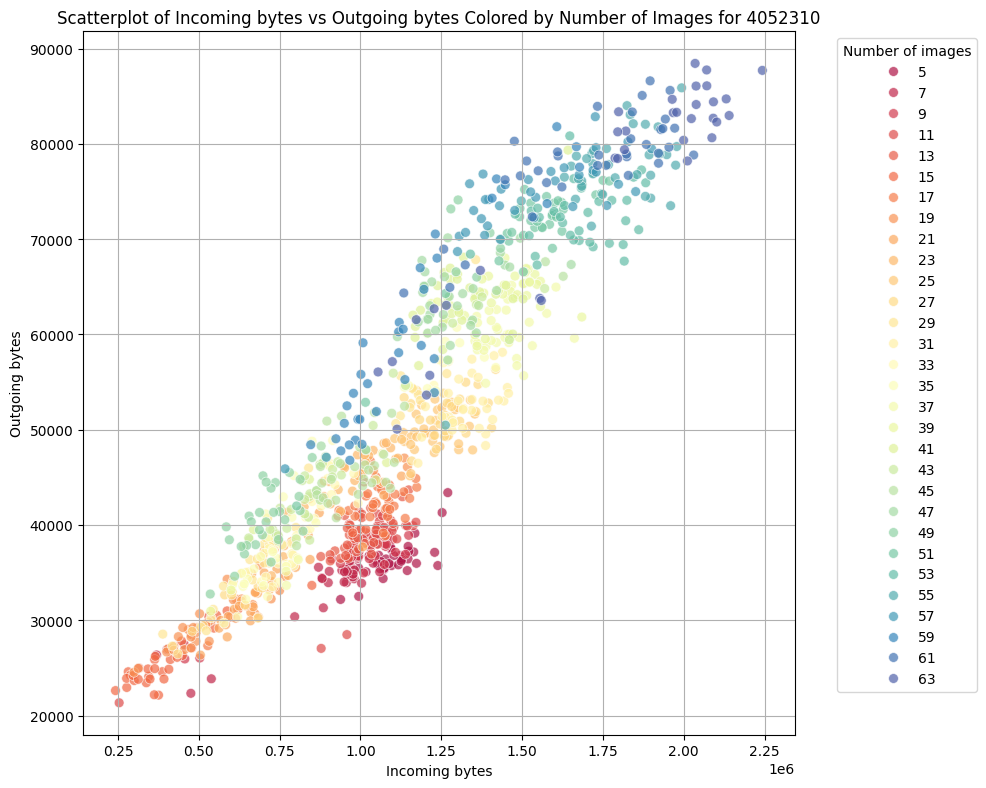

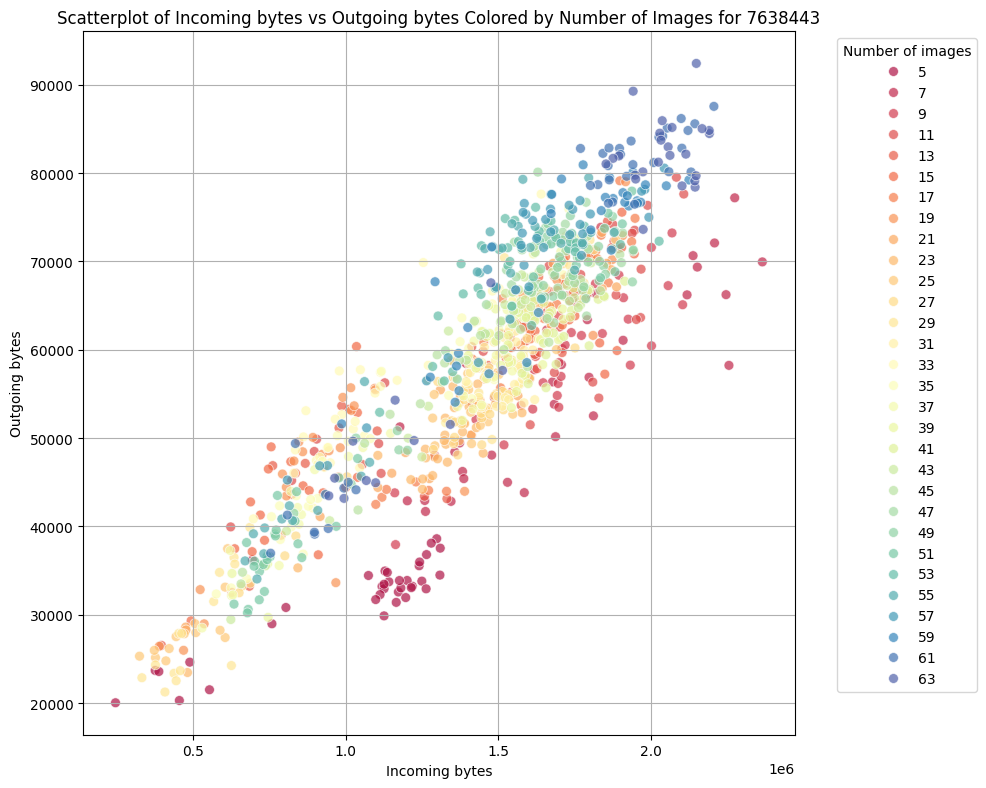

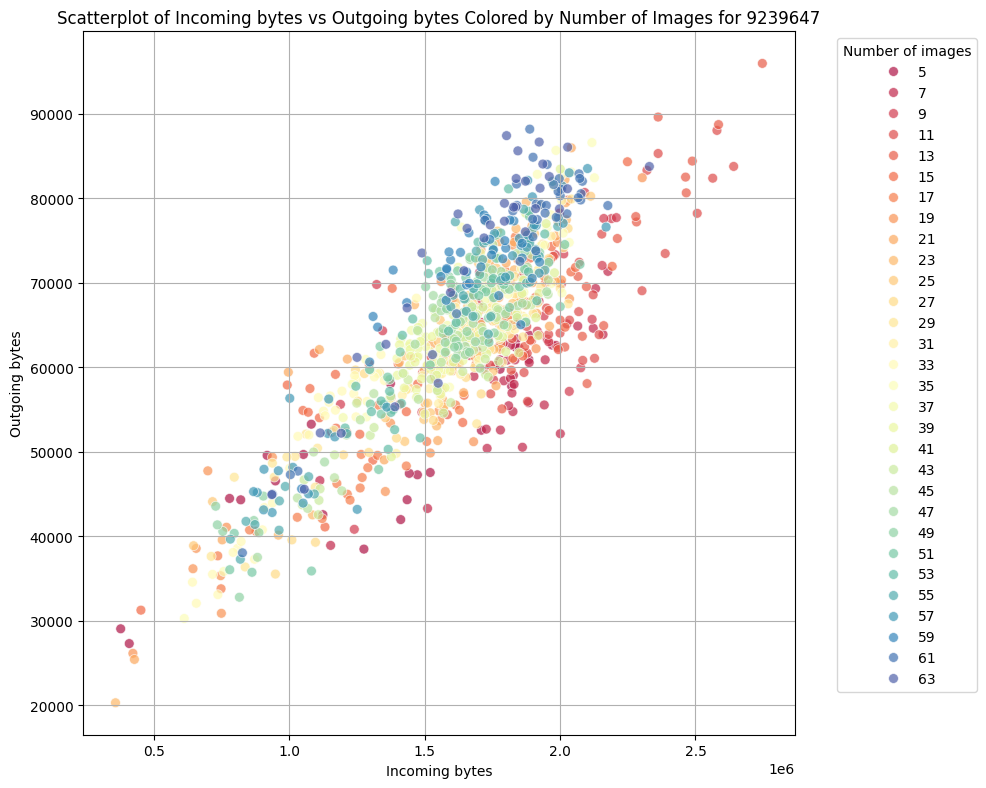

In [262]:
label_sizes = sorted(df['label_size'].unique())
for label_size in label_sizes:
    subset = df[df['label_size'] == label_size]
    X = subset[["incoming_bytes", "outgoing_bytes"]]
    y = subset["label_imgs"]
        
    df_plot = X.copy()
    df_plot['label_imgs'] = y
    df_plot.sort_values(by='label_imgs', inplace=True)
    df_plot['label_imgs'] = df_plot['label_imgs'].astype(str)    
    
    plt.figure(figsize=(10, 8))
    sns.scatterplot(data=df_plot, x='incoming_bytes', y='outgoing_bytes', hue='label_imgs', palette='Spectral', s=50, alpha=0.7)
    plt.title(f'Scatterplot of Incoming bytes vs Outgoing bytes Colored by Number of Images for {label_size}')
    plt.xlabel('Incoming bytes')
    plt.ylabel('Outgoing bytes')
    plt.legend(title='Number of images', bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.grid(True)
    plt.tight_layout()
    plt.show()    


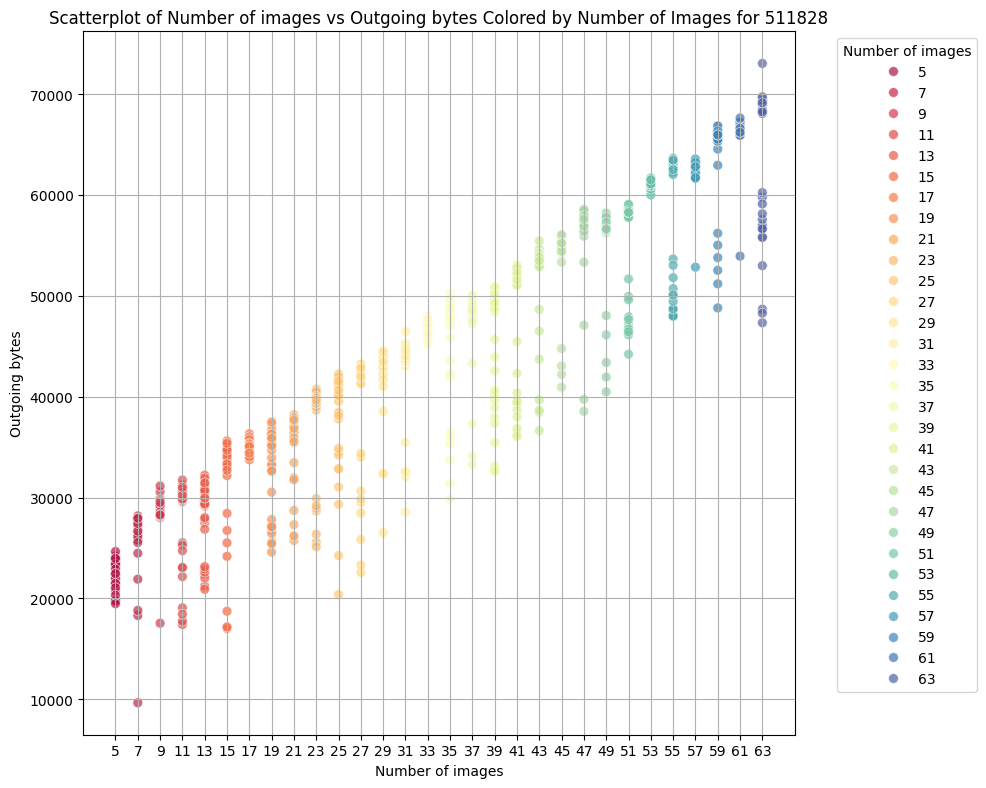

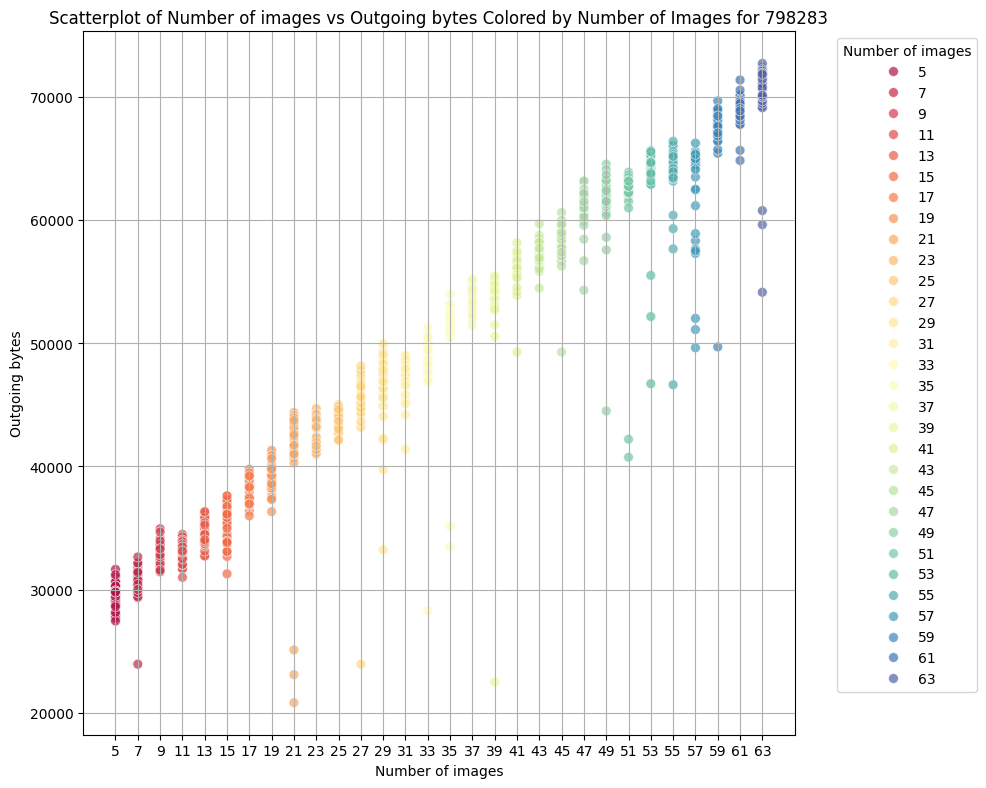

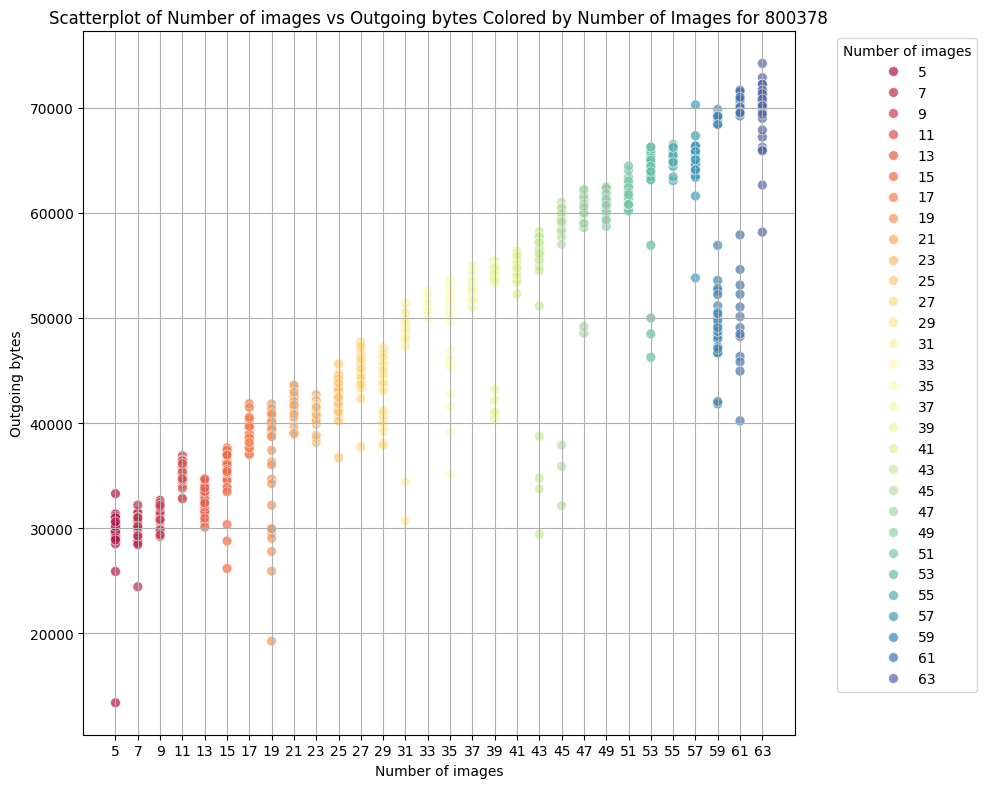

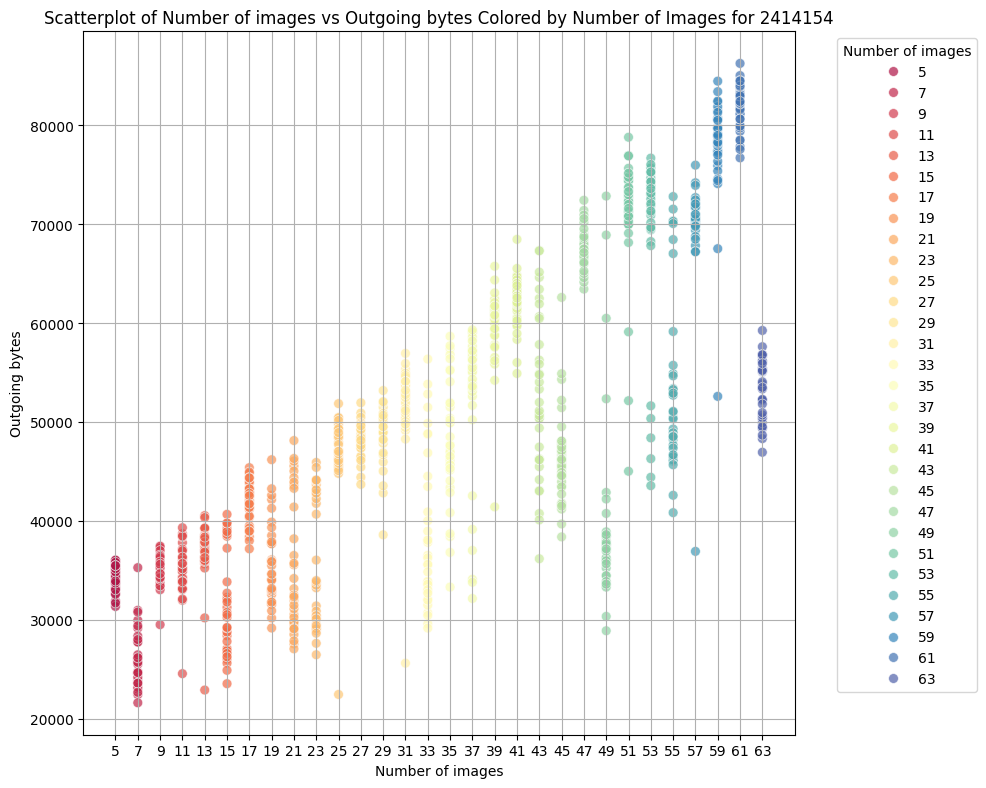

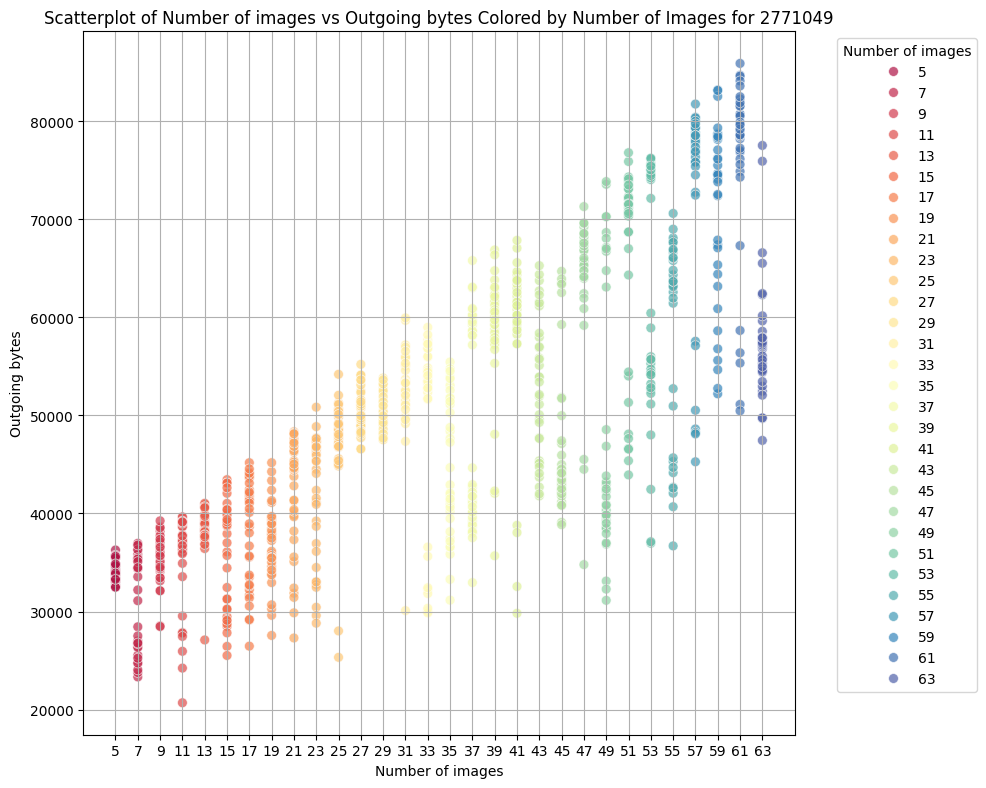

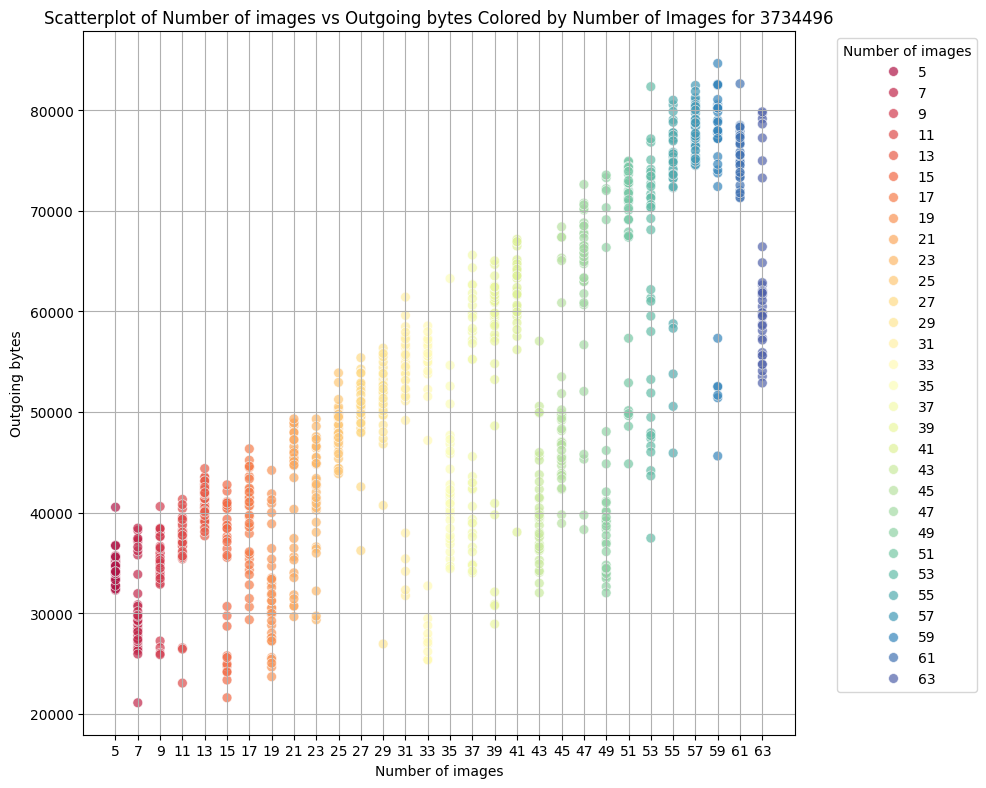

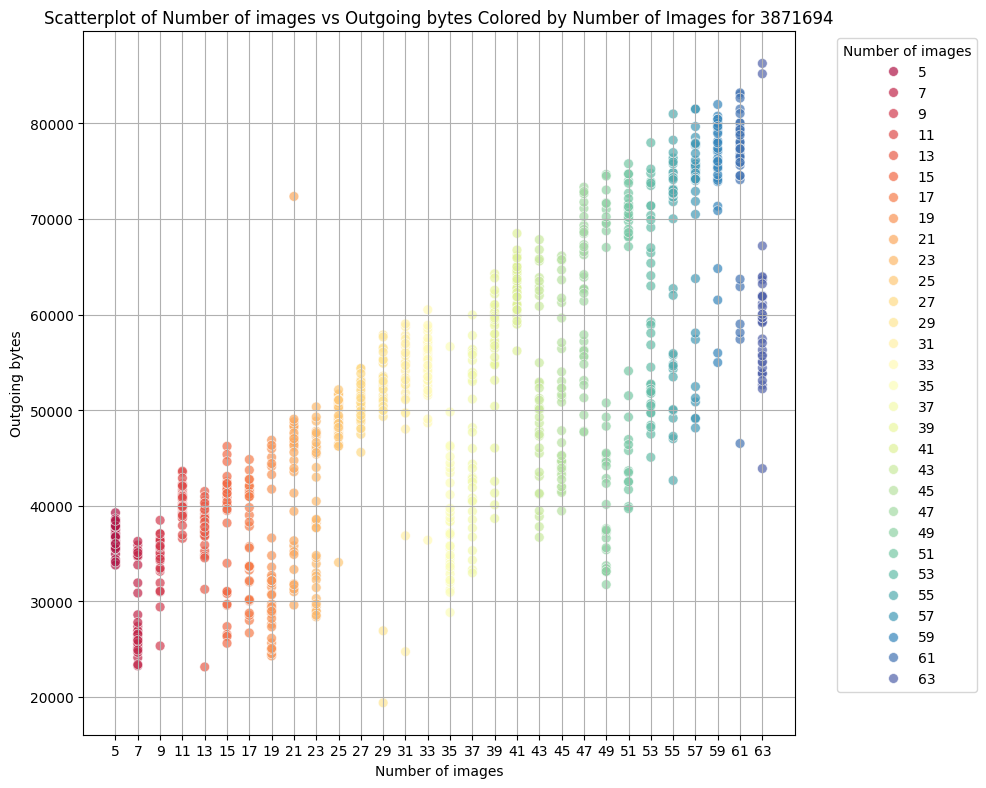

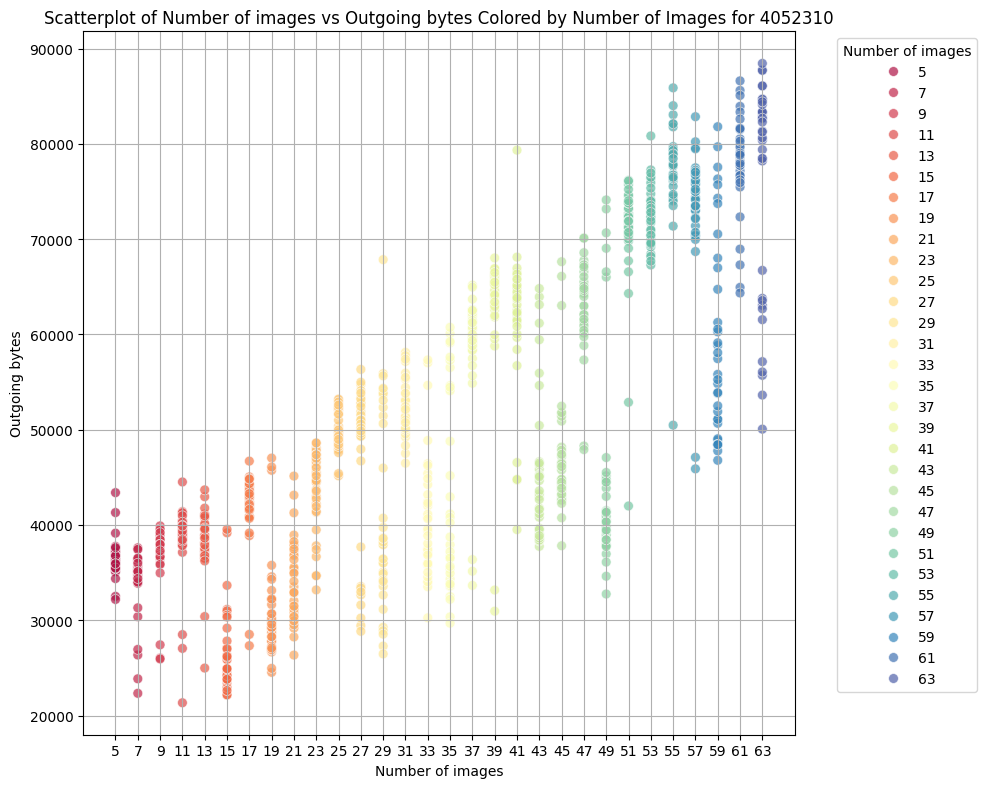

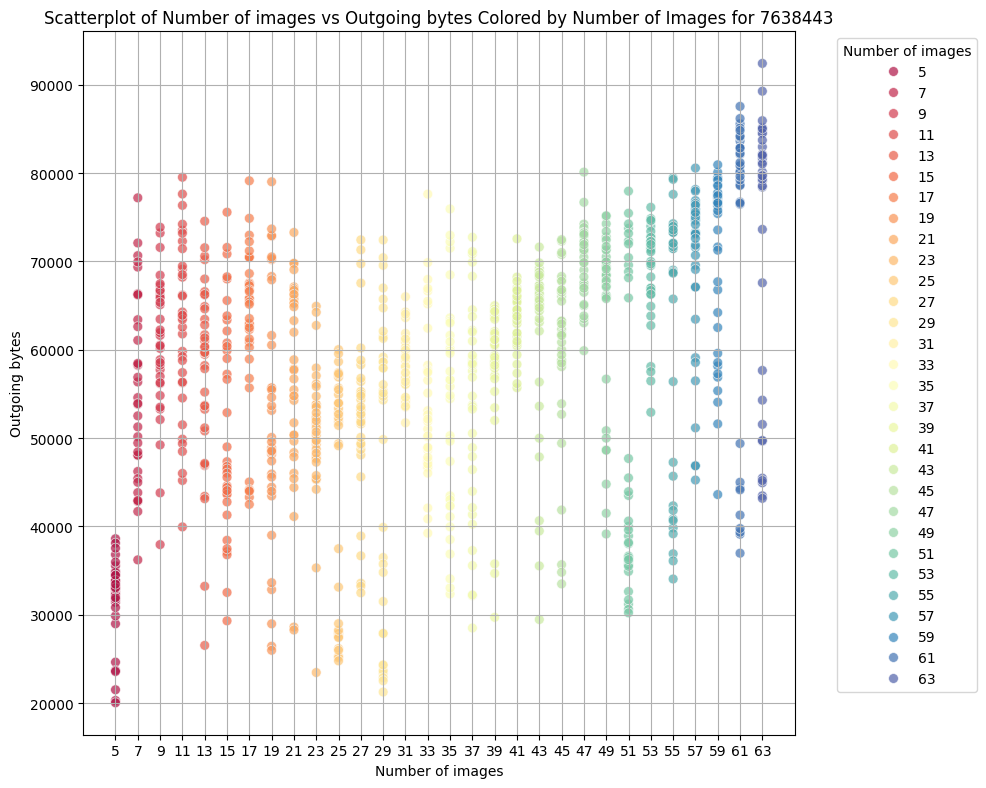

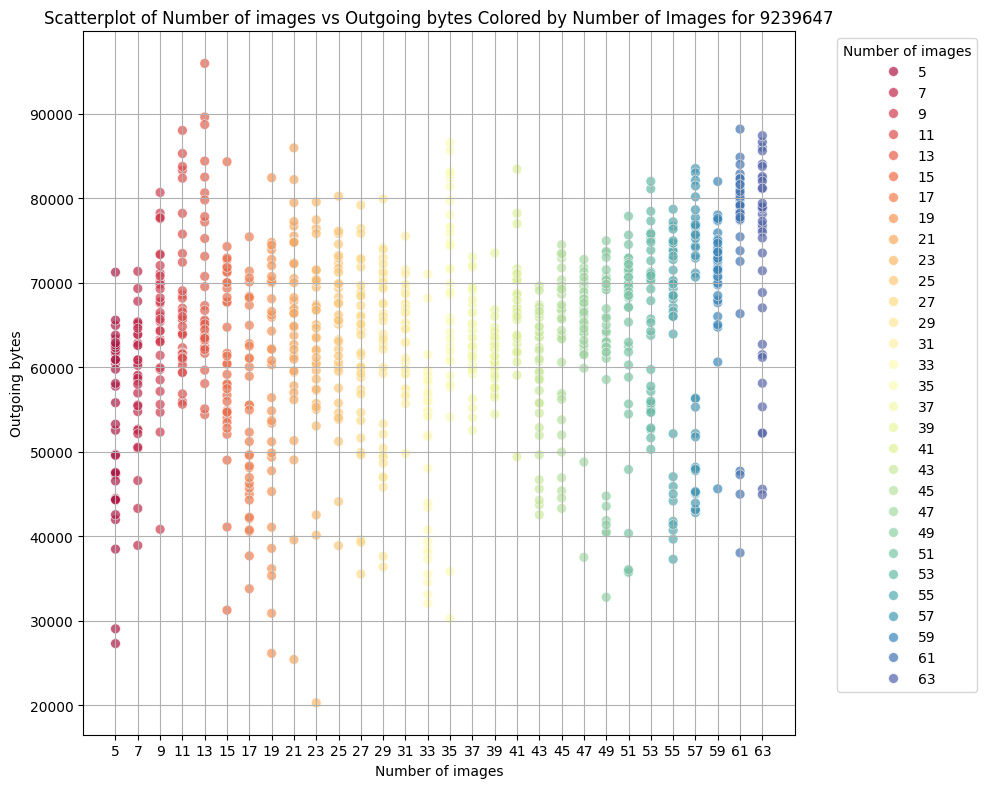

In [263]:
label_sizes = sorted(df['label_size'].unique())
for label_size in label_sizes:
    subset = df[df['label_size'] == label_size]
    X = subset[["label_imgs", "outgoing_bytes"]]
    y = subset["label_imgs"]
        
    df_plot = X.copy()
    df_plot['label_imgs'] = y
    df_plot.sort_values(by='label_imgs', inplace=True)
    df_plot['label_imgs'] = df_plot['label_imgs'].astype(str)    
    
    plt.figure(figsize=(10, 8))
    sns.scatterplot(data=df_plot, x='label_imgs', y='outgoing_bytes', hue='label_imgs', palette='Spectral', s=50, alpha=0.7)
    plt.title(f'Scatterplot of Number of images vs Outgoing bytes Colored by Number of Images for {label_size}')
    plt.xlabel('Number of images')
    plt.ylabel('Outgoing bytes')
    plt.legend(title='Number of images', bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.grid(True)
    plt.tight_layout()
    plt.show()    


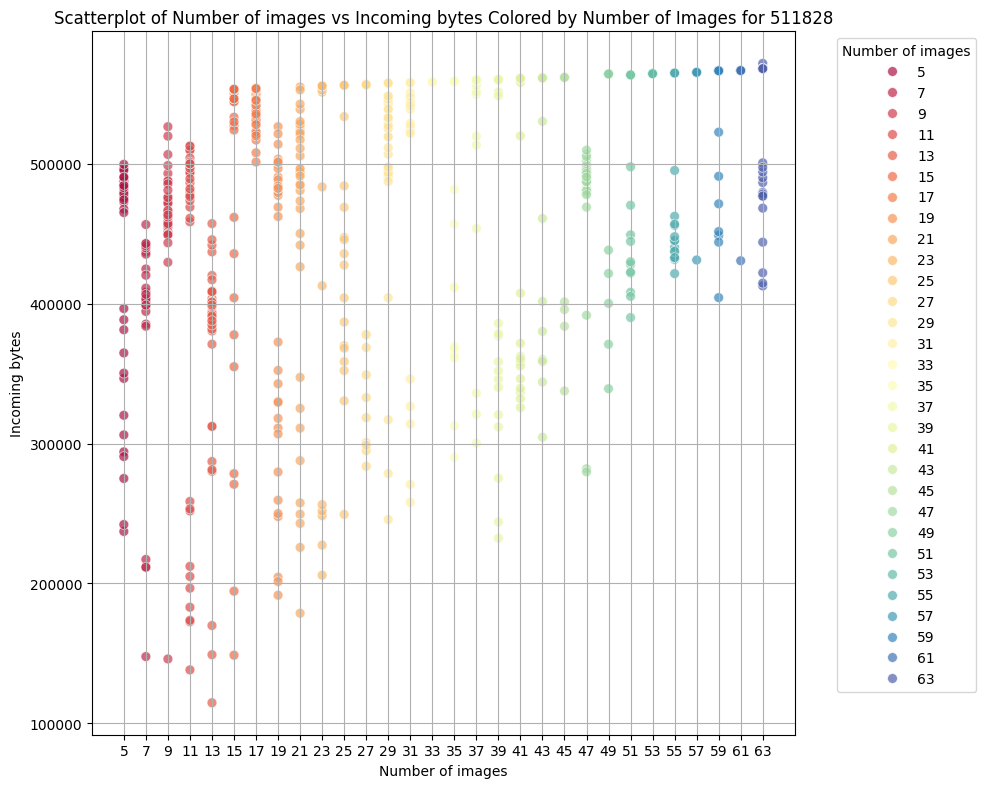

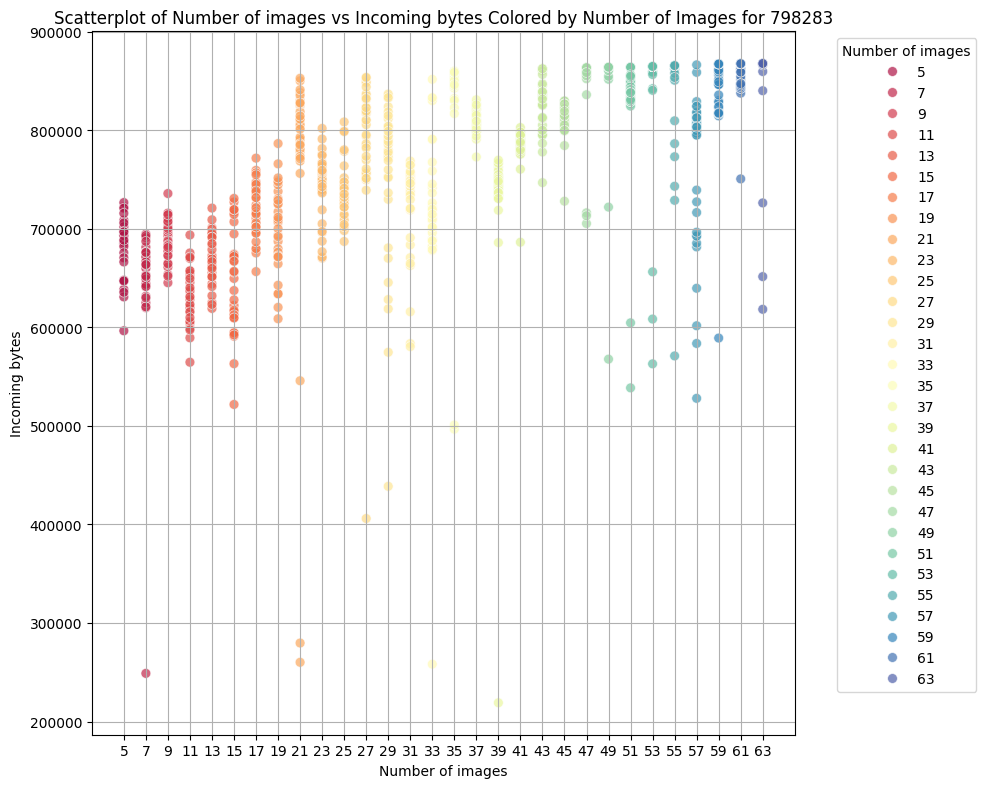

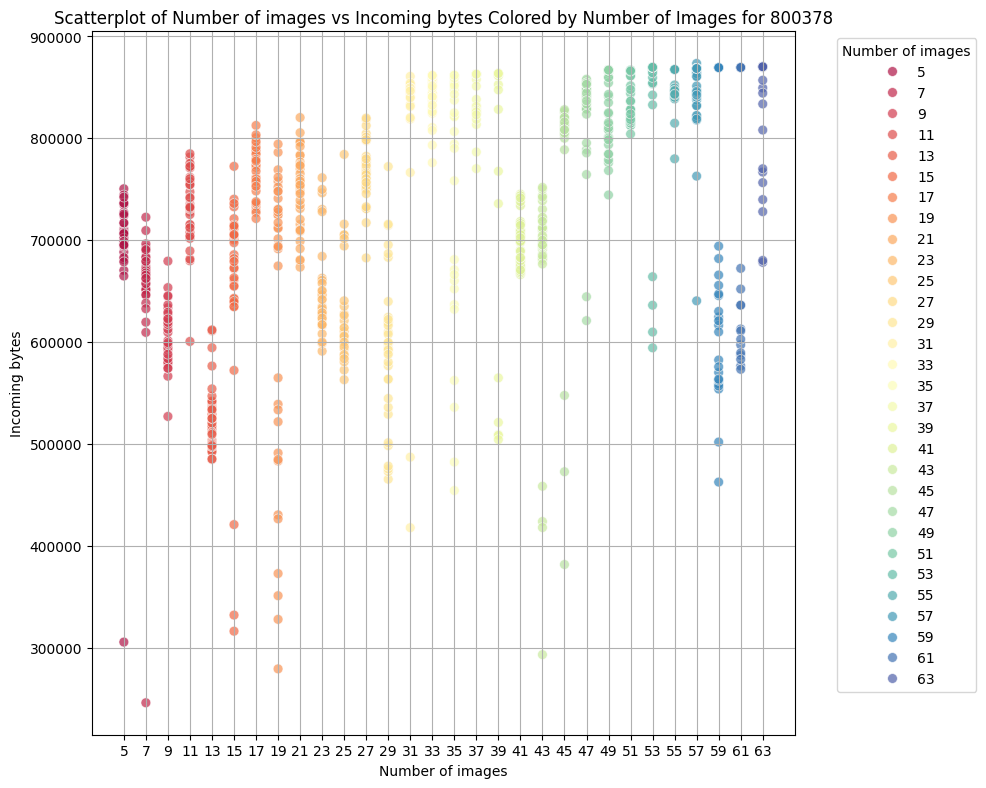

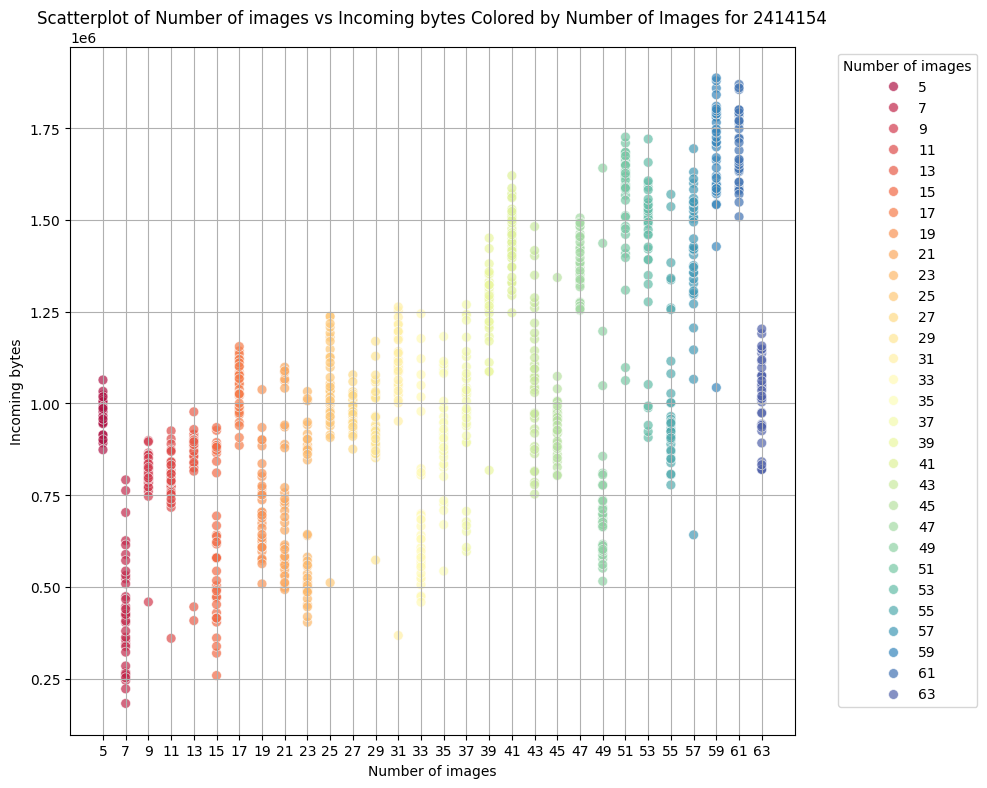

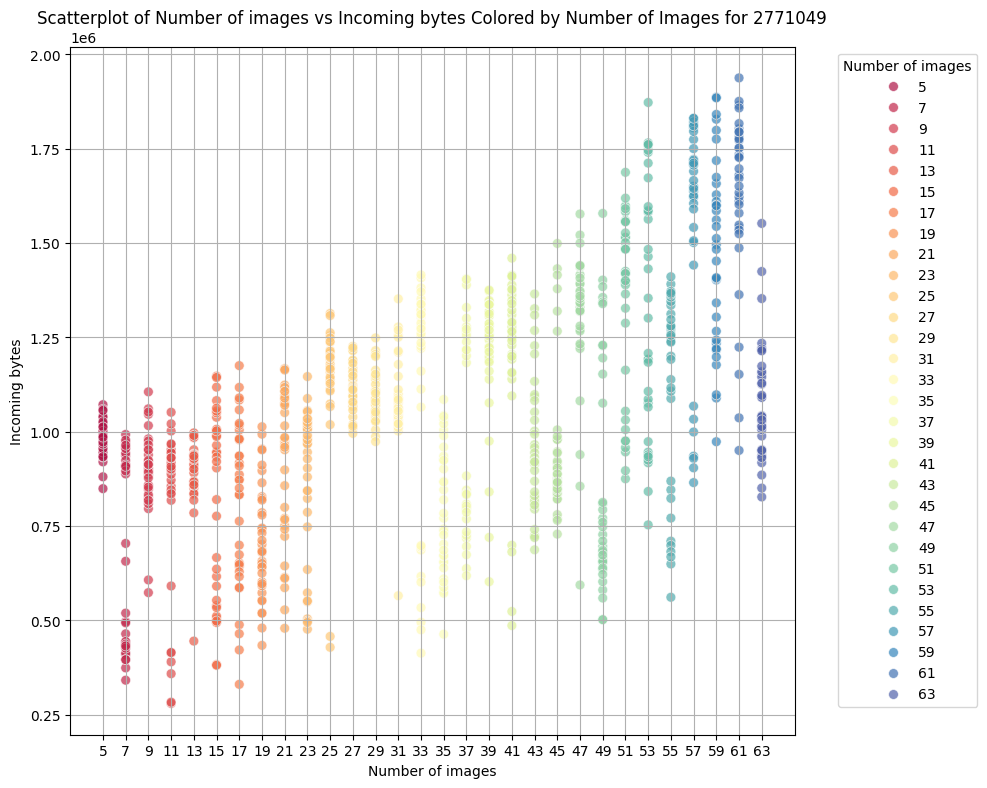

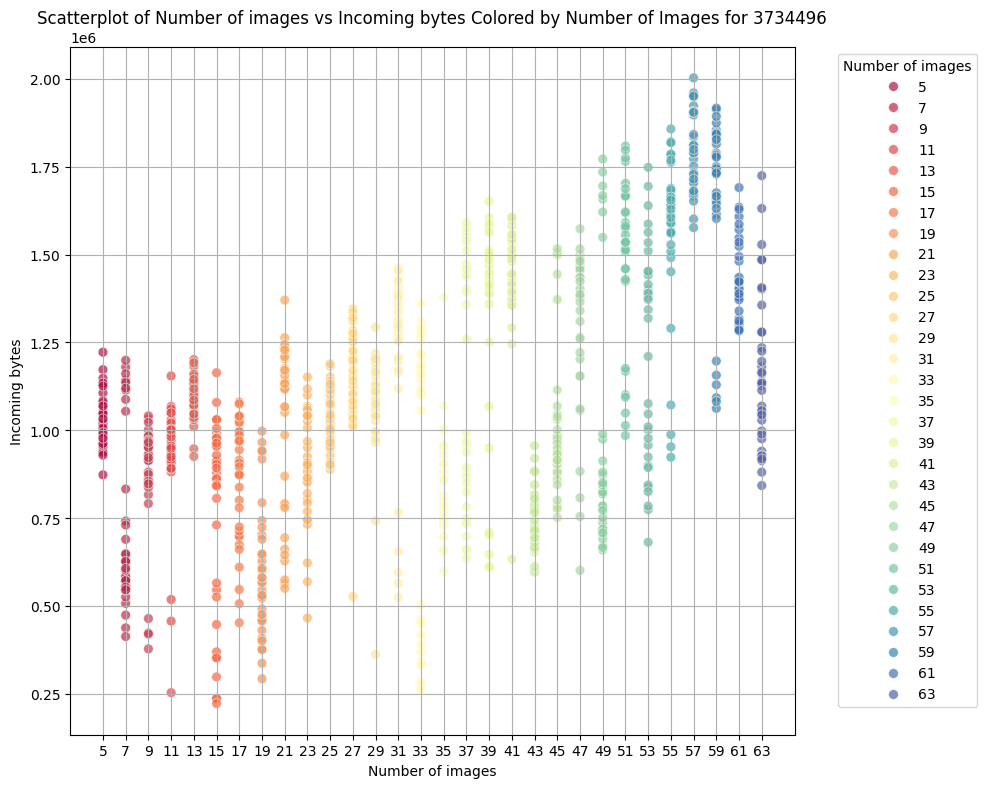

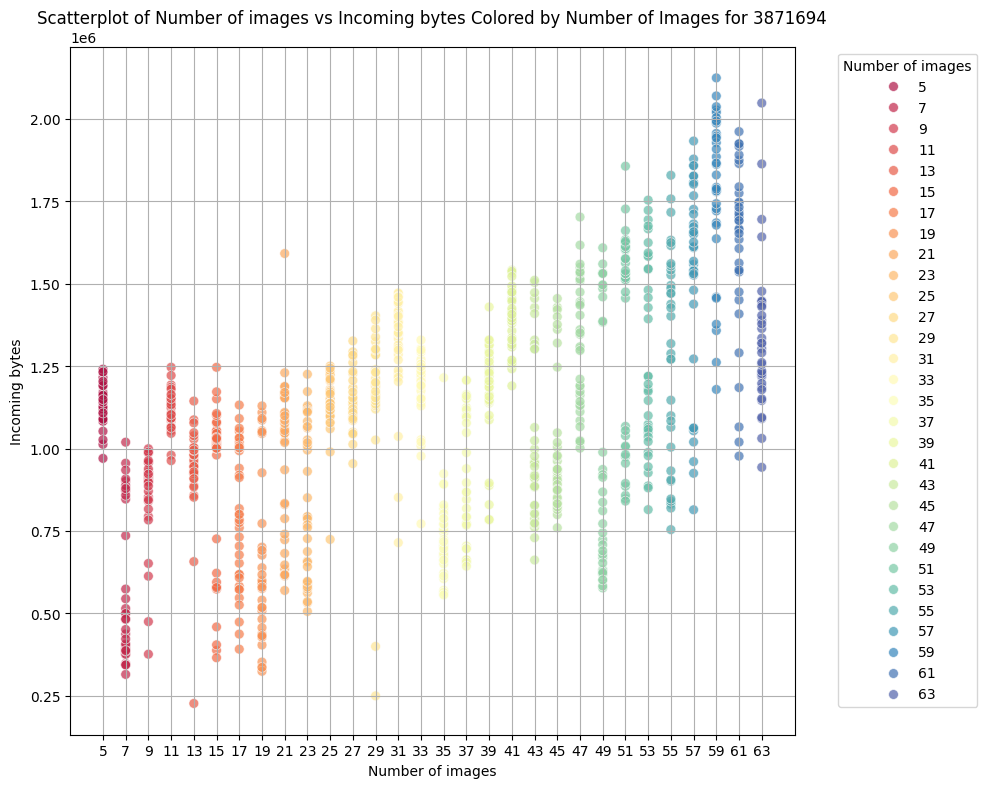

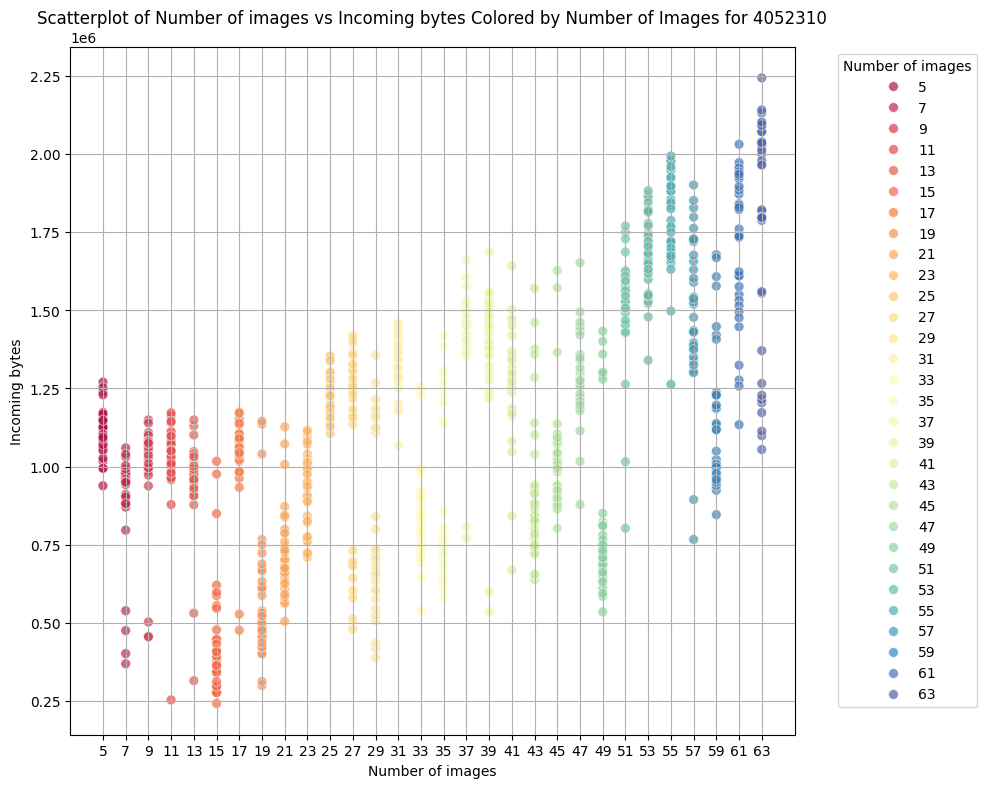

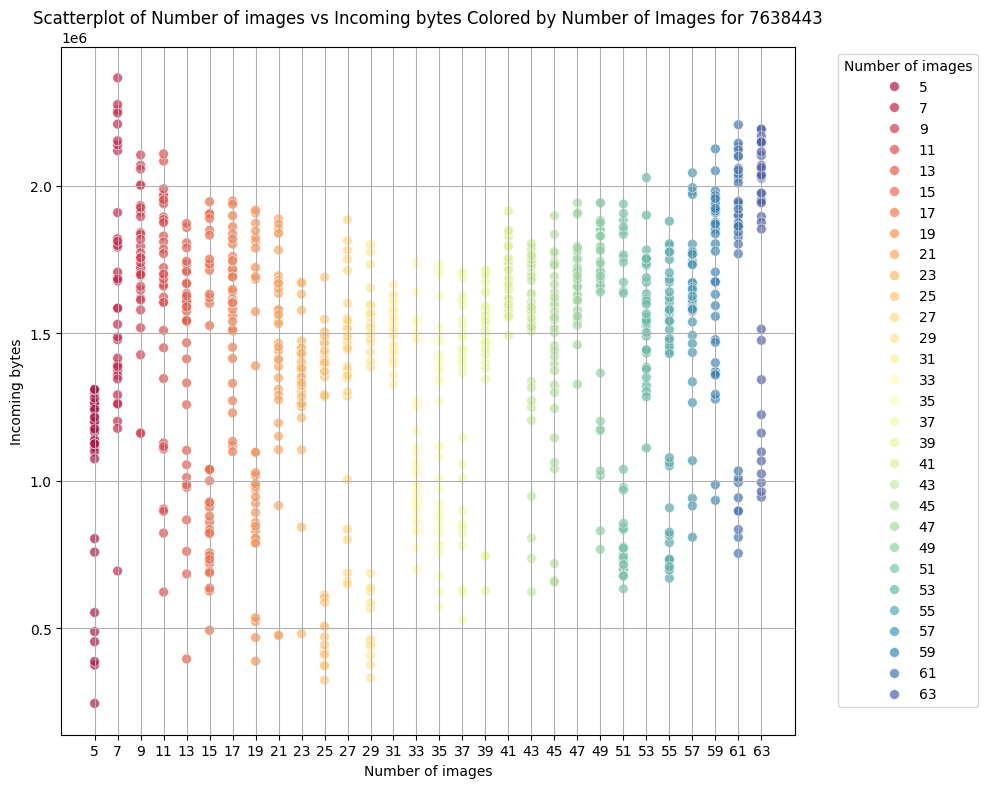

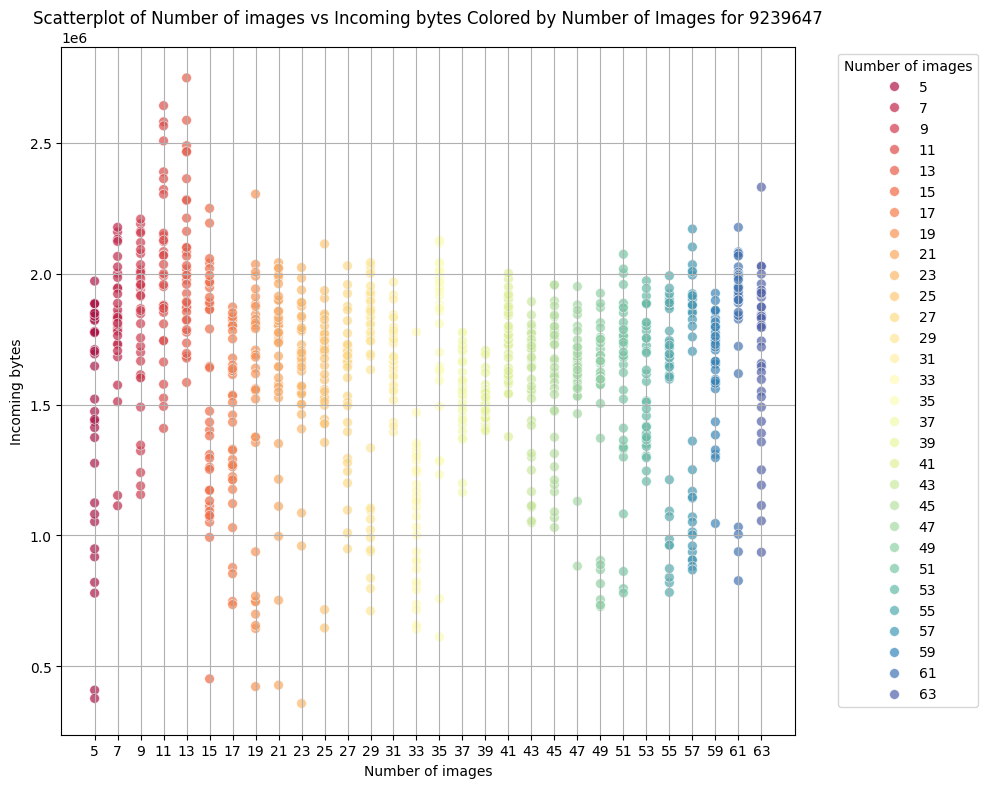

In [264]:
label_sizes = sorted(df['label_size'].unique())
for label_size in label_sizes:
    subset = df[df['label_size'] == label_size]
    X = subset[["label_imgs", "incoming_bytes"]]
    y = subset["label_imgs"]
        
    df_plot = X.copy()
    df_plot['label_imgs'] = y
    df_plot.sort_values(by='label_imgs', inplace=True)
    df_plot['label_imgs'] = df_plot['label_imgs'].astype(str)    
    
    plt.figure(figsize=(10, 8))
    sns.scatterplot(data=df_plot, x='label_imgs', y='incoming_bytes', hue='label_imgs', palette='Spectral', s=50, alpha=0.7)
    plt.title(f'Scatterplot of Number of images vs Incoming bytes Colored by Number of Images for {label_size}')
    plt.xlabel('Number of images')
    plt.ylabel('Incoming bytes')
    plt.legend(title='Number of images', bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.grid(True)
    plt.tight_layout()
    plt.show()    


### Señales y representaciones de la traza

In [265]:
def cumul(packet_features):
    cumul = []
    for i in range(0, len(packet_features)):
        cumul.append(packet_features[i][1] * packet_features[i][0] + (cumul[i-1] if i > 0 else 0))
    return cumul

def signal(packet_features):
    signal = []
    for i in range(0, len(packet_features)):
        signal.append(packet_features[i][1] * packet_features[i][0])
    return signal

def signal_direction(packet_features):
    signal = []
    for i in range(0, len(packet_features)):
        signal.append(packet_features[i][0])
    return signal

In [266]:
df['signal'] = df['packet_features'].apply(lambda x: signal(x))
df['cumul'] = df['packet_features'].apply(lambda x: cumul(x))
df["signal_direction"] = df["packet_features"].apply(lambda x: signal_direction(x))

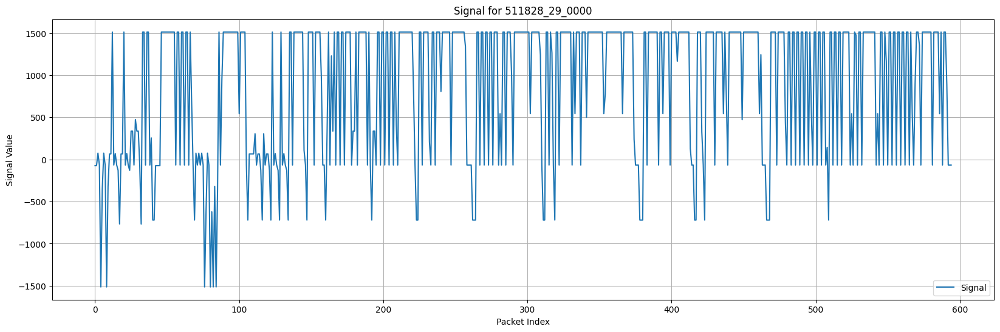

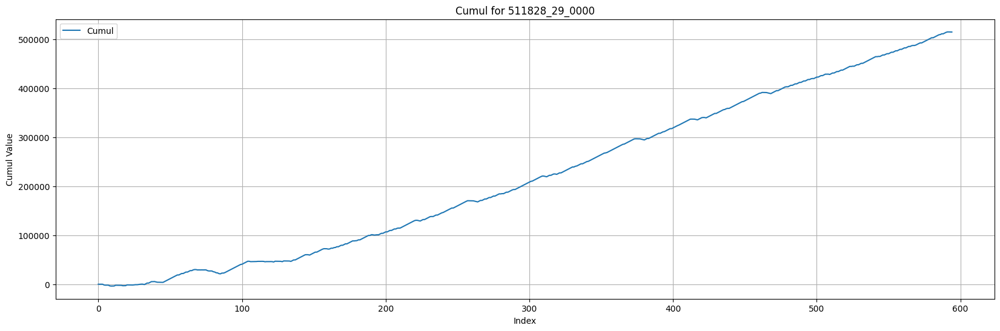

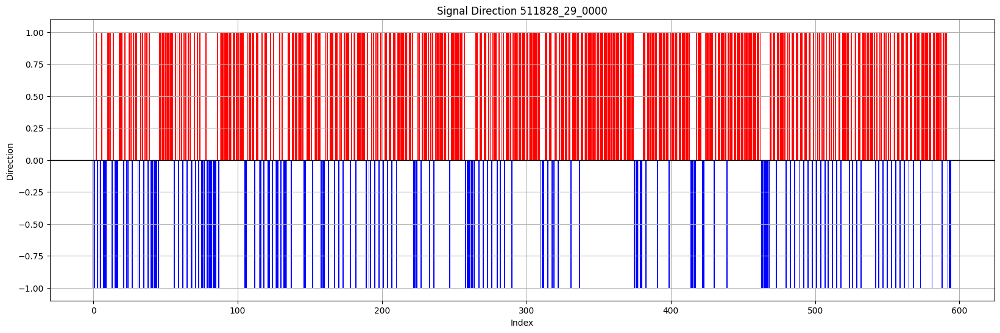

In [267]:
import random
random.seed(102)
random_index = random.randint(0, len(df) - 1)
random_row = df.iloc[random_index]

plt.figure(figsize=(20, 6))
plt.plot(random_row['signal'], label='Signal')
plt.title(f'Signal for {random_row["label"]}')
plt.xlabel('Packet Index')
plt.ylabel('Signal Value')
plt.legend()
plt.grid(True)
plt.show()

plt.figure(figsize=(20, 6))
plt.plot(random_row['cumul'], label='Cumul')
plt.title(f'Cumul for {random_row["label"]}')
plt.xlabel('Index')
plt.ylabel('Cumul Value')
plt.legend()
plt.grid(True)
plt.show()

sig = np.array(random_row["signal_direction"])
x = np.arange(len(sig))

colors = ['red' if val > 0 else 'blue' for val in sig]

plt.figure(figsize=(20, 6))
plt.bar(x, sig, width=0.8, color=colors)
plt.axhline(0, color='black', linewidth=1)
plt.title(f'Signal Direction {random_row['label']}')
plt.xlabel('Index')
plt.ylabel('Direction')
plt.grid(True)
plt.show()


In [268]:
def interpolate_cumul(cumul, target_length=100):
    if len(cumul) < 2:
        return np.zeros(target_length).tolist()
    original_indices = np.linspace(0, len(cumul) - 1, len(cumul))
    target_indices = np.linspace(0, len(cumul) - 1, target_length)
    cumul_interpolado = np.interp(target_indices, original_indices, cumul)
    cumul_interpolado = np.rint(cumul_interpolado).astype(int)

    return cumul_interpolado.tolist()

In [269]:
df["cumul_interpolated"] = df["cumul"].apply(lambda x: interpolate_cumul(x, target_length=100))

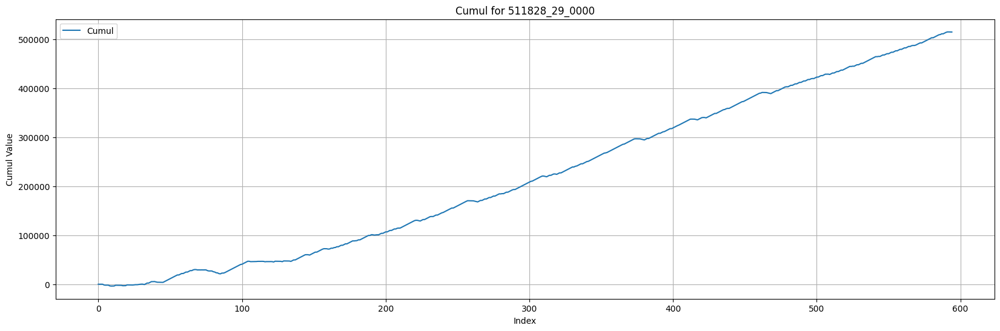

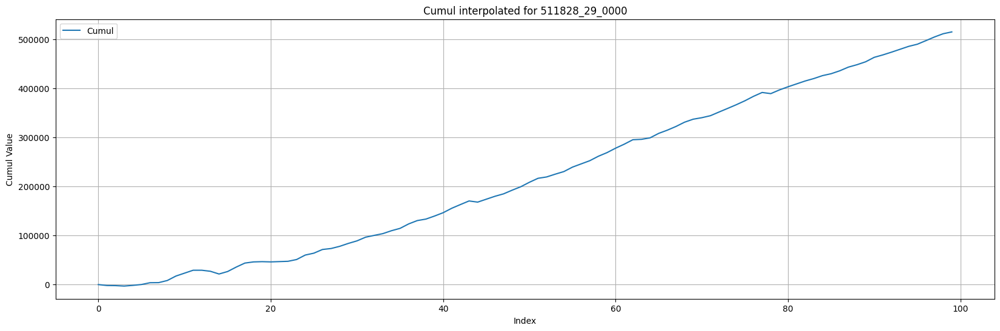

In [270]:
import random
random.seed(102)
random_index = random.randint(0, len(df) - 1)
random_row = df.iloc[random_index]

plt.figure(figsize=(20, 6))
plt.plot(random_row['cumul'], label='Cumul')
plt.title(f'Cumul for {random_row["label"]}')
plt.xlabel('Index')
plt.ylabel('Cumul Value')
plt.legend()
plt.grid(True)
plt.show()

plt.figure(figsize=(20, 6))
plt.plot(random_row['cumul_interpolated'], label='Cumul')
plt.title(f'Cumul interpolated for {random_row["label"]}')
plt.xlabel('Index')
plt.ylabel('Cumul Value')
plt.legend()
plt.grid(True)
plt.show()

### Wavelets

In [271]:
import pywt

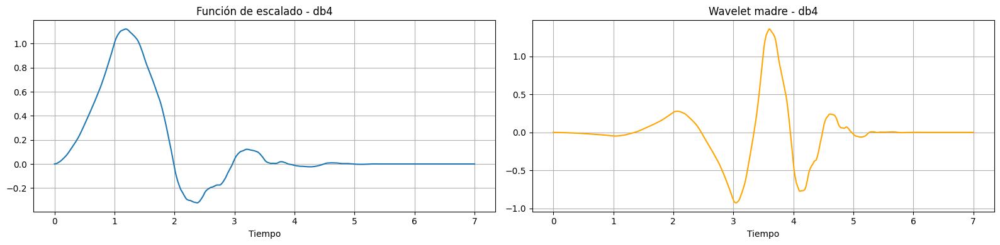

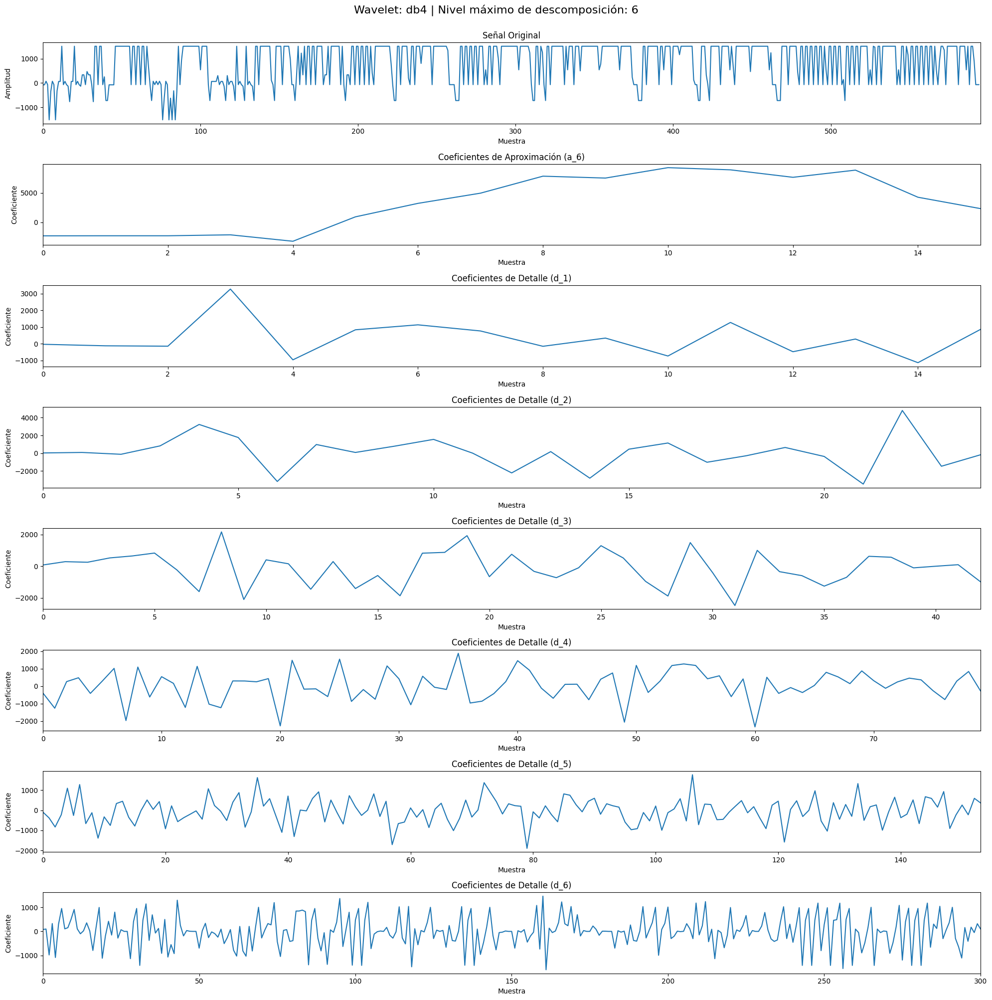

In [272]:
wavelet_name = 'db4'
wavelet = pywt.Wavelet(wavelet_name)

phi, psi, x = wavelet.wavefun(level=10)

plt.figure(figsize=(16, 4))

plt.subplot(1, 2, 1)
plt.plot(x, phi, label='φ (función de escalado)')
plt.title(f'Función de escalado - {wavelet_name}')
plt.xlabel('Tiempo')
plt.grid(True)

plt.subplot(1, 2, 2)
plt.plot(x, psi, label='ψ (wavelet)', color='orange')
plt.title(f'Wavelet madre - {wavelet_name}')
plt.xlabel('Tiempo')
plt.grid(True)
plt.tight_layout()
plt.show()

signal_values = random_row['signal']
max_level = pywt.dwt_max_level(len(signal_values), wavelet.dec_len)
coeffs = pywt.wavedec(signal_values, wavelet, level=max_level)

# Número total de subplots: 1 (original) + 1 (aproximación) + niveles de detalle
n_plots = 1 + len(coeffs)

plt.figure(figsize=(20, 2.5 * n_plots))

# Título general
plt.suptitle(f"Wavelet: {wavelet_name} | Nivel máximo de descomposición: {max_level}", fontsize=16, y=1)

# Señal original
plt.subplot(n_plots, 1, 1)
plt.plot(signal_values)
plt.title('Señal Original')
plt.xlabel('Muestra')
plt.ylabel('Amplitud')
plt.xlim(0, len(signal_values))

# Aproximación
plt.subplot(n_plots, 1, 2)
plt.plot(coeffs[0])
plt.title(f'Coeficientes de Aproximación (a_{max_level})')
plt.xlabel('Muestra')
plt.ylabel('Coeficiente')
plt.xlim(0, len(coeffs[0]) - 1)

# Coeficientes de detalle
for i, d in enumerate(coeffs[1:], start=3):
    plt.subplot(n_plots, 1, i)
    plt.plot(d)
    plt.title(f'Coeficientes de Detalle (d_{i - 2})')
    plt.xlabel('Muestra')
    plt.ylabel('Coeficiente')
    plt.xlim(0, len(d) - 1)

plt.tight_layout()
plt.show()


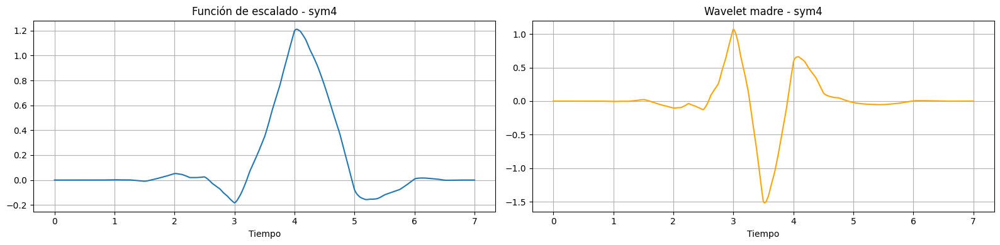

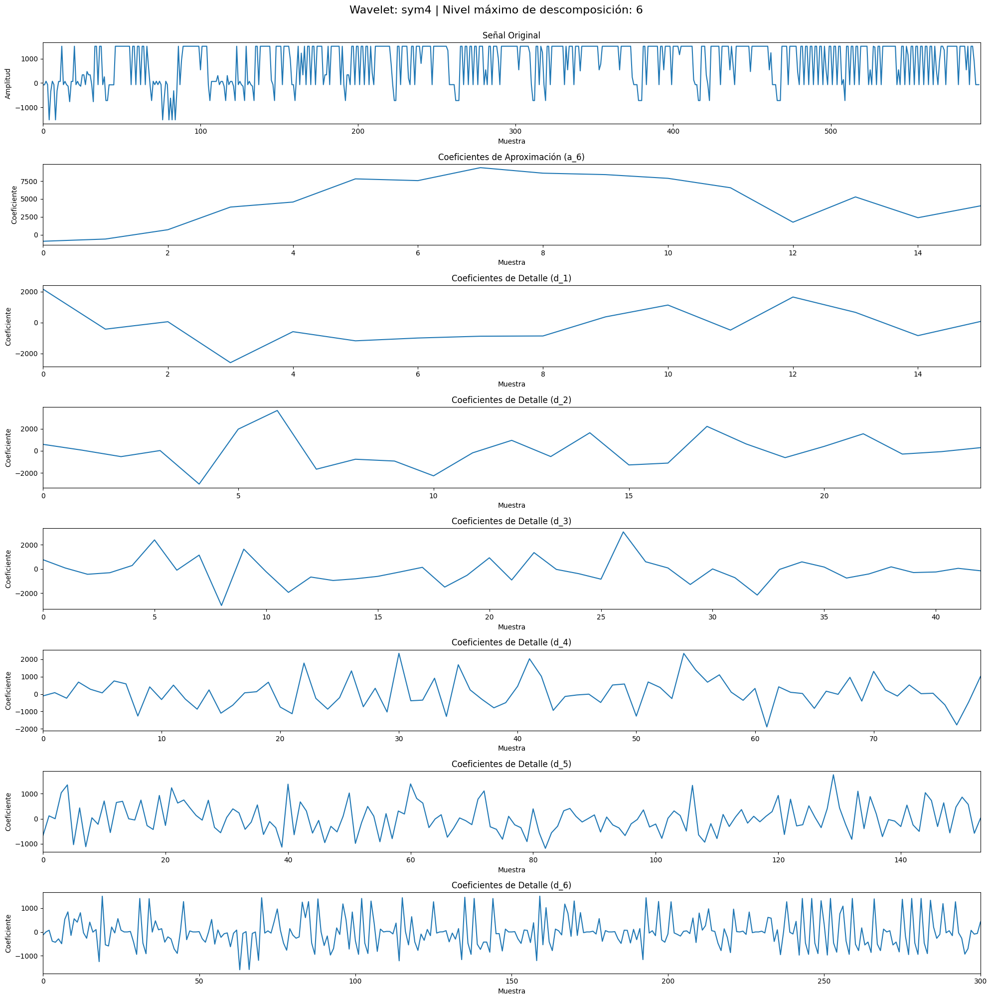

In [273]:
wavelet_name = 'sym4'
wavelet = pywt.Wavelet(wavelet_name)

phi, psi, x = wavelet.wavefun(level=10)

plt.figure(figsize=(16, 4))

plt.subplot(1, 2, 1)
plt.plot(x, phi, label='φ (función de escalado)')
plt.title(f'Función de escalado - {wavelet_name}')
plt.xlabel('Tiempo')
plt.grid(True)

plt.subplot(1, 2, 2)
plt.plot(x, psi, label='ψ (wavelet)', color='orange')
plt.title(f'Wavelet madre - {wavelet_name}')
plt.xlabel('Tiempo')
plt.grid(True)
plt.tight_layout()
plt.show()

signal_values = random_row['signal']
max_level = pywt.dwt_max_level(len(signal_values), wavelet.dec_len)
coeffs = pywt.wavedec(signal_values, wavelet, level=max_level)

# Número total de subplots: 1 (original) + 1 (aproximación) + niveles de detalle
n_plots = 1 + len(coeffs)

plt.figure(figsize=(20, 2.5 * n_plots))

# Título general
plt.suptitle(f"Wavelet: {wavelet_name} | Nivel máximo de descomposición: {max_level}", fontsize=16, y=1)

# Señal original
plt.subplot(n_plots, 1, 1)
plt.plot(signal_values)
plt.title('Señal Original')
plt.xlabel('Muestra')
plt.ylabel('Amplitud')
plt.xlim(0, len(signal_values))

# Aproximación
plt.subplot(n_plots, 1, 2)
plt.plot(coeffs[0])
plt.title(f'Coeficientes de Aproximación (a_{max_level})')
plt.xlabel('Muestra')
plt.ylabel('Coeficiente')
plt.xlim(0, len(coeffs[0]) - 1)

# Coeficientes de detalle
for i, d in enumerate(coeffs[1:], start=3):
    plt.subplot(n_plots, 1, i)
    plt.plot(d)
    plt.title(f'Coeficientes de Detalle (d_{i - 2})')
    plt.xlabel('Muestra')
    plt.ylabel('Coeficiente')
    plt.xlim(0, len(d) - 1)

plt.tight_layout()
plt.show()


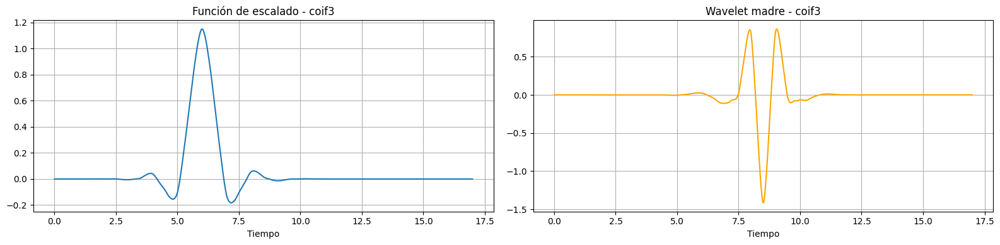

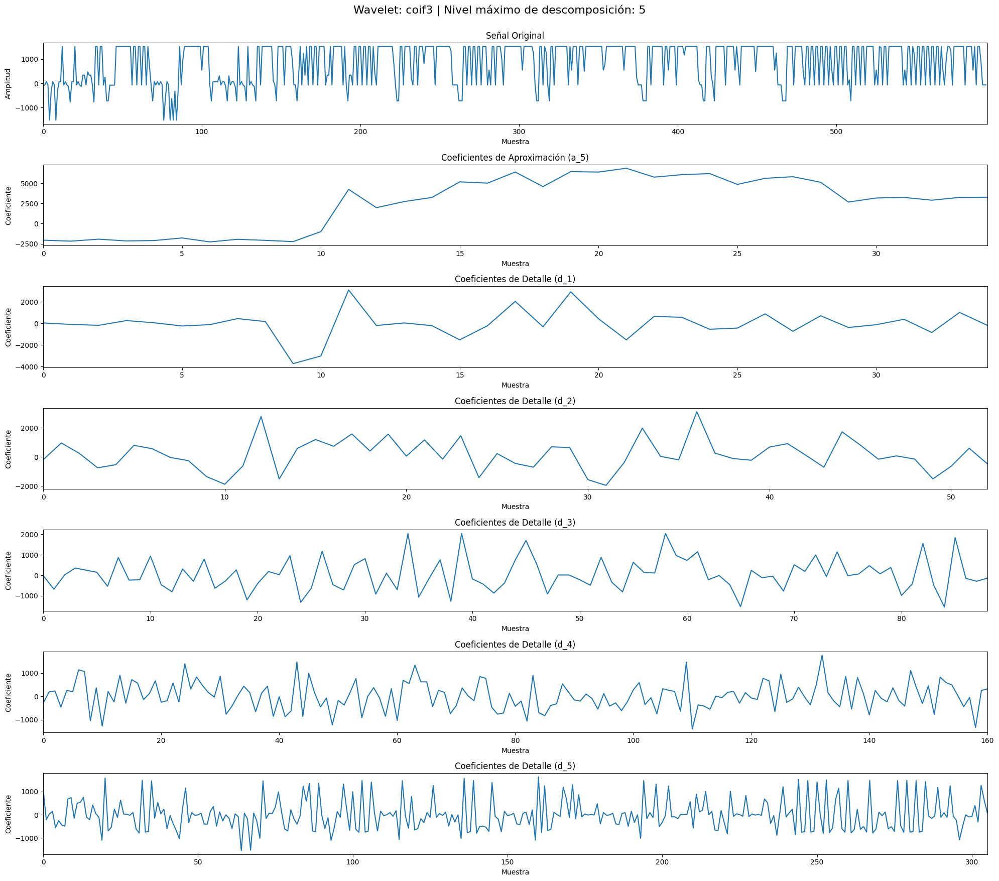

In [274]:
wavelet_name = 'coif3'
wavelet = pywt.Wavelet(wavelet_name)

phi, psi, x = wavelet.wavefun(level=10)

plt.figure(figsize=(16, 4))

plt.subplot(1, 2, 1)
plt.plot(x, phi, label='φ (función de escalado)')
plt.title(f'Función de escalado - {wavelet_name}')
plt.xlabel('Tiempo')
plt.grid(True)

plt.subplot(1, 2, 2)
plt.plot(x, psi, label='ψ (wavelet)', color='orange')
plt.title(f'Wavelet madre - {wavelet_name}')
plt.xlabel('Tiempo')
plt.grid(True)
plt.tight_layout()
plt.show()

signal_values = random_row['signal']
max_level = pywt.dwt_max_level(len(signal_values), wavelet.dec_len)
coeffs = pywt.wavedec(signal_values, wavelet, level=max_level)

# Número total de subplots: 1 (original) + 1 (aproximación) + niveles de detalle
n_plots = 1 + len(coeffs)

plt.figure(figsize=(20, 2.5 * n_plots))

# Título general
plt.suptitle(f"Wavelet: {wavelet_name} | Nivel máximo de descomposición: {max_level}", fontsize=16, y=1)

# Señal original
plt.subplot(n_plots, 1, 1)
plt.plot(signal_values)
plt.title('Señal Original')
plt.xlabel('Muestra')
plt.ylabel('Amplitud')
plt.xlim(0, len(signal_values))

# Aproximación
plt.subplot(n_plots, 1, 2)
plt.plot(coeffs[0])
plt.title(f'Coeficientes de Aproximación (a_{max_level})')
plt.xlabel('Muestra')
plt.ylabel('Coeficiente')
plt.xlim(0, len(coeffs[0]) - 1)

# Coeficientes de detalle
for i, d in enumerate(coeffs[1:], start=3):
    plt.subplot(n_plots, 1, i)
    plt.plot(d)
    plt.title(f'Coeficientes de Detalle (d_{i - 2})')
    plt.xlabel('Muestra')
    plt.ylabel('Coeficiente')
    plt.xlim(0, len(d) - 1)

plt.tight_layout()
plt.show()


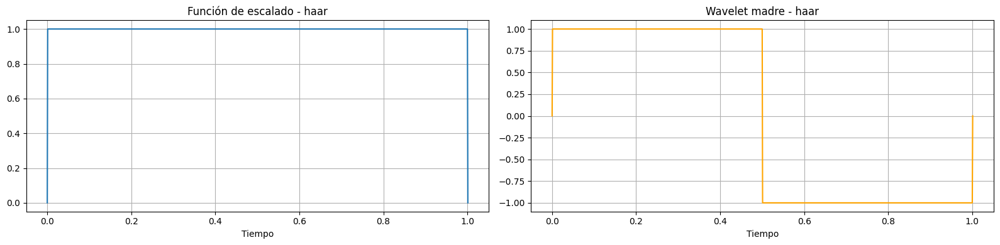

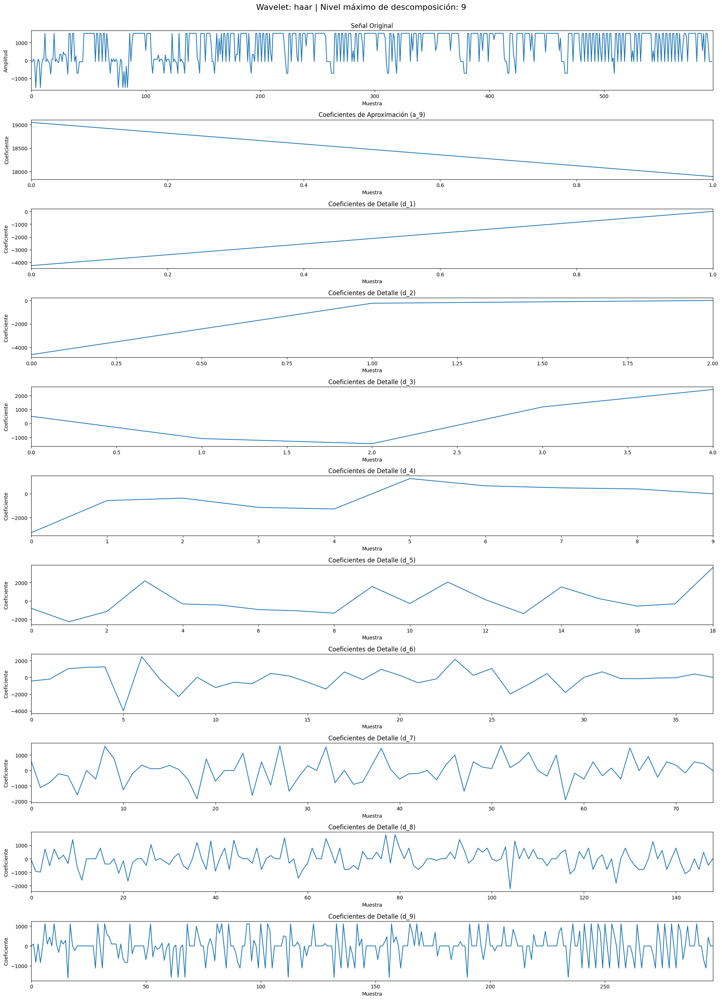

In [275]:
wavelet_name = 'haar'
wavelet = pywt.Wavelet(wavelet_name)

phi, psi, x = wavelet.wavefun(level=10)

plt.figure(figsize=(16, 4))

plt.subplot(1, 2, 1)
plt.plot(x, phi, label='φ (función de escalado)')
plt.title(f'Función de escalado - {wavelet_name}')
plt.xlabel('Tiempo')
plt.grid(True)

plt.subplot(1, 2, 2)
plt.plot(x, psi, label='ψ (wavelet)', color='orange')
plt.title(f'Wavelet madre - {wavelet_name}')
plt.xlabel('Tiempo')
plt.grid(True)
plt.tight_layout()
plt.show()

signal_values = random_row['signal']
max_level = pywt.dwt_max_level(len(signal_values), wavelet.dec_len)
coeffs = pywt.wavedec(signal_values, wavelet, level=max_level)

# Número total de subplots: 1 (original) + 1 (aproximación) + niveles de detalle
n_plots = 1 + len(coeffs)

plt.figure(figsize=(20, 2.5 * n_plots))

# Título general
plt.suptitle(f"Wavelet: {wavelet_name} | Nivel máximo de descomposición: {max_level}", fontsize=16, y=1)

# Señal original
plt.subplot(n_plots, 1, 1)
plt.plot(signal_values)
plt.title('Señal Original')
plt.xlabel('Muestra')
plt.ylabel('Amplitud')
plt.xlim(0, len(signal_values))

# Aproximación
plt.subplot(n_plots, 1, 2)
plt.plot(coeffs[0])
plt.title(f'Coeficientes de Aproximación (a_{max_level})')
plt.xlabel('Muestra')
plt.ylabel('Coeficiente')
plt.xlim(0, len(coeffs[0]) - 1)

# Coeficientes de detalle
for i, d in enumerate(coeffs[1:], start=3):
    plt.subplot(n_plots, 1, i)
    plt.plot(d)
    plt.title(f'Coeficientes de Detalle (d_{i - 2})')
    plt.xlabel('Muestra')
    plt.ylabel('Coeficiente')
    plt.xlim(0, len(d) - 1)

plt.tight_layout()
plt.show()


In [276]:
def compare_wavelet_decompositions(signal1, signal2, wavelet_name='haar'):
    wavelet = pywt.Wavelet(wavelet_name)
    
    phi, psi, x = wavelet.wavefun(level=10)

    plt.figure(figsize=(16, 4))

    plt.subplot(1, 2, 1)
    plt.plot(x, phi, label='φ (función de escalado)')
    plt.title(f'Función de escalado - {wavelet_name}')
    plt.xlabel('Tiempo')
    plt.grid(True)

    plt.subplot(1, 2, 2)
    plt.plot(x, psi, label='ψ (wavelet)', color='orange')
    plt.title(f'Wavelet madre - {wavelet_name}')
    plt.xlabel('Tiempo')
    plt.grid(True)
    plt.tight_layout()
    plt.show()

    max_level = pywt.dwt_max_level(min(len(signal1), len(signal2)), wavelet.dec_len)

    coeffs1 = pywt.wavedec(signal1, wavelet, level=max_level)
    coeffs2 = pywt.wavedec(signal2, wavelet, level=max_level)

    n_levels = len(coeffs1)  # misma cantidad de niveles en ambas señales

    plt.figure(figsize=(24, 2.5 * n_levels))
    plt.suptitle(f"Comparación lado a lado - Wavelet: {wavelet_name} | Nivel máximo: {max_level}", fontsize=16, y=1)

    # Señal original
    plt.subplot(n_levels, 2, 1)
    plt.plot(signal1)
    plt.title('Señal 1 - Original')
    plt.xlabel('Muestra')
    plt.ylabel('Amplitud')
    plt.xlim(0, len(signal1))

    plt.subplot(n_levels, 2, 2)
    plt.plot(signal2)
    plt.title('Señal 2 - Original')
    plt.xlabel('Muestra')
    plt.ylabel('Amplitud')
    plt.xlim(0, len(signal2))

    # Aproximaciones y detalles
    for i in range(1, n_levels):
        plt.subplot(n_levels, 2, 2 * i + 1)
        plt.plot(coeffs1[i] if i > 0 else coeffs1[0])
        title = f'Coef. Aproximación (a_{max_level})' if i == 0 else f'Coef. Detalle (d_{i})'
        plt.title(f'Señal 1 - {title}')
        plt.xlabel('Muestra')
        plt.ylabel('Coef.')

        plt.subplot(n_levels, 2, 2 * i + 2)
        plt.plot(coeffs2[i] if i > 0 else coeffs2[0])
        title = f'Coef. Aproximación (a_{max_level})' if i == 0 else f'Coef. Detalle (d_{i})'
        plt.title(f'Señal 2 - {title}')
        plt.xlabel('Muestra')
        plt.ylabel('Coef.')

    plt.tight_layout()
    plt.show()


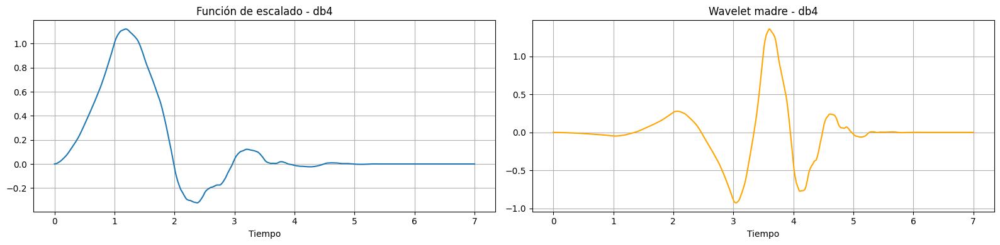

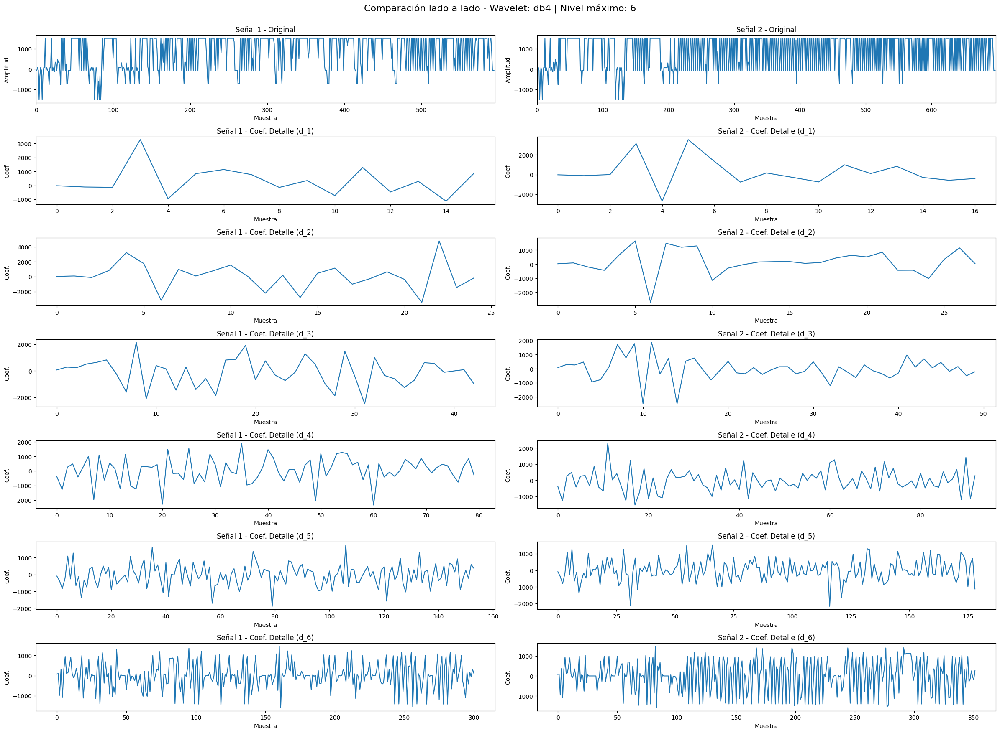

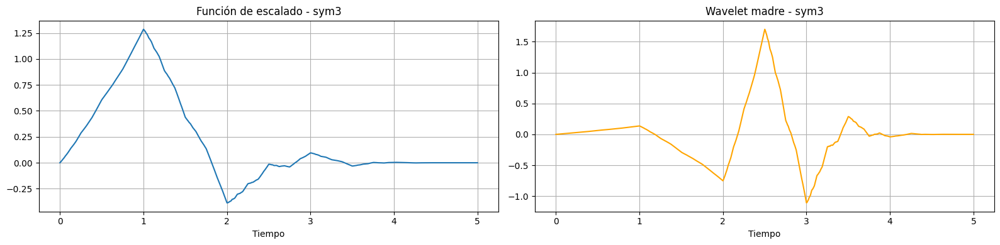

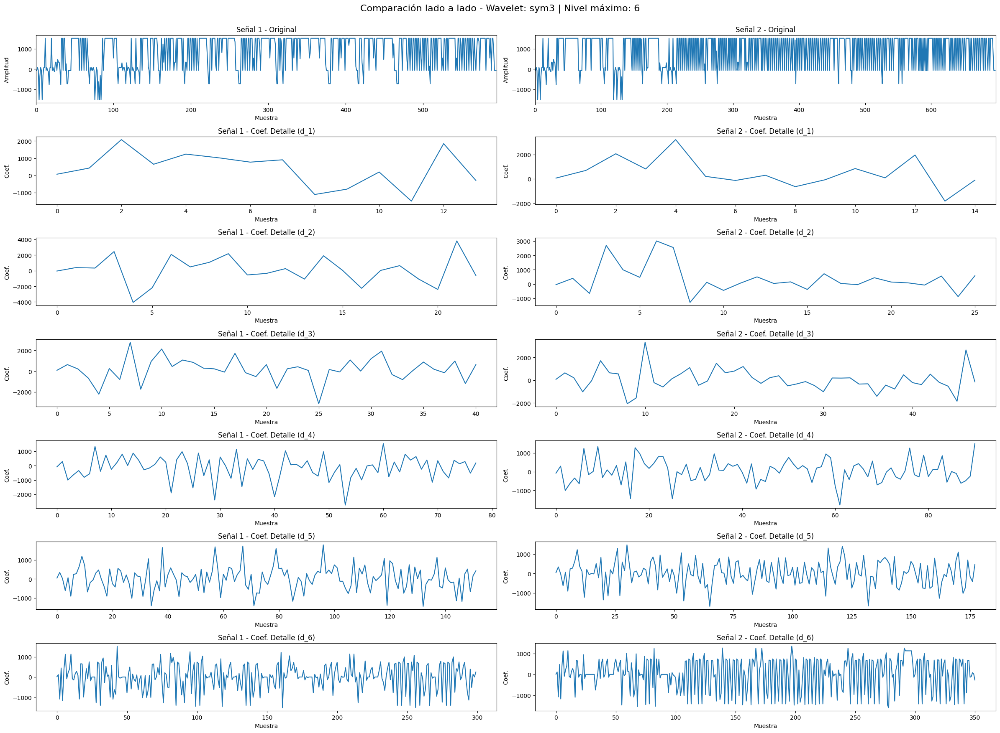

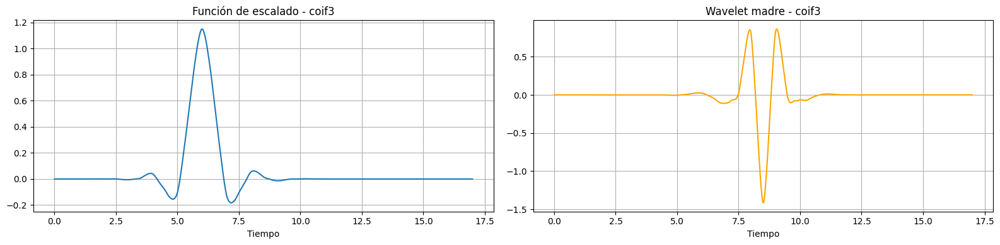

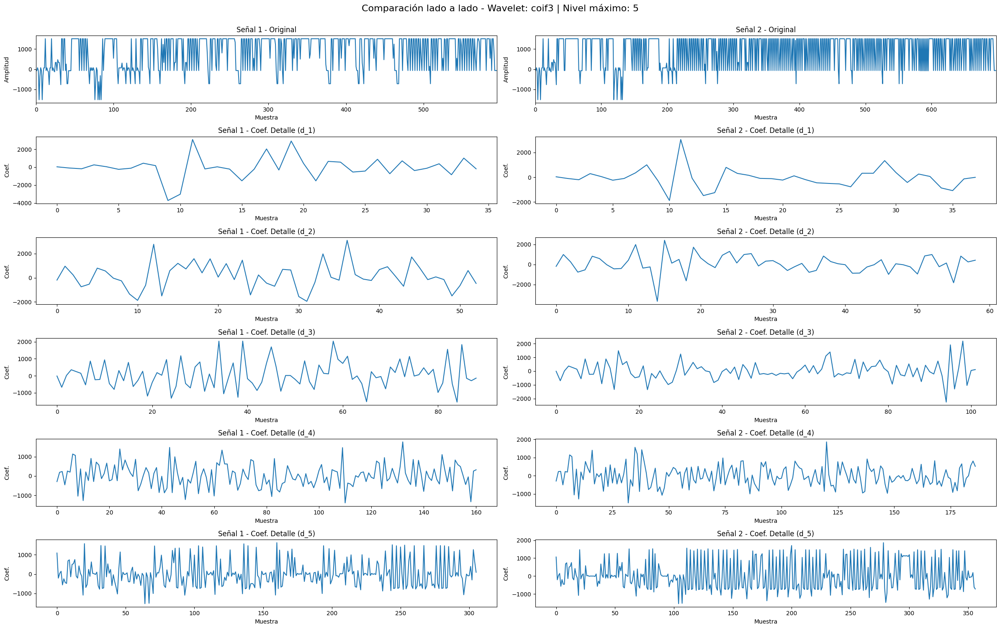

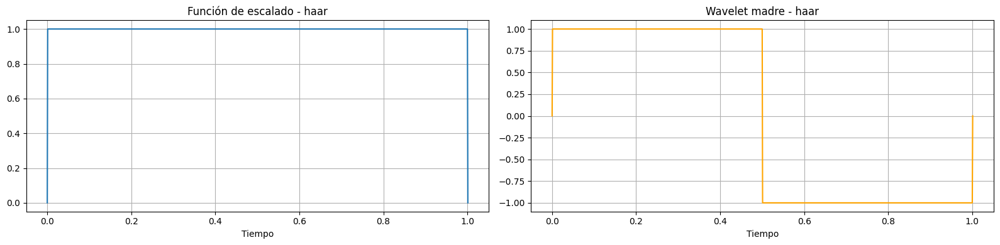

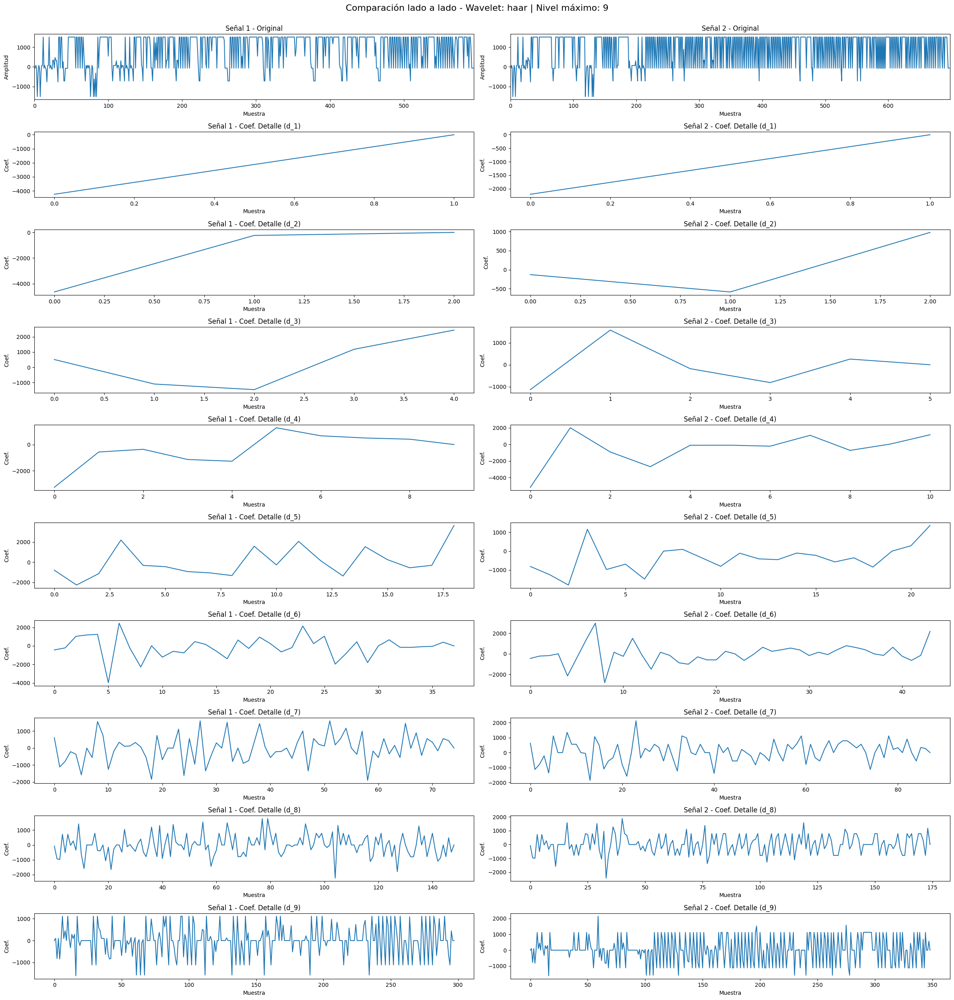

In [277]:
label_actual = random_row['label']
otra_row = df[df['label'] != label_actual].sample(1).iloc[0]

compare_wavelet_decompositions(random_row['signal'], otra_row['signal'], wavelet_name='db4')
compare_wavelet_decompositions(random_row['signal'], otra_row['signal'], wavelet_name='sym3')
compare_wavelet_decompositions(random_row['signal'], otra_row['signal'], wavelet_name='coif3')
compare_wavelet_decompositions(random_row['signal'], otra_row['signal'], wavelet_name='haar')

In [278]:
import scipy.stats as stats

def extract_wavelet_features(signal, wavelet_name='db4', level=5):
    wavelet = pywt.Wavelet(wavelet_name)
    max_level = pywt.dwt_max_level(len(signal), wavelet.dec_len) if level is None else level
    coeffs = pywt.wavedec(signal, wavelet, level=max_level)

    features = {}
    for i, c in enumerate(coeffs):
        prefix = f"a_{max_level}" if i == 0 else f"d_{i}"
        features[f"{prefix}_energy"] = np.sum(np.square(c))
        features[f"{prefix}_mean"] = np.mean(c)
        features[f"{prefix}_std"] = np.std(c)
        features[f"{prefix}_kurtosis"] = stats.kurtosis(c)
        features[f"{prefix}_skew"] = stats.skew(c)
        features[f"{prefix}_entropy"] = -np.sum(np.abs(c/np.sum(np.abs(c))) * np.log2(np.abs(c/np.sum(np.abs(c))) + 1e-12))

    return features

In [279]:
from sklearn.manifold import TSNE

/home/barri/Desktop/website-fingerprinting/.venv/lib/python3.12/site-packages/pywt/_multilevel.py:43: UserWarning: Level value of 5 is too high: all coefficients will experience boundary effects.
  warnings.warn(


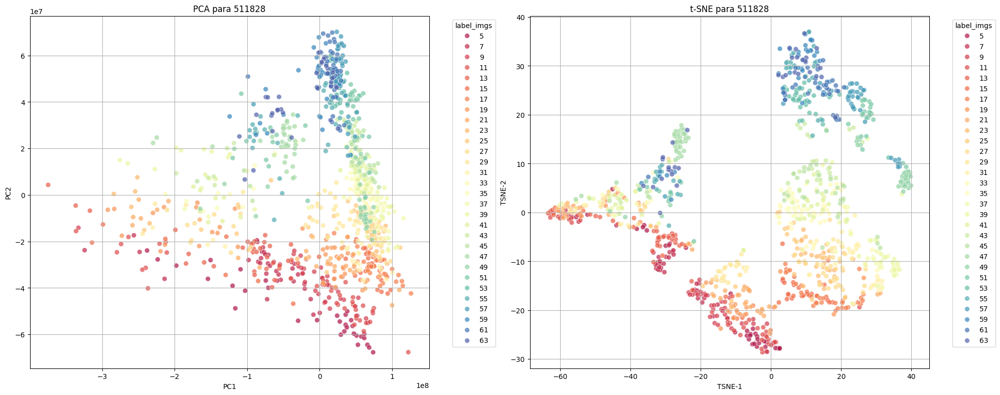

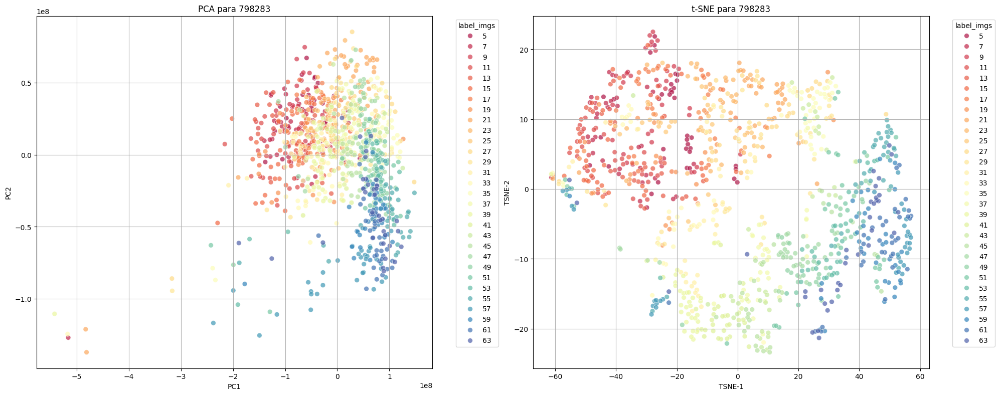

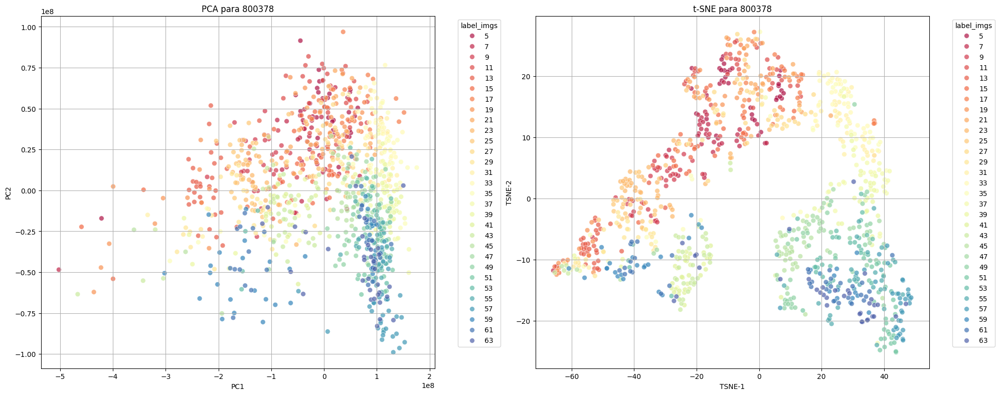

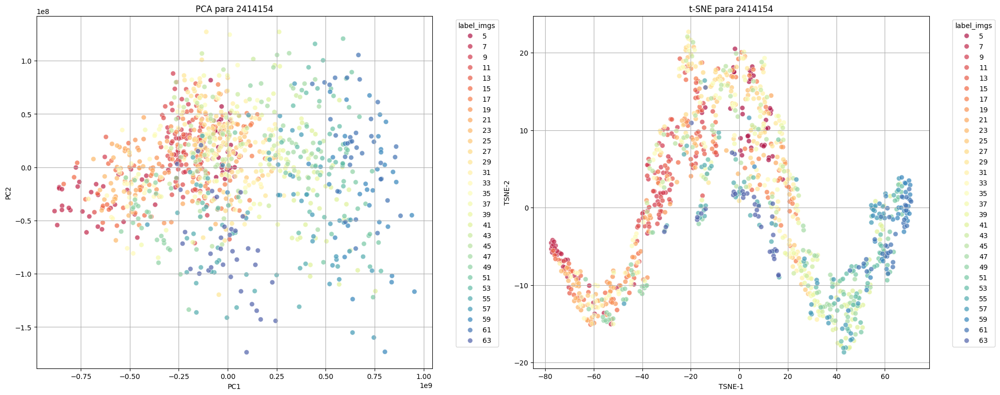

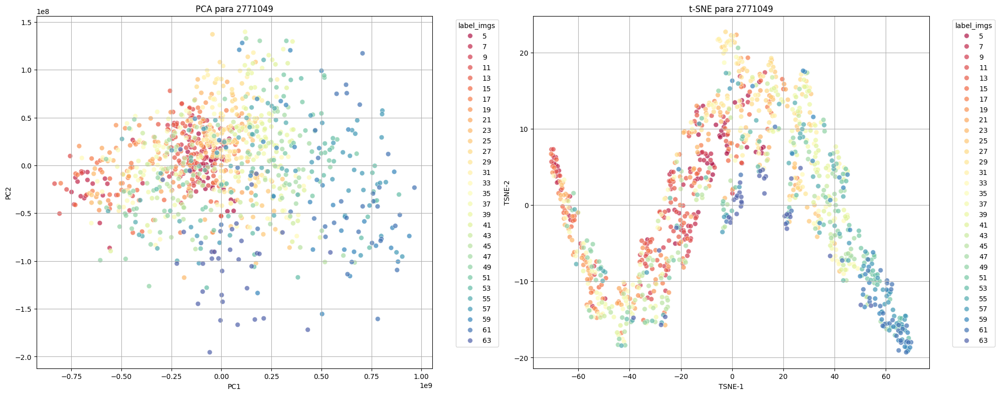

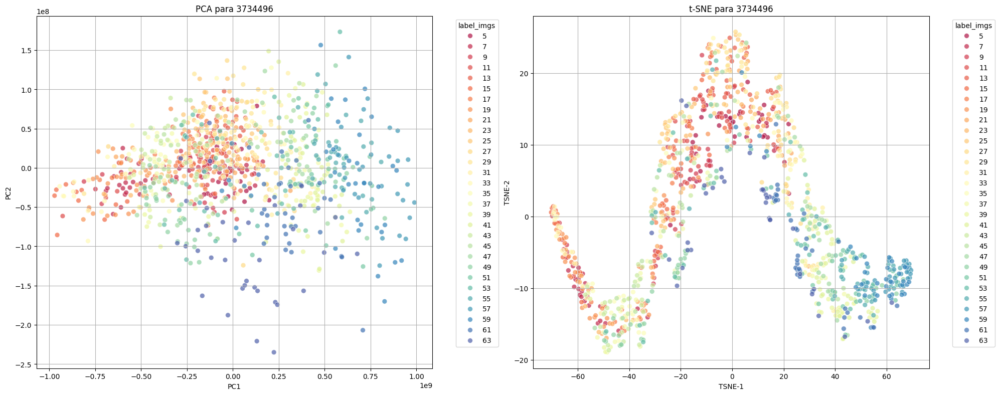

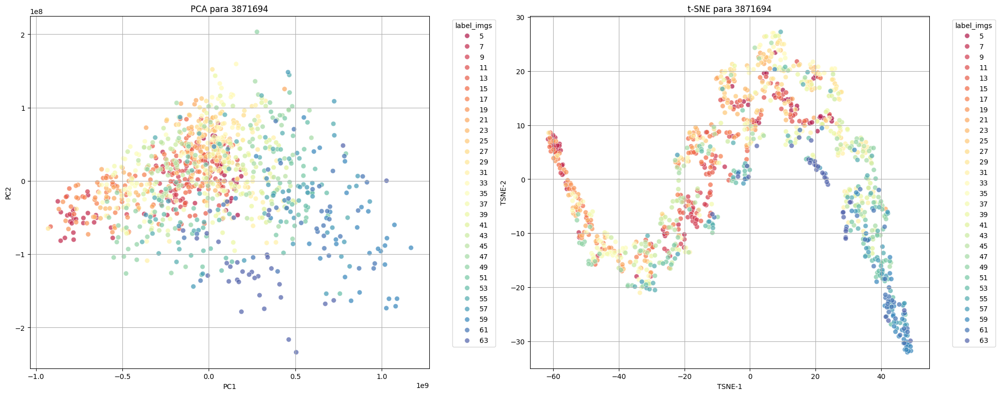

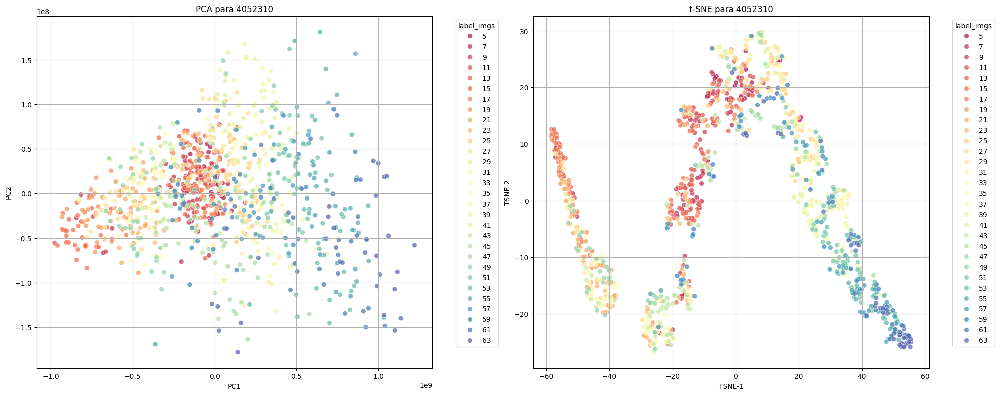

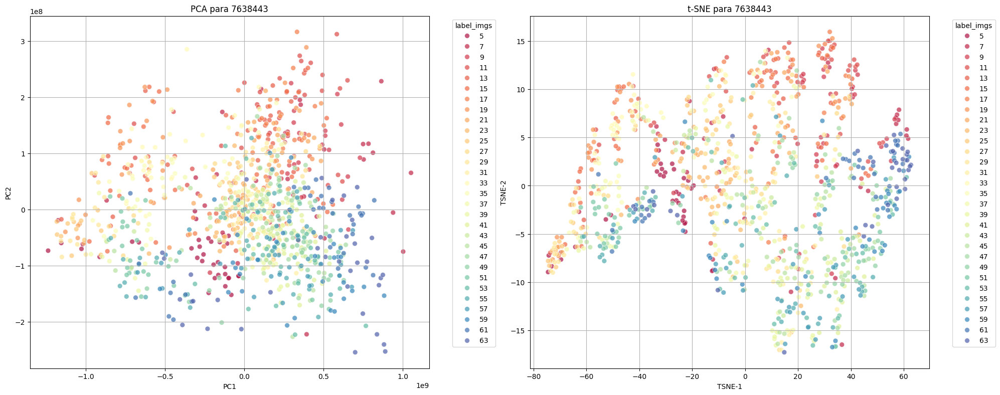

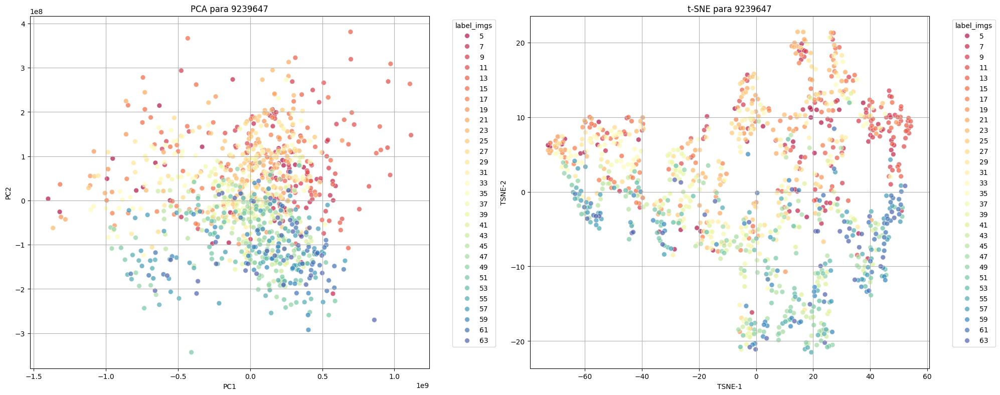

In [280]:
df["wavelet_features"] = df["signal"].apply(lambda x: extract_wavelet_features(x, wavelet_name='sym3'))

label_sizes = sorted(df['label_size'].unique())
for label_size in label_sizes:
    subset = df[df['label_size'] == label_size].reset_index(drop=True)
    X = pd.json_normalize(subset['wavelet_features'])
    y = subset["label_imgs"]
    
    sorted_idx = y.sort_values().index
    X = X.loc[sorted_idx].reset_index(drop=True)
    y = y.loc[sorted_idx].reset_index(drop=True).astype(str)


    pca = PCA(n_components=2)
    X_pca = pca.fit_transform(X)

    tsne = TSNE(n_components=2, random_state=42, perplexity=30)
    X_tsne = tsne.fit_transform(X)

    fig, axes = plt.subplots(1, 2, figsize=(20, 8))

    sns.scatterplot(ax=axes[0], x=X_pca[:, 0], y=X_pca[:, 1], hue=y, palette='Spectral', s=50, alpha=0.7)
    axes[0].set_title('PCA para ' + str(label_size))
    axes[0].set_xlabel('PC1')
    axes[0].set_ylabel('PC2')
    axes[0].legend(title='label_imgs', bbox_to_anchor=(1.05, 1), loc='upper left')
    axes[0].grid(True)

    sns.scatterplot(ax=axes[1], x=X_tsne[:, 0], y=X_tsne[:, 1], hue=y, palette='Spectral', s=50, alpha=0.7)
    axes[1].set_title('t-SNE para ' + str(label_size))
    axes[1].set_xlabel('TSNE-1')
    axes[1].set_ylabel('TSNE-2')
    axes[1].legend(title='label_imgs', bbox_to_anchor=(1.05, 1), loc='upper left')
    axes[1].grid(True)

    plt.tight_layout()
    plt.show()


In [281]:
def extract_wavelet_features2(signal, wavelet_names=['db4', "sym3", "coif3", "haar"], level=5):
    
    features = {}
    for wavelet_name in wavelet_names:
        
        wavelet = pywt.Wavelet(wavelet_name)
        max_level = pywt.dwt_max_level(len(signal), wavelet.dec_len) if level is None else level
        coeffs = pywt.wavedec(signal, wavelet, level=max_level)

        for i, c in enumerate(coeffs):
            prefix = f"a_{max_level}" if i == 0 else f"d_{i}"
            features[f"{wavelet_name}_{prefix}_energy"] = np.sum(np.square(c))
            features[f"{wavelet_name}_{prefix}_mean"] = np.mean(c)
            features[f"{wavelet_name}_{prefix}_std"] = np.std(c)
            features[f"{wavelet_name}_{prefix}_kurtosis"] = stats.kurtosis(c)
            features[f"{wavelet_name}_{prefix}_skew"] = stats.skew(c)
            features[f"{wavelet_name}_{prefix}_entropy"] = -np.sum(np.abs(c/np.sum(np.abs(c))) * np.log2(np.abs(c/np.sum(np.abs(c))) + 1e-12))

    return features

/home/barri/Desktop/website-fingerprinting/.venv/lib/python3.12/site-packages/pywt/_multilevel.py:43: UserWarning: Level value of 5 is too high: all coefficients will experience boundary effects.
  warnings.warn(


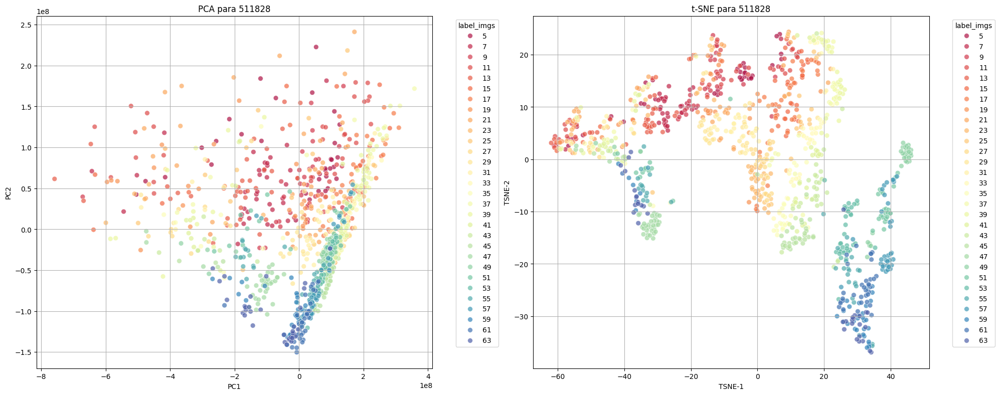

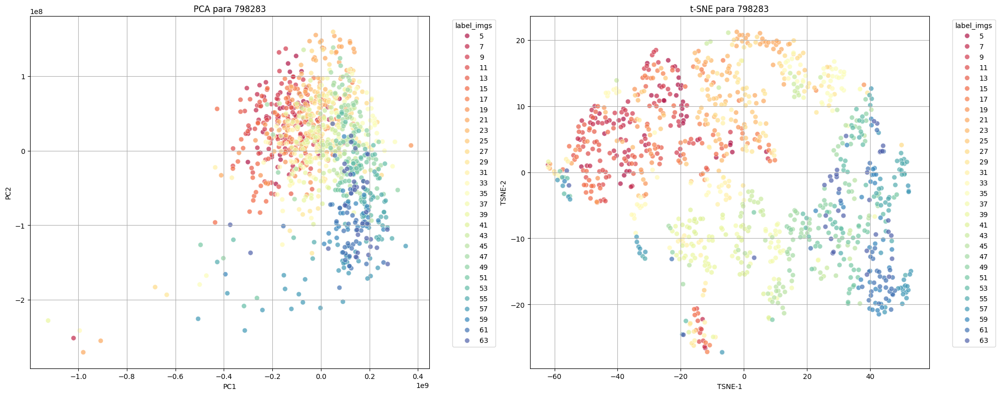

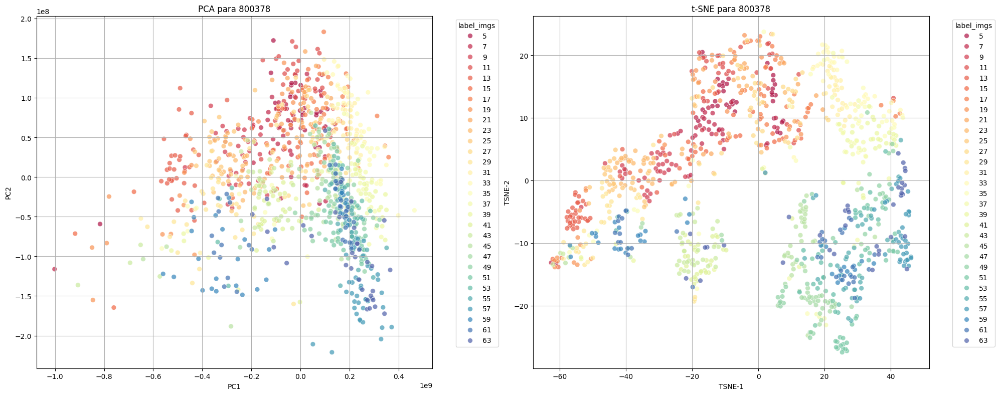

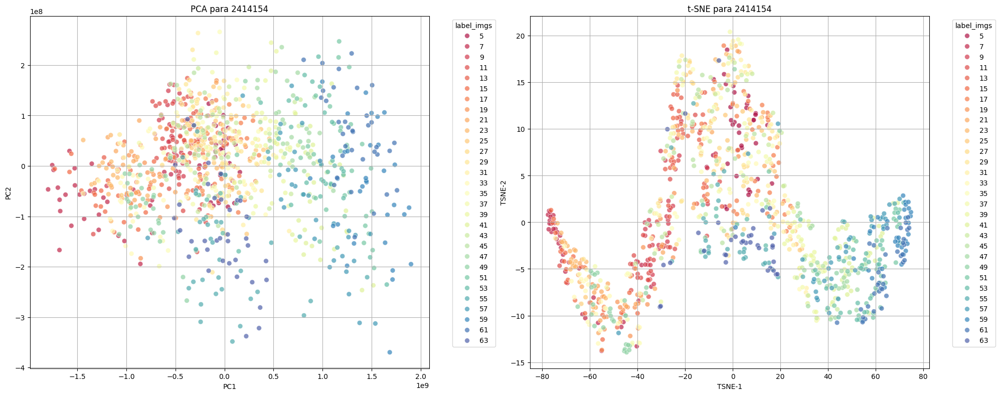

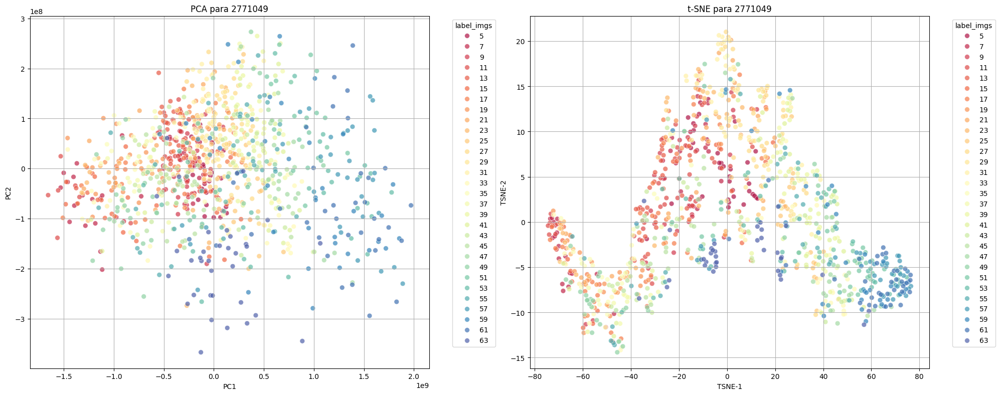

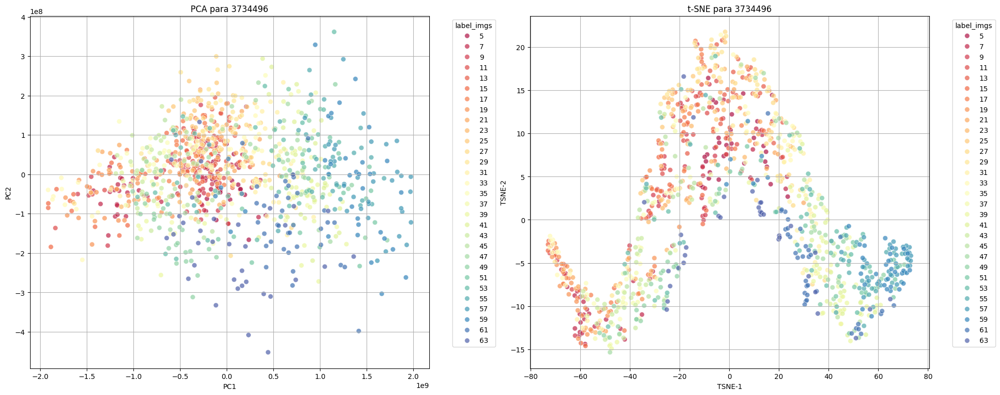

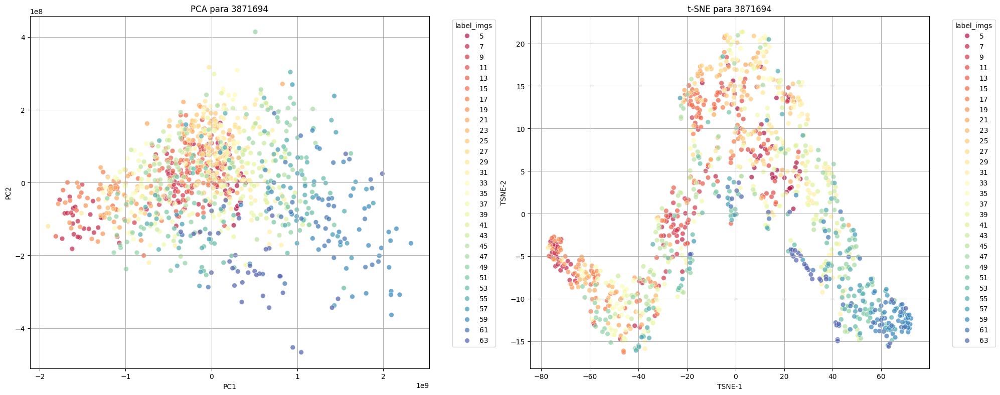

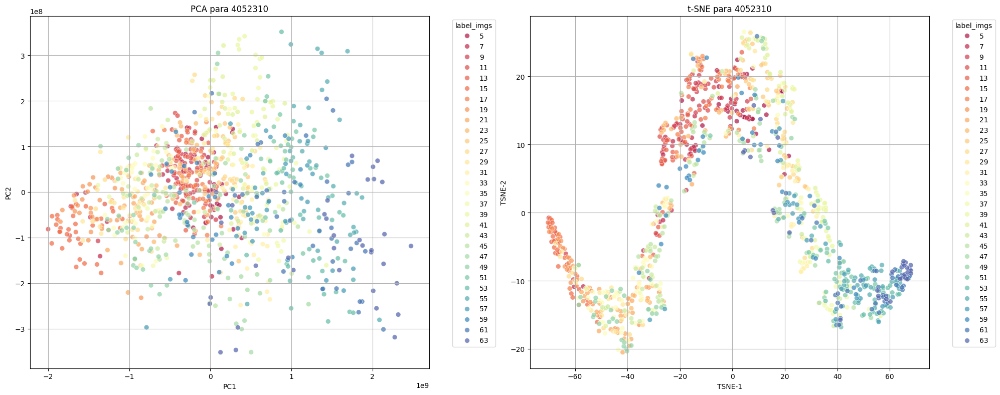

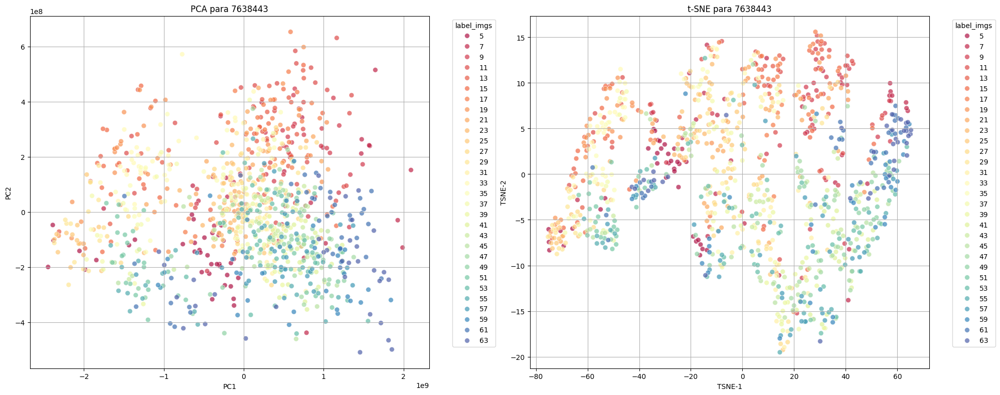

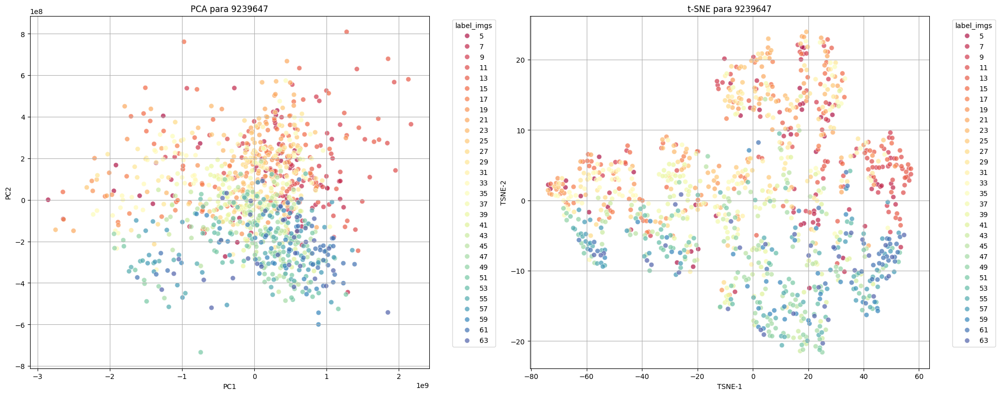

In [282]:
df["wavelet_features2"] = df["signal"].apply(lambda x: extract_wavelet_features2(x))

label_sizes = sorted(df['label_size'].unique())
for label_size in label_sizes:
    subset = df[df['label_size'] == label_size].reset_index(drop=True)
    X = pd.json_normalize(subset['wavelet_features2'])
    y = subset["label_imgs"]
    
    sorted_idx = y.sort_values().index
    X = X.loc[sorted_idx].reset_index(drop=True)
    y = y.loc[sorted_idx].reset_index(drop=True).astype(str)


    pca = PCA(n_components=2)
    X_pca = pca.fit_transform(X)

    tsne = TSNE(n_components=2, random_state=42, perplexity=30)
    X_tsne = tsne.fit_transform(X)

    fig, axes = plt.subplots(1, 2, figsize=(20, 8))

    sns.scatterplot(ax=axes[0], x=X_pca[:, 0], y=X_pca[:, 1], hue=y, palette='Spectral', s=50, alpha=0.7)
    axes[0].set_title('PCA para ' + str(label_size))
    axes[0].set_xlabel('PC1')
    axes[0].set_ylabel('PC2')
    axes[0].legend(title='label_imgs', bbox_to_anchor=(1.05, 1), loc='upper left')
    axes[0].grid(True)

    sns.scatterplot(ax=axes[1], x=X_tsne[:, 0], y=X_tsne[:, 1], hue=y, palette='Spectral', s=50, alpha=0.7)
    axes[1].set_title('t-SNE para ' + str(label_size))
    axes[1].set_xlabel('TSNE-1')
    axes[1].set_ylabel('TSNE-2')
    axes[1].legend(title='label_imgs', bbox_to_anchor=(1.05, 1), loc='upper left')
    axes[1].grid(True)

    plt.tight_layout()
    plt.show()

### Evaluación

CUMUL

In [284]:
cumul = df[["cumul_interpolated", "incoming_packets", "incoming_bytes", "outgoing_packets", "outgoing_bytes", "label", "label_size", "label_imgs"]].copy()
cumul.head()

,cumul_interpolated,incoming_packets,incoming_bytes,outgoing_packets,outgoing_bytes,label,label_size,label_imgs
0,"[-74, -1942, -2207, -2639, -1457, 11, 5271, 11...",433,565410,179,61737,511828_57_0000,511828,57
1,"[-74, -3066, -2337, -1615, -24, 7669, 17789, 1...",549,769807,217,35657,4052310_35_0000,4052310,35
2,"[-74, -1532, -3298, -2647, -2297, -865, -1721,...",257,330534,132,29333,511828_25_0000,511828,25
3,"[-74, -2317, -692, 17934, 30513, 48828, 59991,...",1148,1644128,424,66503,9239647_47_0000,9239647,47
4,"[-74, -2919, 5342, 27879, 46577, 73847, 102705...",1397,2010601,491,81197,7638443_61_0000,7638443,61


In [285]:
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, roc_curve, confusion_matrix, classification_report
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.preprocessing import label_binarize


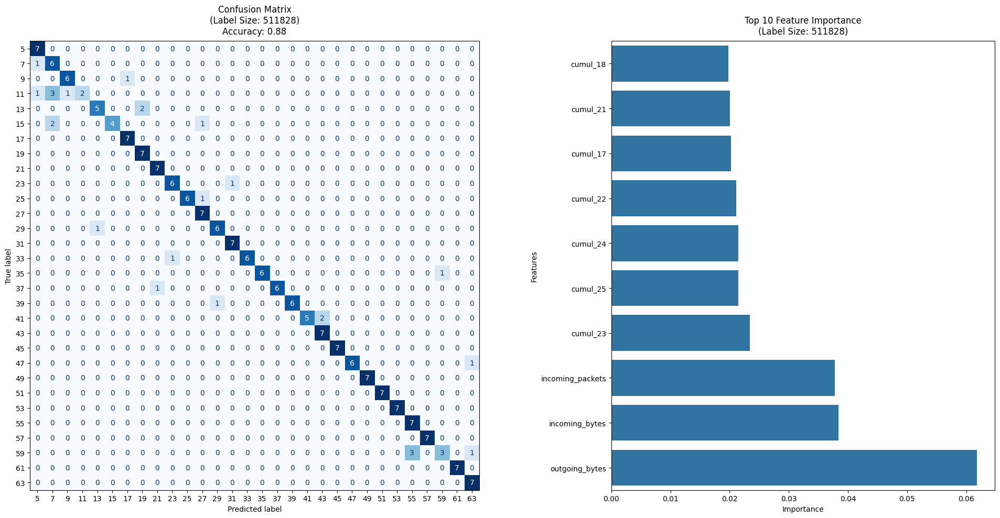

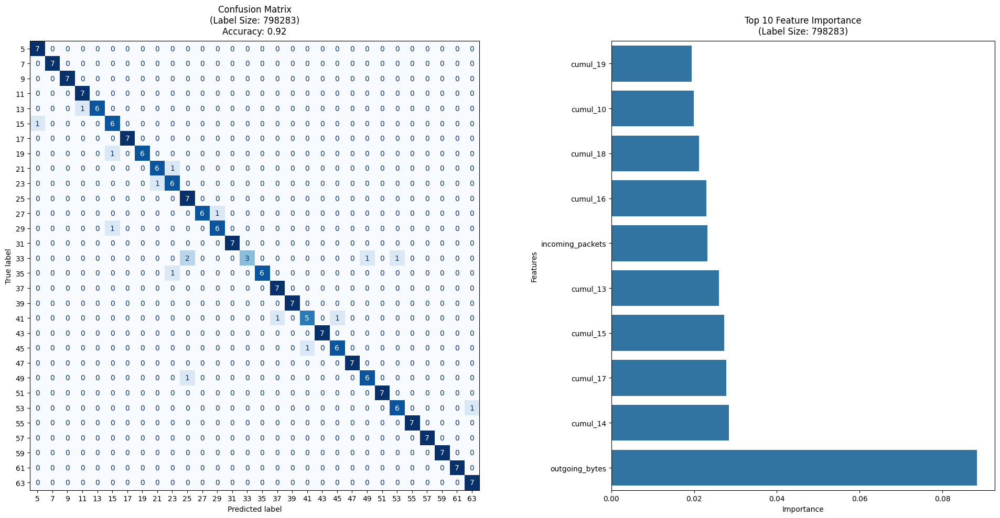

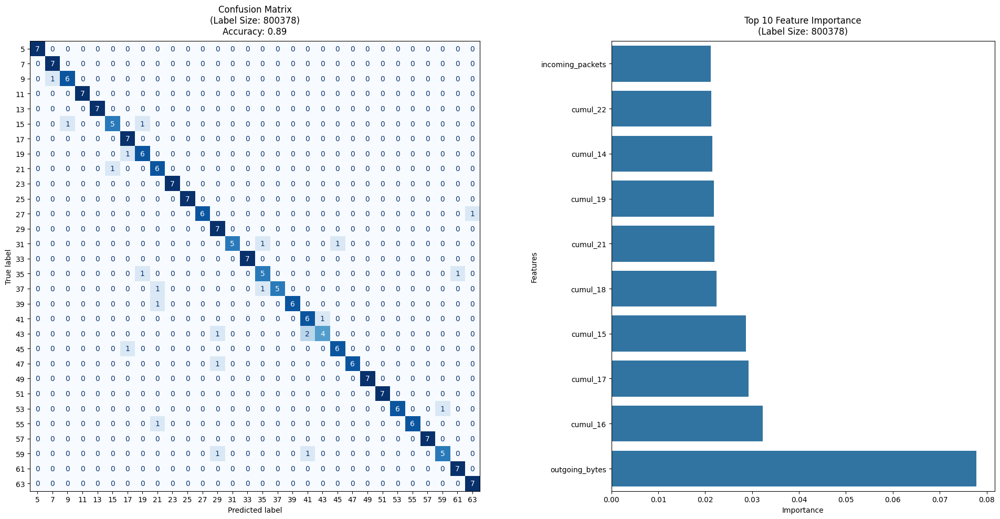

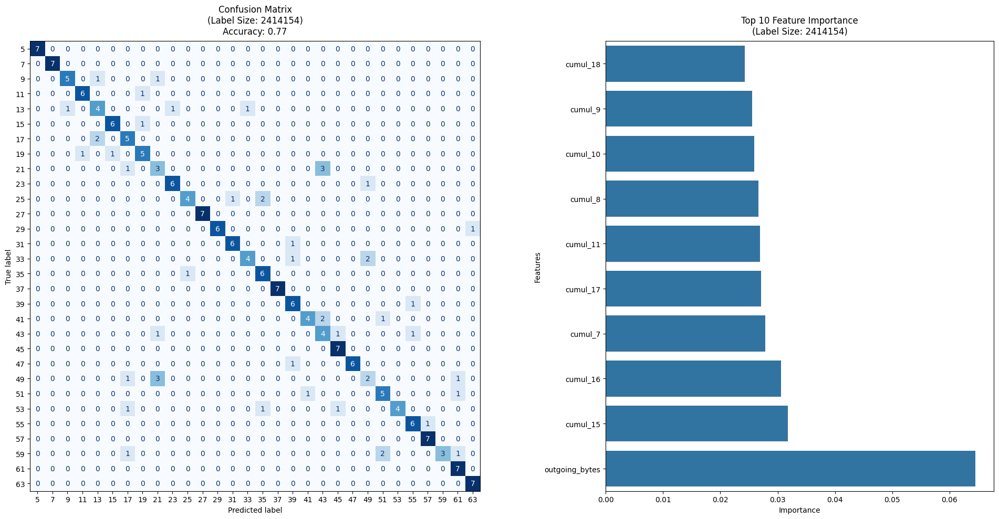

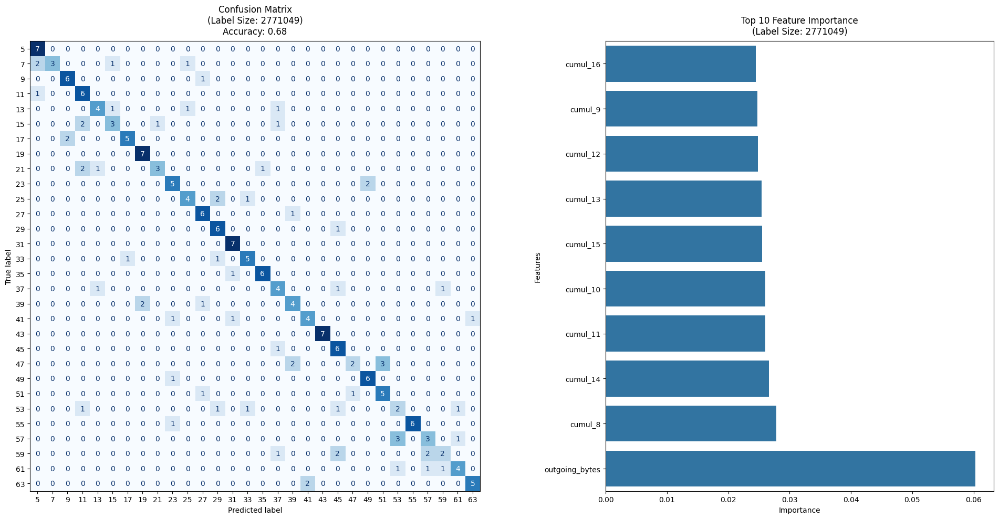

...

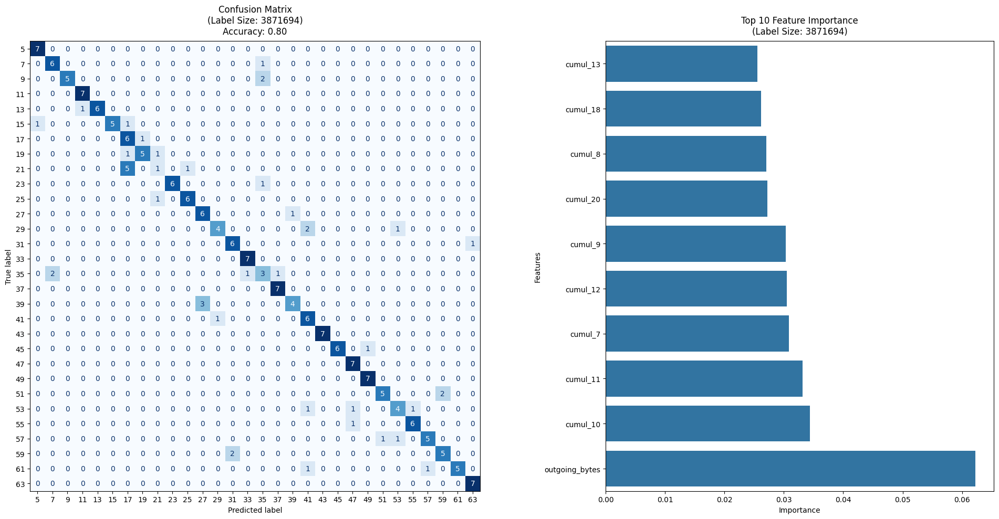

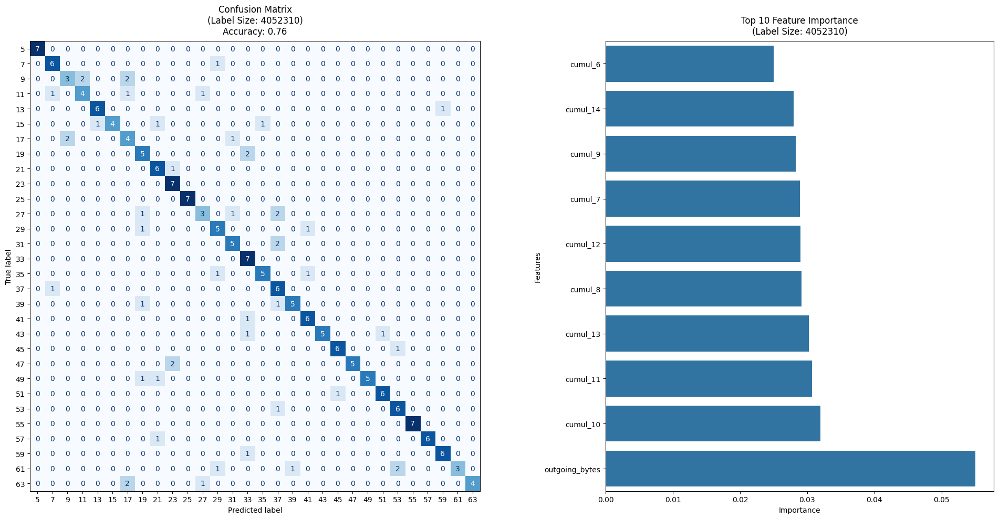

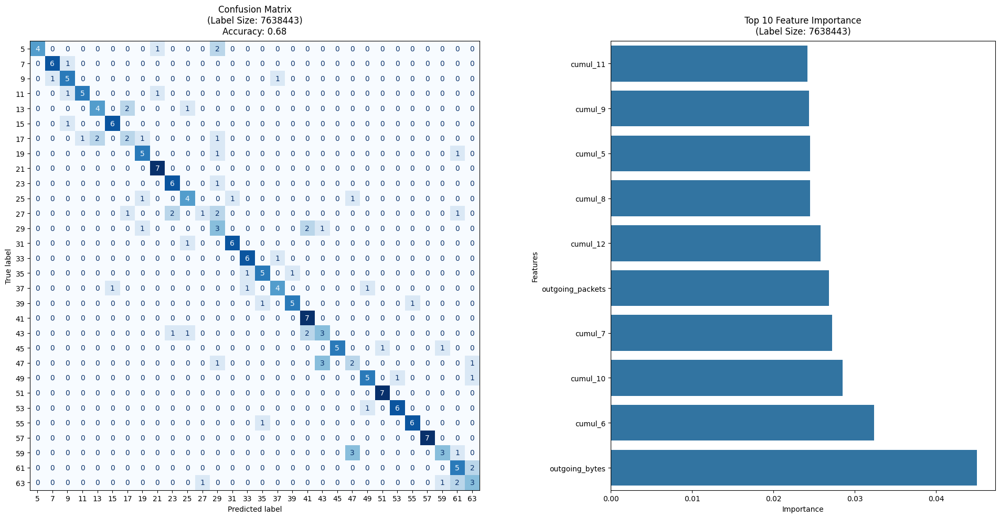

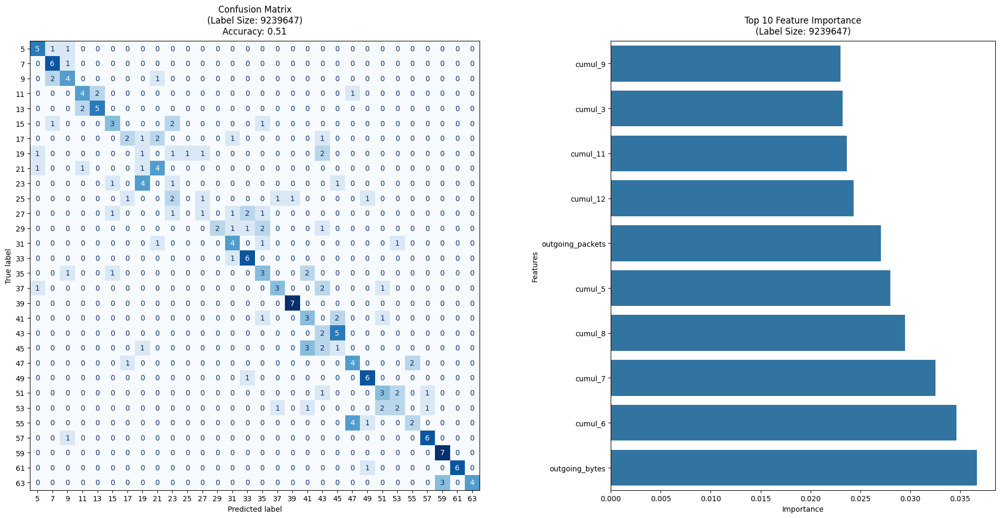

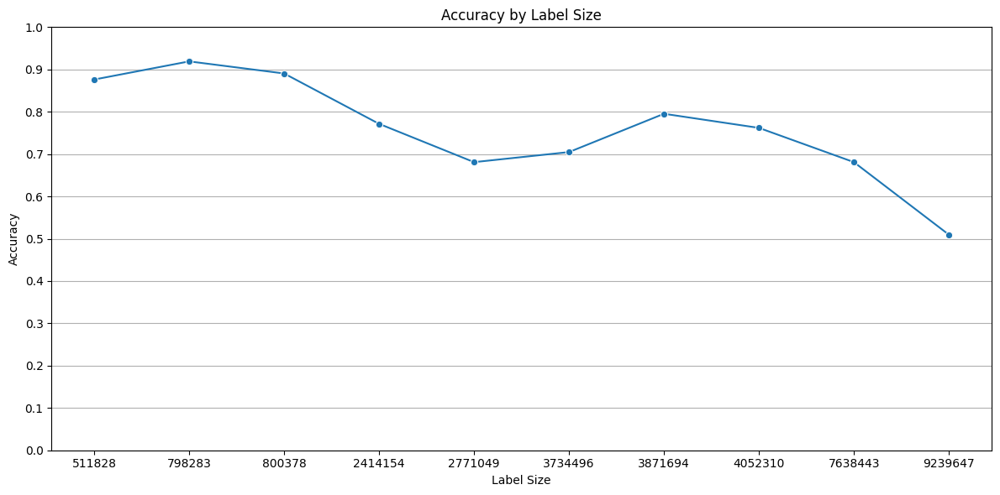

In [286]:
from matplotlib.gridspec import GridSpec

all_metrics = []

label_sizes = sorted(cumul['label_size'].unique())
for label_size in label_sizes:
    subset = cumul[cumul['label_size'] == label_size].reset_index(drop=True)

    X_cumul = pd.concat([subset[["incoming_packets", "outgoing_packets", "incoming_bytes", "outgoing_bytes"]].reset_index(drop=True), pd.DataFrame(subset["cumul_interpolated"].tolist(), columns=[f"cumul_{i}" for i in range(100)])], axis=1)
    y = subset["label_imgs"].reset_index(drop=True).astype(str)

    X_train, X_test, y_train, y_test = train_test_split(X_cumul, y, test_size=0.2, random_state=42, stratify=y)
    
    pipe = Pipeline([
        ('scaler', StandardScaler()),
        ('rf', RandomForestClassifier(n_estimators=200, random_state=42))
    ])
    
    pipe.fit(X_train, y_train)
    
    y_pred = pipe.predict(X_test)
    y_pred_proba = pipe.predict_proba(X_test)
    
    accuracy = accuracy_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred, average='weighted', zero_division=0)
    recall = recall_score(y_test, y_pred, average='weighted', zero_division=0)
    f1 = f1_score(y_test, y_pred, average='weighted', zero_division=0)
    
    y_test_bin = label_binarize(y_test, classes=pipe.classes_)
    roc_auc = roc_auc_score(y_test_bin, y_pred_proba, multi_class='ovr', average='weighted')

    metrics = {
        'Label Size': label_size,
        'Accuracy': accuracy,
        'Precision': precision,
        'Recall': recall,
        'F1-Score': f1,
        'ROC-AUC': roc_auc
    }
    all_metrics.append(metrics)

    fig = plt.figure(figsize=(20, 10))
    gs = GridSpec(1, 2, width_ratios=[3, 2], figure=fig)

    # Confusion Matrix (wider)
    ax0 = fig.add_subplot(gs[0])
    cm = confusion_matrix(y_test, y_pred)
    sorted_classes = sorted(pipe.classes_, key=int)
    idx = [list(pipe.classes_).index(c) for c in sorted_classes]
    cm_sorted = cm[idx, :][:, idx]
    disp = ConfusionMatrixDisplay(confusion_matrix=cm_sorted, display_labels=sorted_classes)
    disp.plot(cmap='Blues', values_format='.0f', ax=ax0, colorbar=False)
    ax0.set_title(f'Confusion Matrix\n(Label Size: {label_size})\nAccuracy: {accuracy:.2f}', pad=10)

    # Feature Importance
    ax1 = fig.add_subplot(gs[1])
    feature_importance = pipe.named_steps['rf'].feature_importances_
    feature_names = X_cumul.columns
    sorted_idx = np.argsort(feature_importance)[-10:]  # Top 10 features
    sns.barplot(x=feature_importance[sorted_idx], y=feature_names[sorted_idx], ax=ax1)
    ax1.set_title(f'Top 10 Feature Importance\n(Label Size: {label_size})', pad=10)
    ax1.set_xlabel('Importance')
    ax1.set_ylabel("Features")

    plt.tight_layout()
    plt.show()
    
cumul_metrics = pd.DataFrame(all_metrics)
plt.figure(figsize=(12, 6))
sns.lineplot(x=cumul_metrics["Label Size"].astype(str), y=cumul_metrics["Accuracy"], marker='o')
plt.title("Accuracy by Label Size")
plt.xlabel("Label Size")
plt.ylabel("Accuracy")
plt.ylim(0, 1)
plt.yticks(np.arange(0, 1.1, 0.1))
plt.grid(axis='y')
plt.tight_layout()
plt.show()

WAVELETS

In [287]:
wavelets = df[["incoming_packets", "incoming_bytes", "outgoing_packets", "outgoing_bytes", "label", "label_size", "label_imgs"]].copy()
wavelets_features = pd.json_normalize(df["wavelet_features"])
wavelets = pd.concat([wavelets.reset_index(drop=True), wavelets_features.reset_index(drop=True)], axis=1)
wavelets.head()

,incoming_packets,incoming_bytes,outgoing_packets,outgoing_bytes,label,label_size,label_imgs,a_5_energy,a_5_mean,a_5_std,...,d_4_std,d_4_kurtosis,d_4_skew,d_4_entropy,d_5_energy,d_5_mean,d_5_std,d_5_kurtosis,d_5_skew,d_5_entropy
0,433,565410,179,61737,511828_57_0000,511828,57,4.630159e+08,3764.896682,2440.630993,...,712.833615,-0.115805,-0.154152,6.827800,8.728545e+07,24.563186,531.780932,1.037211,-0.413579,7.577997
1,549,769807,217,35657,4052310_35_0000,4052310,35,7.938692e+08,4613.103352,2659.276153,...,586.327974,0.282061,-0.263418,7.101185,2.343784e+08,53.626853,778.395345,-0.439511,-0.822129,8.054928
2,257,330534,132,29333,511828_25_0000,511828,25,2.768888e+08,2961.622120,2741.599734,...,581.950380,0.004587,-0.114922,6.157981,1.223779e+08,-29.804413,787.603370,-0.741200,-0.477126,7.152912
3,1148,1644128,424,66503,9239647_47_0000,9239647,47,1.717510e+09,5283.409248,2119.299769,...,578.738929,0.911780,-0.353833,8.159434,5.244419e+08,6.518589,815.777525,-0.771020,-0.679057,9.147229
4,1397,2010601,491,81197,7638443_61_0000,7638443,61,2.071026e+09,5390.452690,1953.571785,...,665.715167,0.850643,-0.652519,8.418182,5.671361e+08,-10.786784,774.204921,-0.678885,-0.664376,9.362968


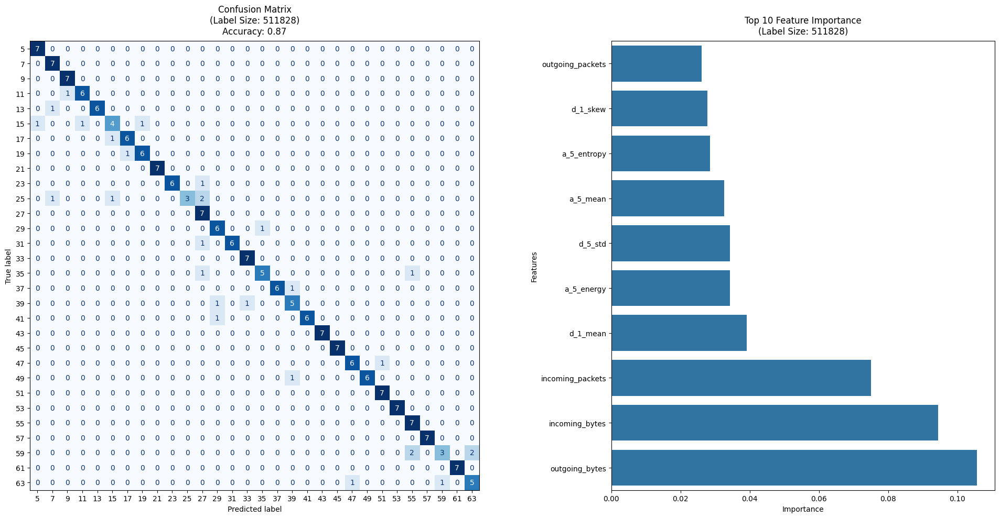

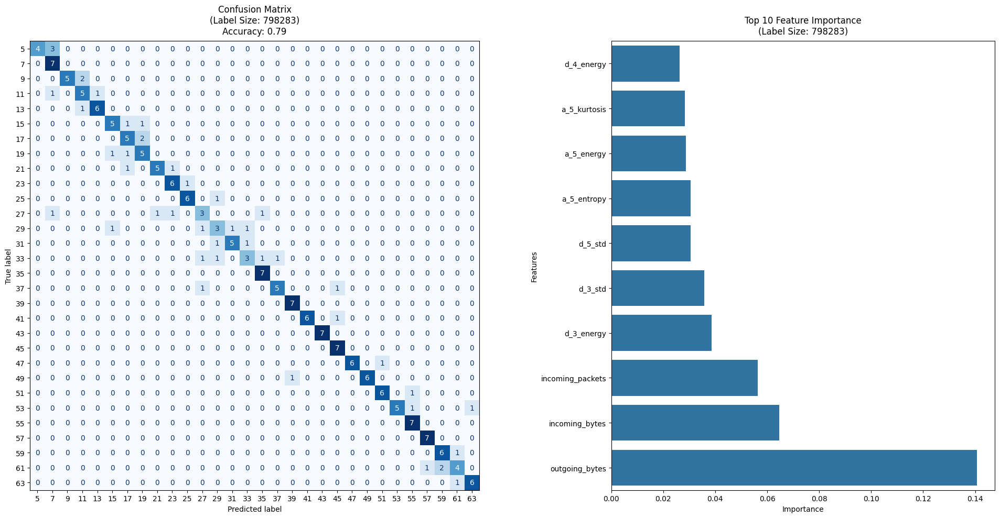

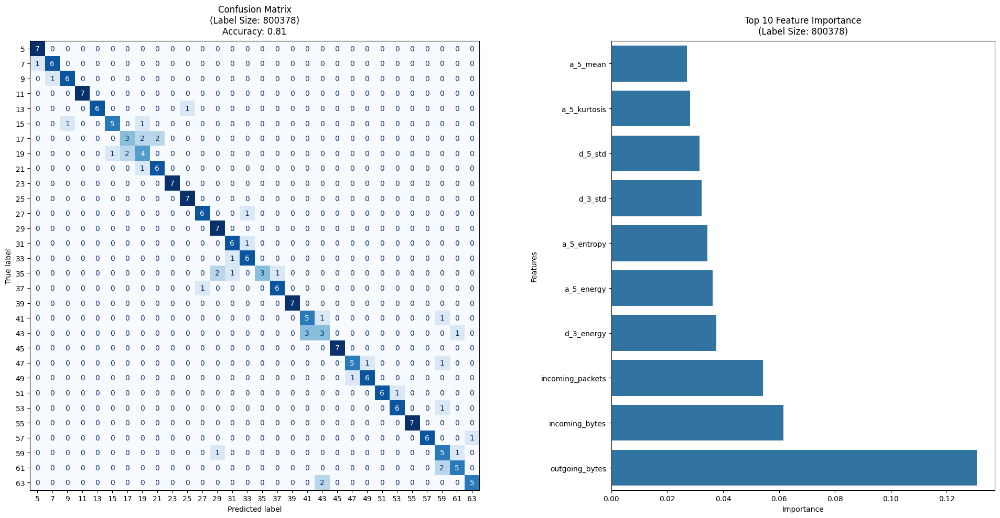

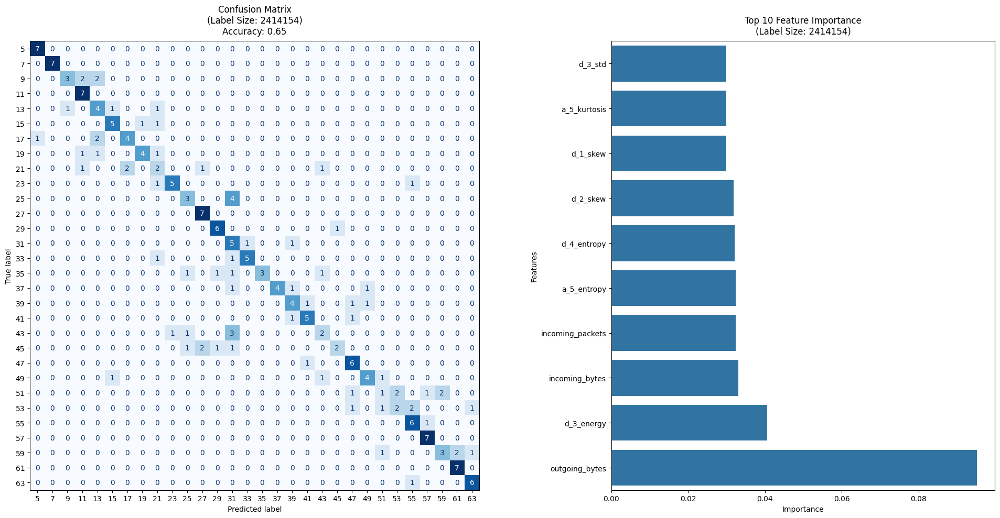

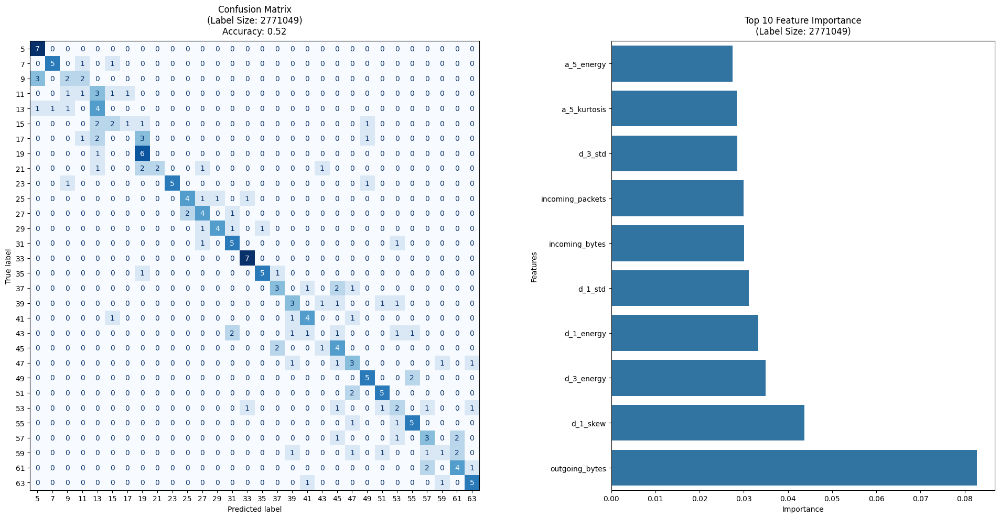

...

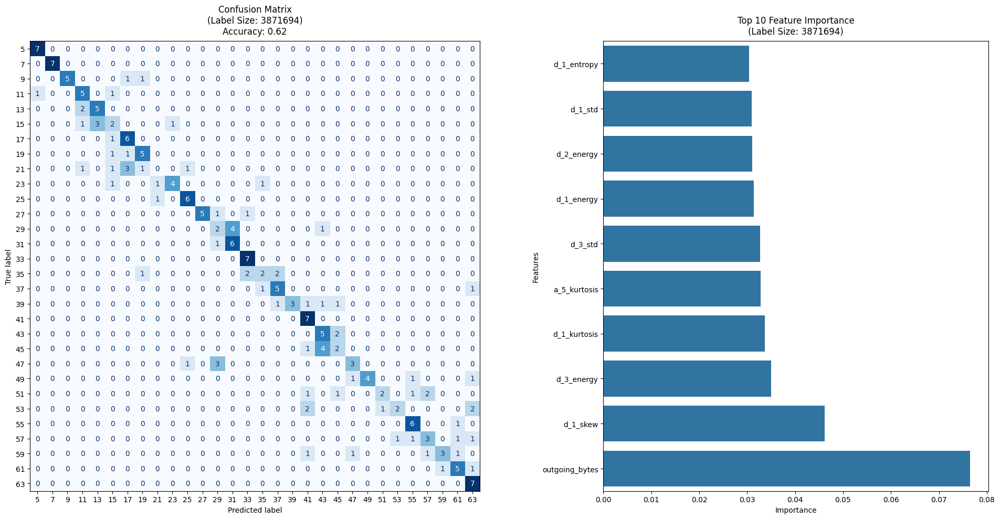

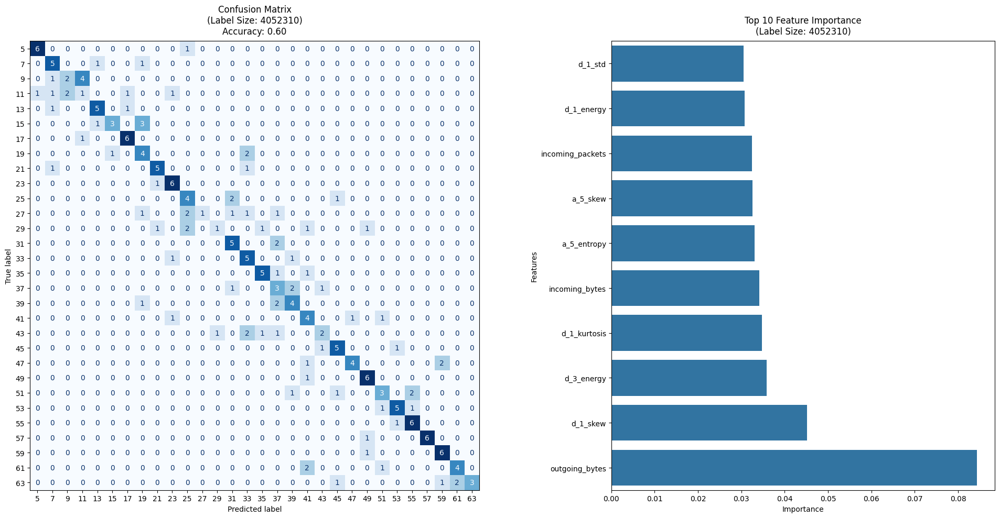

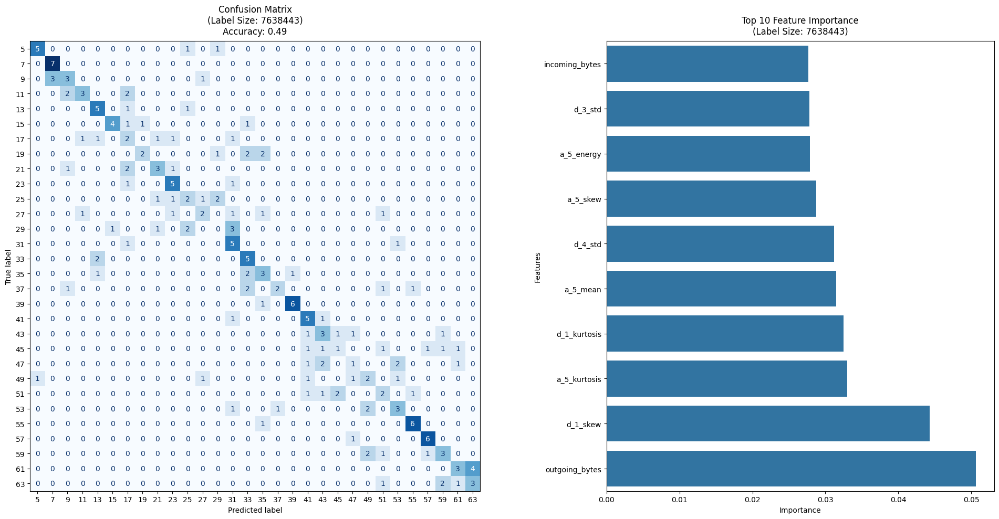

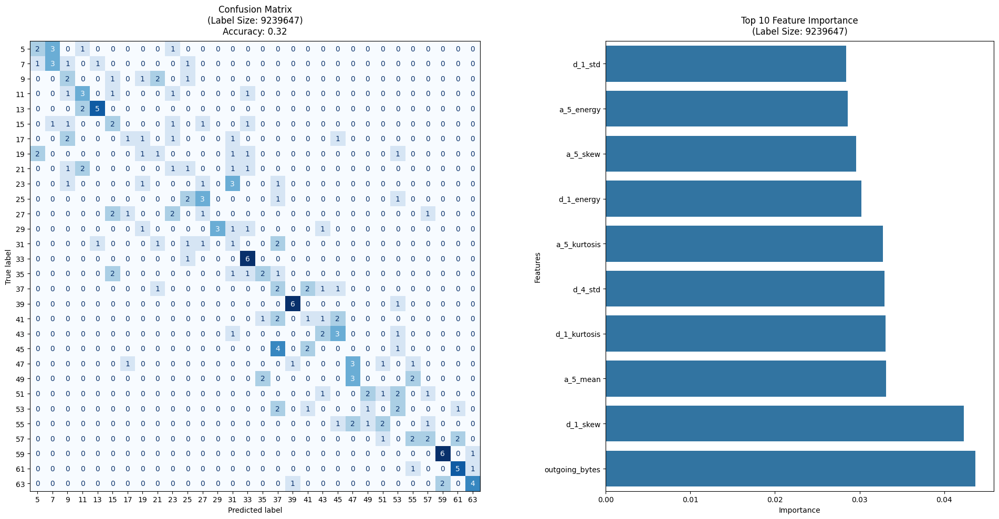

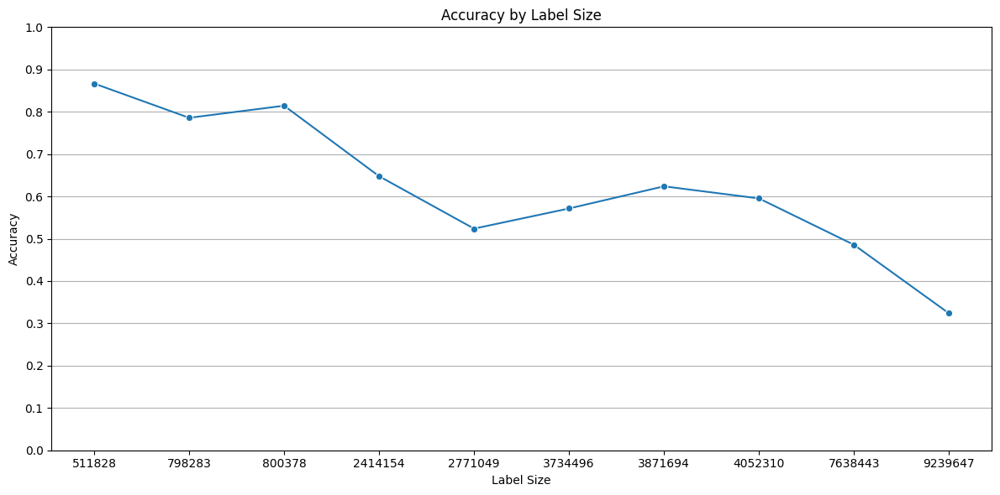

In [288]:
from matplotlib.gridspec import GridSpec

all_metrics = []

label_sizes = sorted(wavelets['label_size'].unique())
for label_size in label_sizes:
    subset = wavelets[wavelets['label_size'] == label_size].reset_index(drop=True)

    X_wavelets = subset.drop(["label_imgs", "label_size", "label"], axis=1)
    y = subset["label_imgs"].reset_index(drop=True).astype(str)
    
    X_train, X_test, y_train, y_test = train_test_split(X_wavelets, y, test_size=0.2, random_state=42, stratify=y)
    
    pipe = Pipeline([
        ('scaler', StandardScaler()),
        ('rf', RandomForestClassifier(n_estimators=200, random_state=42))
    ])
    
    pipe.fit(X_train, y_train)
    
    y_pred = pipe.predict(X_test)
    y_pred_proba = pipe.predict_proba(X_test)
    
    accuracy = accuracy_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred, average='weighted', zero_division=0)
    recall = recall_score(y_test, y_pred, average='weighted', zero_division=0)
    f1 = f1_score(y_test, y_pred, average='weighted', zero_division=0)
    
    y_test_bin = label_binarize(y_test, classes=pipe.classes_)
    roc_auc = roc_auc_score(y_test_bin, y_pred_proba, multi_class='ovr', average='weighted')

    metrics = {
        'Label Size': label_size,
        'Accuracy': accuracy,
        'Precision': precision,
        'Recall': recall,
        'F1-Score': f1,
        'ROC-AUC': roc_auc
    }
    all_metrics.append(metrics)

    fig = plt.figure(figsize=(20, 10))
    gs = GridSpec(1, 2, width_ratios=[3, 2], figure=fig)

    # Confusion Matrix (wider)
    ax0 = fig.add_subplot(gs[0])
    cm = confusion_matrix(y_test, y_pred)
    sorted_classes = sorted(pipe.classes_, key=int)
    idx = [list(pipe.classes_).index(c) for c in sorted_classes]
    cm_sorted = cm[idx, :][:, idx]
    disp = ConfusionMatrixDisplay(confusion_matrix=cm_sorted, display_labels=sorted_classes)
    disp.plot(cmap='Blues', values_format='.0f', ax=ax0, colorbar=False)
    ax0.set_title(f'Confusion Matrix\n(Label Size: {label_size})\nAccuracy: {accuracy:.2f}', pad=10)

    # Feature Importance
    ax1 = fig.add_subplot(gs[1])
    feature_importance = pipe.named_steps['rf'].feature_importances_
    feature_names = X_wavelets.columns
    sorted_idx = np.argsort(feature_importance)[-10:]  # Top 10 features
    sns.barplot(x=feature_importance[sorted_idx], y=feature_names[sorted_idx], ax=ax1)
    ax1.set_title(f'Top 10 Feature Importance\n(Label Size: {label_size})', pad=10)
    ax1.set_xlabel('Importance')
    ax1.set_ylabel("Features")

    plt.tight_layout()
    plt.show()
    

wavelet_metrics = pd.DataFrame(all_metrics)
plt.figure(figsize=(12, 6))
sns.lineplot(x=wavelet_metrics["Label Size"].astype(str), y=wavelet_metrics["Accuracy"], marker='o')
plt.title("Accuracy by Label Size")
plt.xlabel("Label Size")
plt.ylabel("Accuracy")
plt.ylim(0, 1)
plt.yticks(np.arange(0, 1.1, 0.1))
plt.grid(axis='y')
plt.tight_layout()
plt.show()

In [289]:
wavelets2 = df[["incoming_packets", "incoming_bytes", "outgoing_packets", "outgoing_bytes", "label", "label_size", "label_imgs"]].copy()
wavelets2_features = pd.json_normalize(df["wavelet_features2"])
wavelets2 = pd.concat([wavelets2.reset_index(drop=True), wavelets2_features.reset_index(drop=True)], axis=1)
wavelets2.head()

,incoming_packets,incoming_bytes,outgoing_packets,outgoing_bytes,label,label_size,label_imgs,db4_a_5_energy,db4_a_5_mean,db4_a_5_std,...,haar_d_4_std,haar_d_4_kurtosis,haar_d_4_skew,haar_d_4_entropy,haar_d_5_energy,haar_d_5_mean,haar_d_5_std,haar_d_5_kurtosis,haar_d_5_skew,haar_d_5_entropy
0,433,565410,179,61737,511828_57_0000,511828,57,4.890315e+08,3165.383756,3088.948647,...,779.184455,0.048406,-0.335262,6.590034,109662677.5,24.797264,598.130302,1.078601,-0.769324,6.922273
1,549,769807,217,35657,4052310_35_0000,4052310,35,8.043528e+08,4085.678875,3181.035955,...,645.347159,0.132661,-0.326030,6.728877,219816236.0,53.806580,755.670287,-0.733715,-0.175647,7.601329
2,257,330534,132,29333,511828_25_0000,511828,25,2.969850e+08,2372.630015,3296.937025,...,724.059226,-0.081009,-0.298633,6.016142,110733235.5,-30.420096,752.952431,-0.376167,0.027375,6.641330
3,1148,1644128,424,66503,9239647_47_0000,9239647,47,1.720332e+09,4984.220892,2536.987172,...,672.353199,0.176561,-0.283838,7.845772,462533117.5,7.426420,767.078467,-0.766017,-0.080895,8.630043
4,1397,2010601,491,81197,7638443_61_0000,7638443,61,2.096140e+09,5097.115021,2503.541969,...,685.056628,0.836237,0.006310,8.022145,547110244.0,-10.269528,761.223012,-0.669409,-0.120441,8.851866


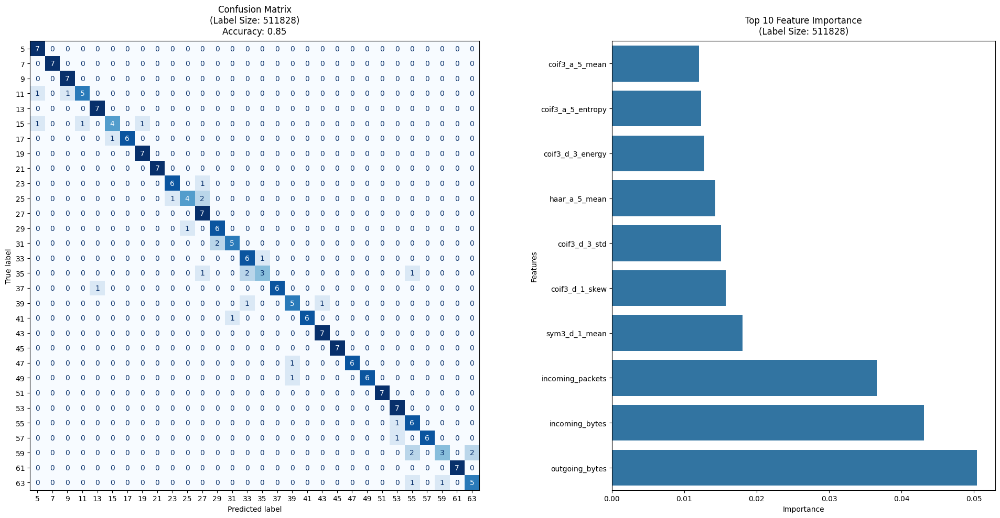

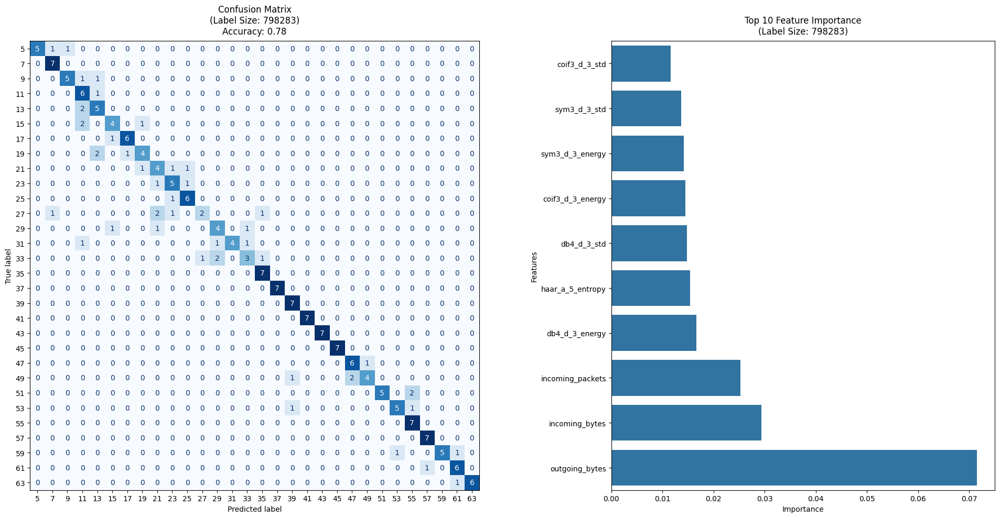

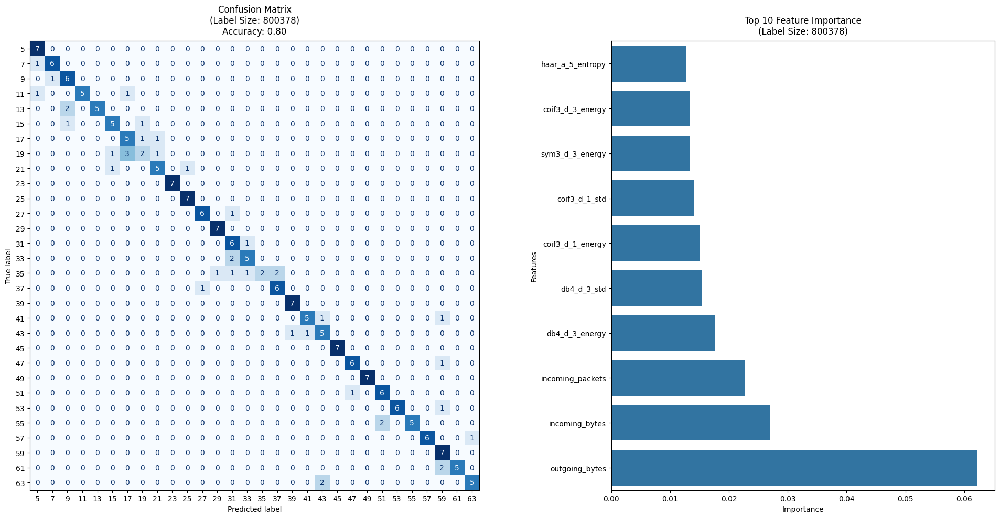

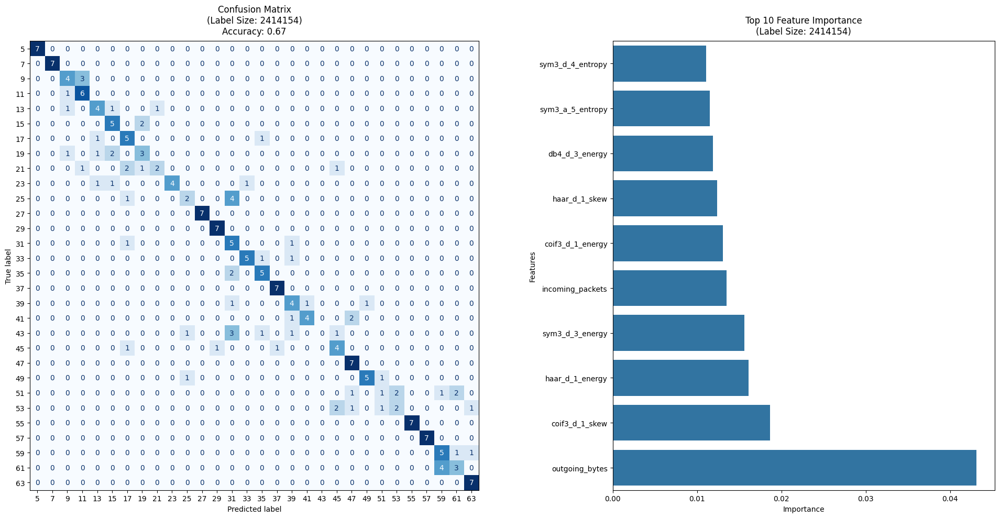

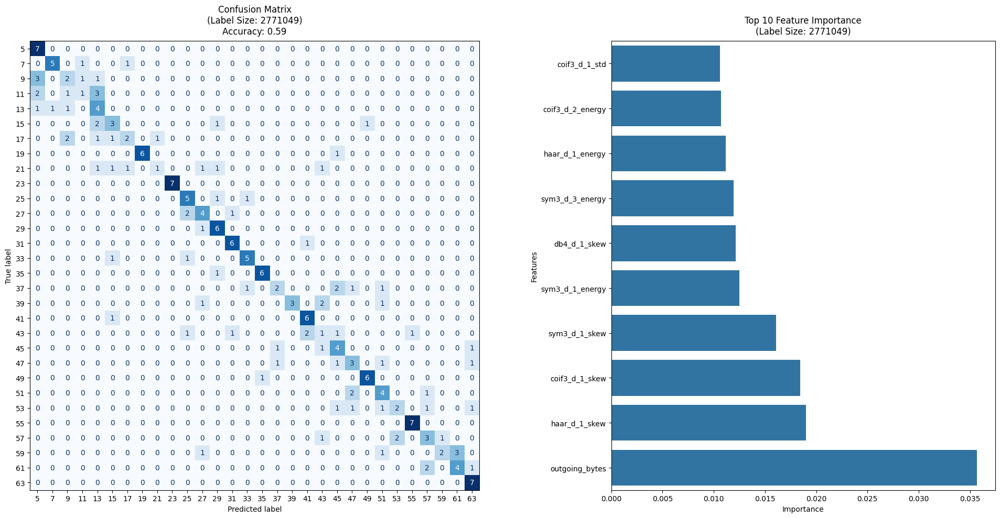

...

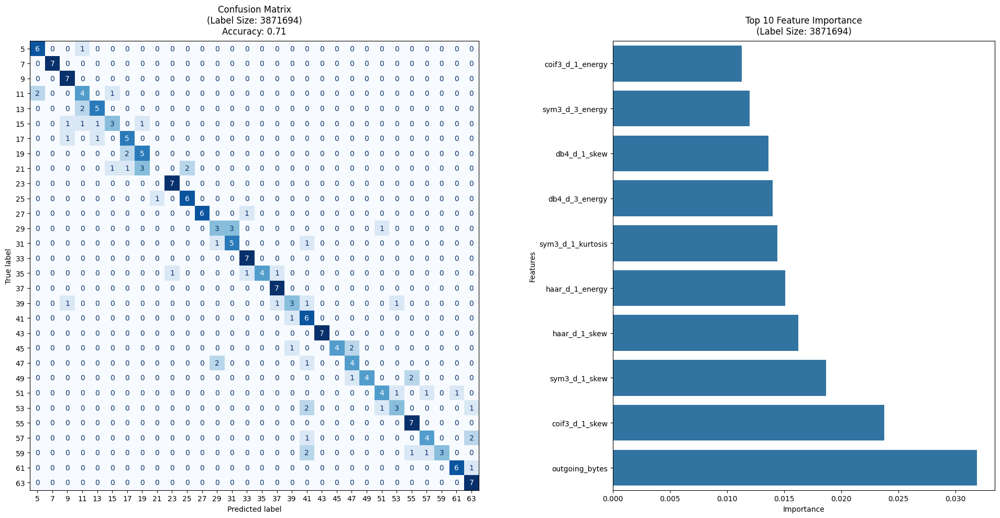

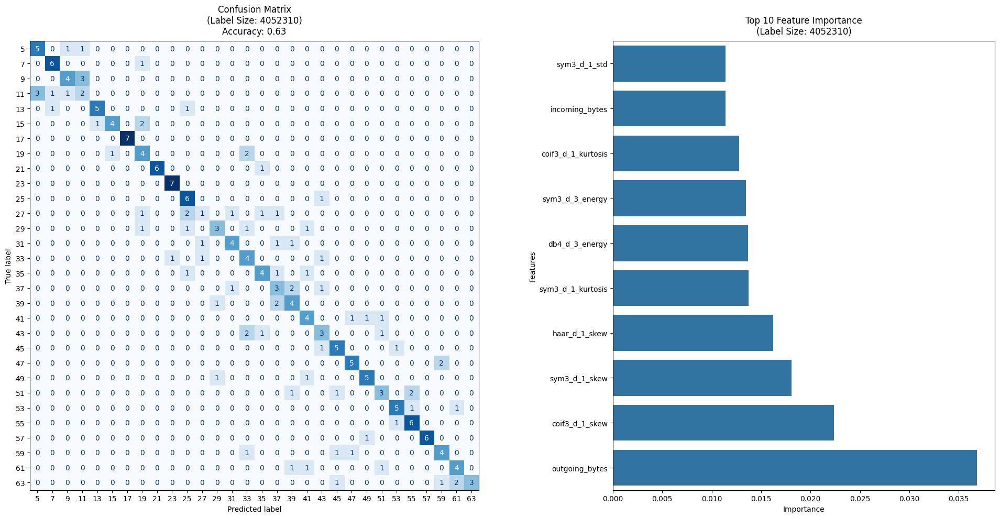

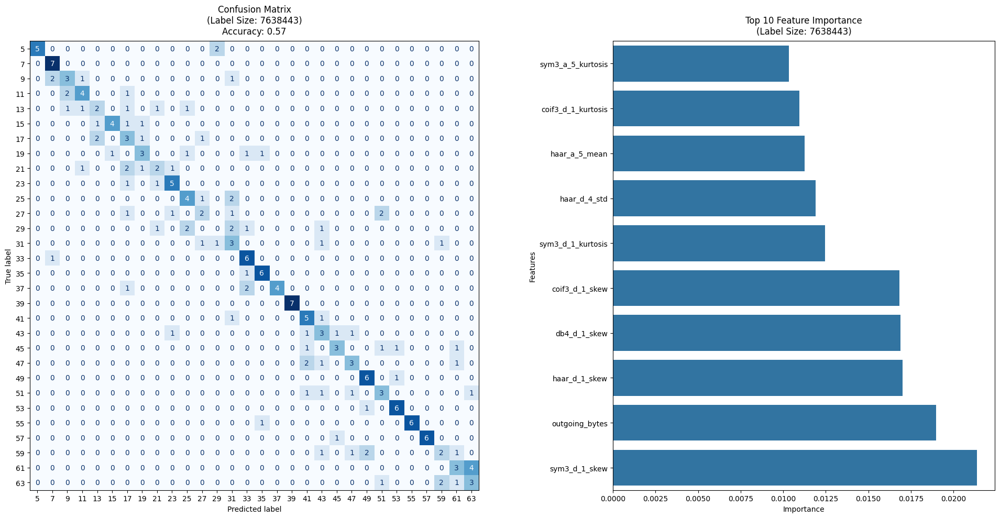

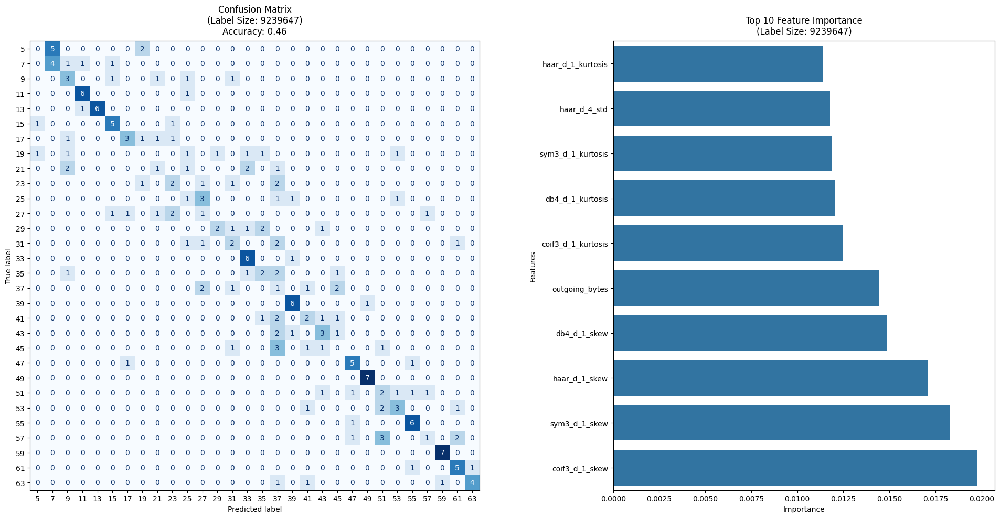

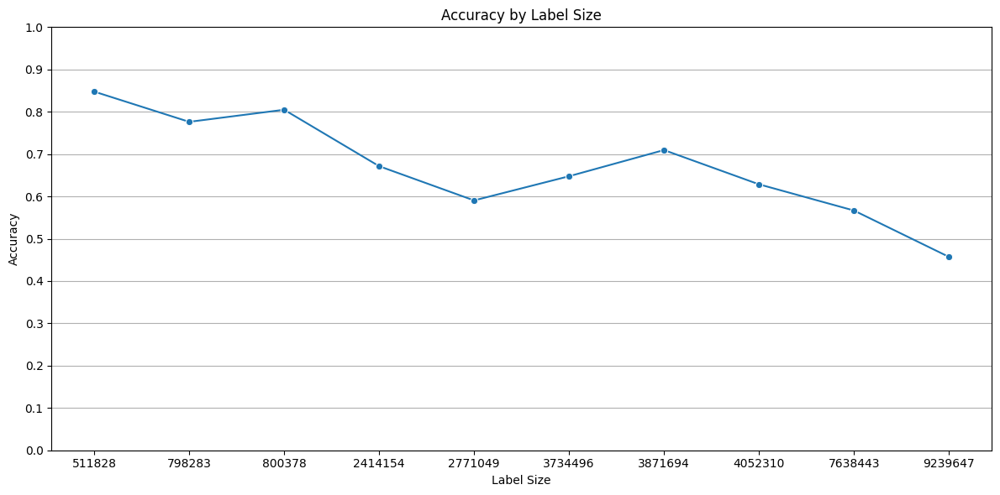

In [290]:
all_metrics = []

label_sizes = sorted(wavelets2['label_size'].unique())
for label_size in label_sizes:
    subset = wavelets2[wavelets2['label_size'] == label_size].reset_index(drop=True)

    X_wavelets2 = subset.drop(["label_imgs", "label_size", "label"], axis=1)
    y = subset["label_imgs"].reset_index(drop=True).astype(str)
    
    X_train, X_test, y_train, y_test = train_test_split(X_wavelets2, y, test_size=0.2, random_state=42, stratify=y)
    
    pipe = Pipeline([
        ('scaler', StandardScaler()),
        ('rf', RandomForestClassifier(n_estimators=200, random_state=42))
    ])
    
    pipe.fit(X_train, y_train)
    
    y_pred = pipe.predict(X_test)
    y_pred_proba = pipe.predict_proba(X_test)
    
    accuracy = accuracy_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred, average='weighted', zero_division=0)
    recall = recall_score(y_test, y_pred, average='weighted', zero_division=0)
    f1 = f1_score(y_test, y_pred, average='weighted', zero_division=0)
    
    y_test_bin = label_binarize(y_test, classes=pipe.classes_)
    roc_auc = roc_auc_score(y_test_bin, y_pred_proba, multi_class='ovr', average='weighted')

    metrics = {
        'Label Size': label_size,
        'Accuracy': accuracy,
        'Precision': precision,
        'Recall': recall,
        'F1-Score': f1,
        'ROC-AUC': roc_auc
    }
    all_metrics.append(metrics)

    fig = plt.figure(figsize=(20, 10))
    gs = GridSpec(1, 2, width_ratios=[3, 2], figure=fig)

    # Confusion Matrix (wider)
    ax0 = fig.add_subplot(gs[0])
    cm = confusion_matrix(y_test, y_pred)
    sorted_classes = sorted(pipe.classes_, key=int)
    idx = [list(pipe.classes_).index(c) for c in sorted_classes]
    cm_sorted = cm[idx, :][:, idx]
    disp = ConfusionMatrixDisplay(confusion_matrix=cm_sorted, display_labels=sorted_classes)
    disp.plot(cmap='Blues', values_format='.0f', ax=ax0, colorbar=False)
    ax0.set_title(f'Confusion Matrix\n(Label Size: {label_size})\nAccuracy: {accuracy:.2f}', pad=10)

    # Feature Importance
    ax1 = fig.add_subplot(gs[1])
    feature_importance = pipe.named_steps['rf'].feature_importances_
    feature_names = X_wavelets2.columns
    sorted_idx = np.argsort(feature_importance)[-10:]  # Top 10 features
    sns.barplot(x=feature_importance[sorted_idx], y=feature_names[sorted_idx], ax=ax1)
    ax1.set_title(f'Top 10 Feature Importance\n(Label Size: {label_size})', pad=10)
    ax1.set_xlabel('Importance')
    ax1.set_ylabel("Features")

    plt.tight_layout()
    plt.show()
    

wavelet2_metrics = pd.DataFrame(all_metrics)
plt.figure(figsize=(12, 6))
sns.lineplot(x=wavelet2_metrics["Label Size"].astype(str), y=wavelet2_metrics["Accuracy"], marker='o')
plt.title("Accuracy by Label Size")
plt.xlabel("Label Size")
plt.ylabel("Accuracy")
plt.ylim(0, 1)
plt.yticks(np.arange(0, 1.1, 0.1))
plt.grid(axis='y')
plt.tight_layout()
plt.show()

CUMUL + WAVELETS

In [291]:
cumul = df[["cumul_interpolated", "incoming_packets", "incoming_bytes", "outgoing_packets", "outgoing_bytes", "label", "label_size", "label_imgs"]].copy()
cumul.head()

wavelets_features = pd.json_normalize(df["wavelet_features"])
wavelets_features.head()

cumul_wavelets = pd.concat([cumul.reset_index(drop=True), wavelets_features.reset_index(drop=True)], axis=1)
cumul_wavelets.head()

,cumul_interpolated,incoming_packets,incoming_bytes,outgoing_packets,outgoing_bytes,label,label_size,label_imgs,a_5_energy,a_5_mean,...,d_4_std,d_4_kurtosis,d_4_skew,d_4_entropy,d_5_energy,d_5_mean,d_5_std,d_5_kurtosis,d_5_skew,d_5_entropy
0,"[-74, -1942, -2207, -2639, -1457, 11, 5271, 11...",433,565410,179,61737,511828_57_0000,511828,57,4.630159e+08,3764.896682,...,712.833615,-0.115805,-0.154152,6.827800,8.728545e+07,24.563186,531.780932,1.037211,-0.413579,7.577997
1,"[-74, -3066, -2337, -1615, -24, 7669, 17789, 1...",549,769807,217,35657,4052310_35_0000,4052310,35,7.938692e+08,4613.103352,...,586.327974,0.282061,-0.263418,7.101185,2.343784e+08,53.626853,778.395345,-0.439511,-0.822129,8.054928
2,"[-74, -1532, -3298, -2647, -2297, -865, -1721,...",257,330534,132,29333,511828_25_0000,511828,25,2.768888e+08,2961.622120,...,581.950380,0.004587,-0.114922,6.157981,1.223779e+08,-29.804413,787.603370,-0.741200,-0.477126,7.152912
3,"[-74, -2317, -692, 17934, 30513, 48828, 59991,...",1148,1644128,424,66503,9239647_47_0000,9239647,47,1.717510e+09,5283.409248,...,578.738929,0.911780,-0.353833,8.159434,5.244419e+08,6.518589,815.777525,-0.771020,-0.679057,9.147229
4,"[-74, -2919, 5342, 27879, 46577, 73847, 102705...",1397,2010601,491,81197,7638443_61_0000,7638443,61,2.071026e+09,5390.452690,...,665.715167,0.850643,-0.652519,8.418182,5.671361e+08,-10.786784,774.204921,-0.678885,-0.664376,9.362968


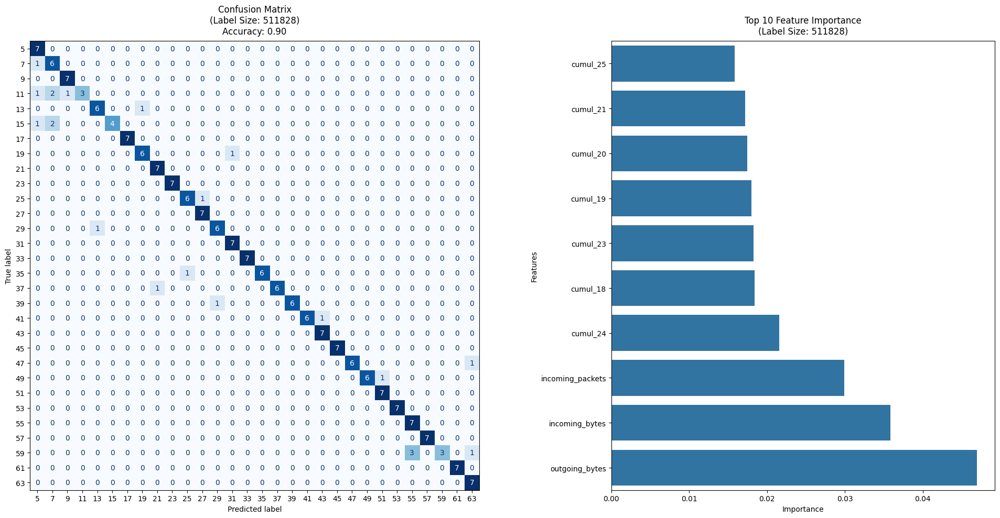

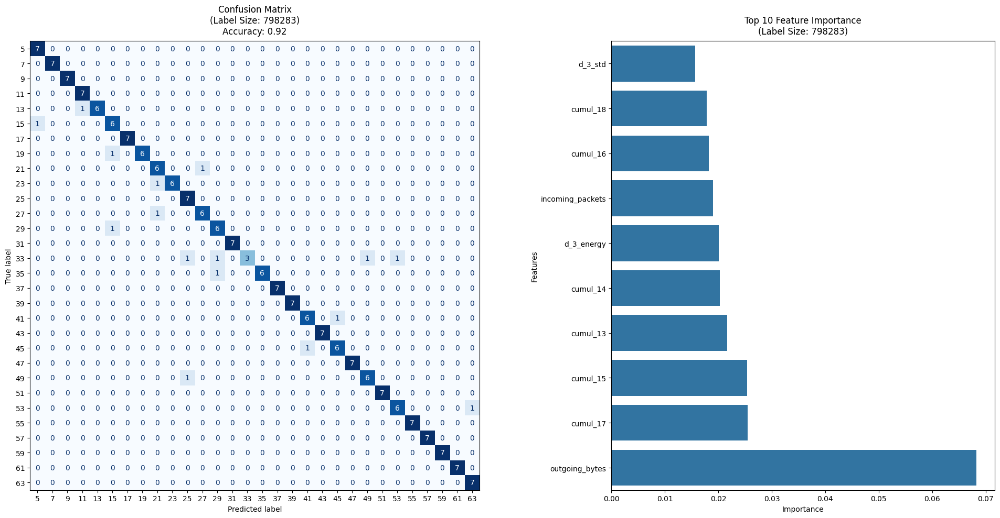

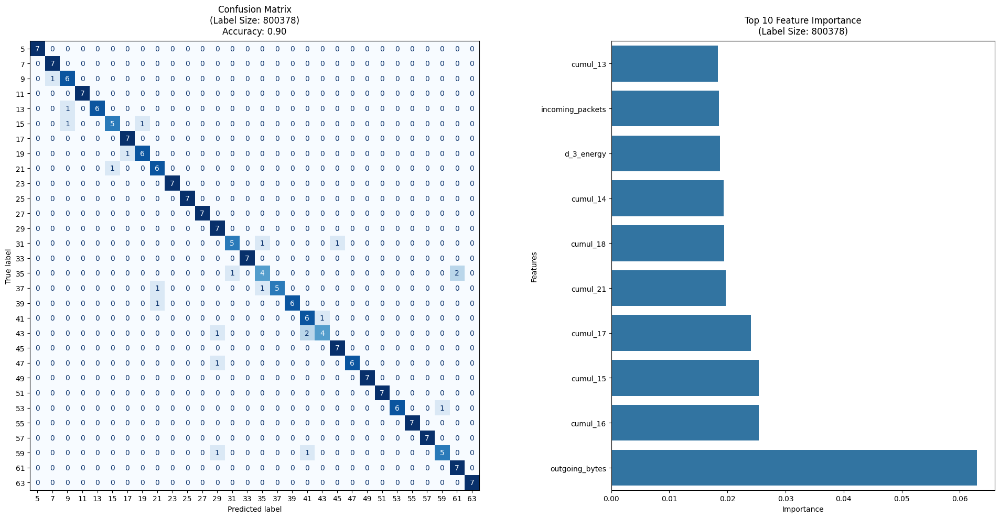

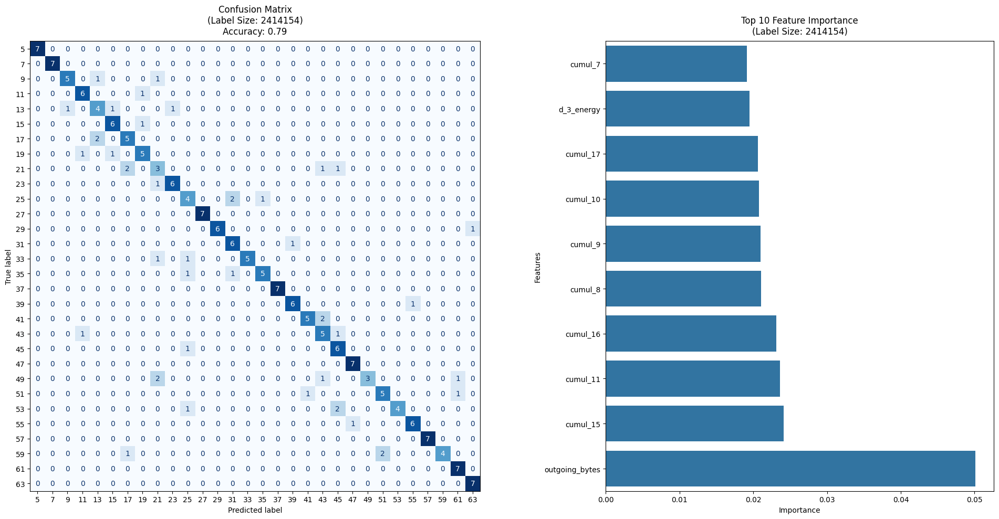

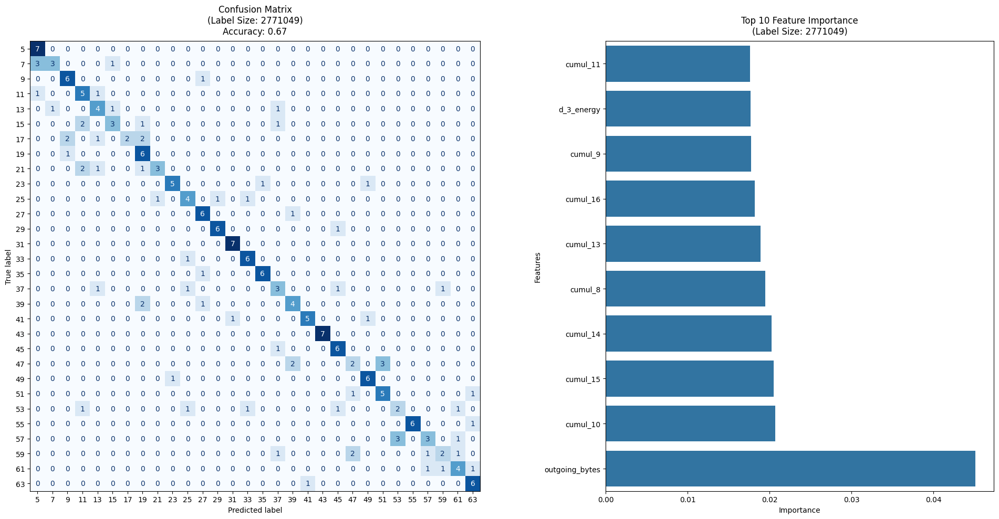

...

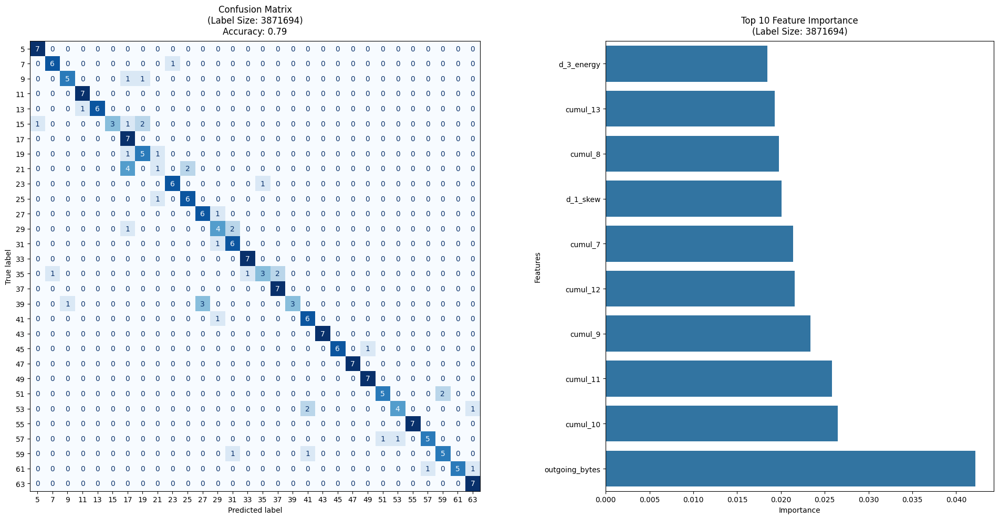

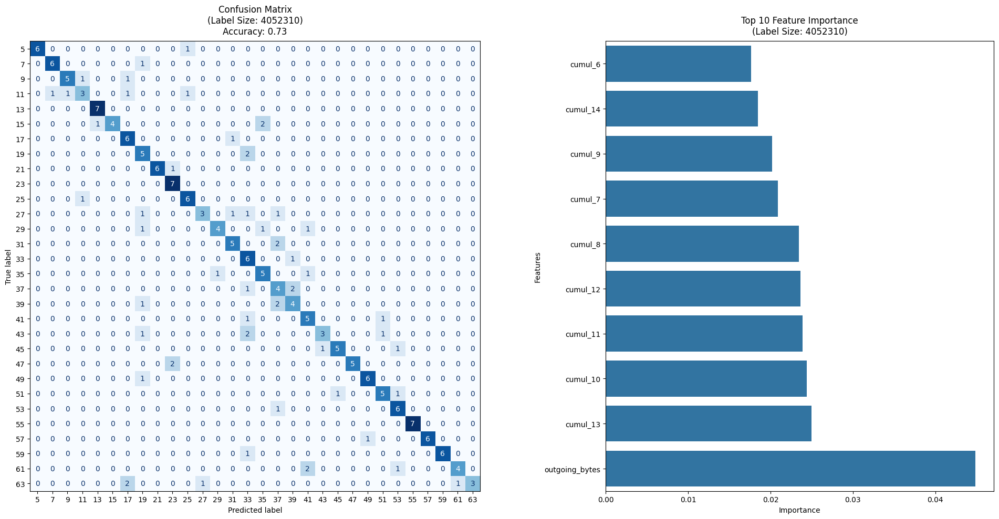

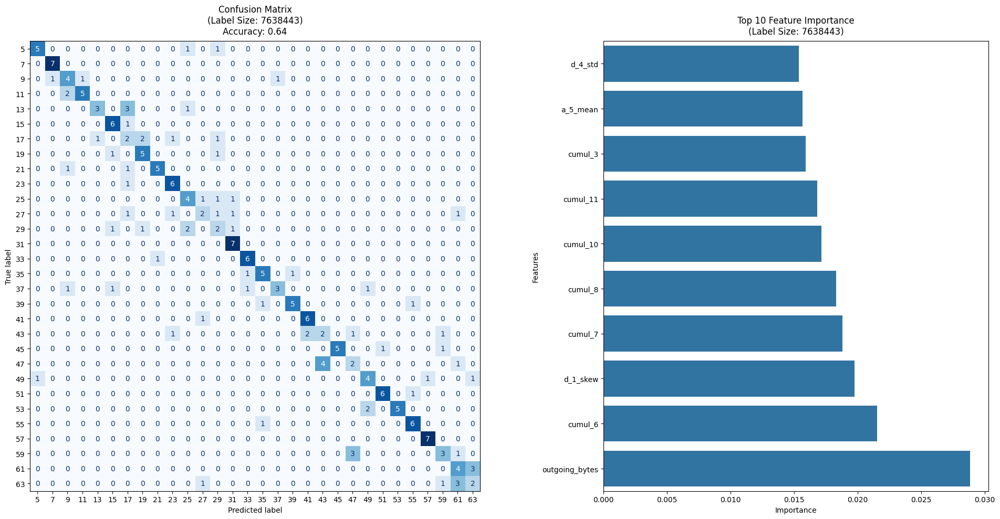

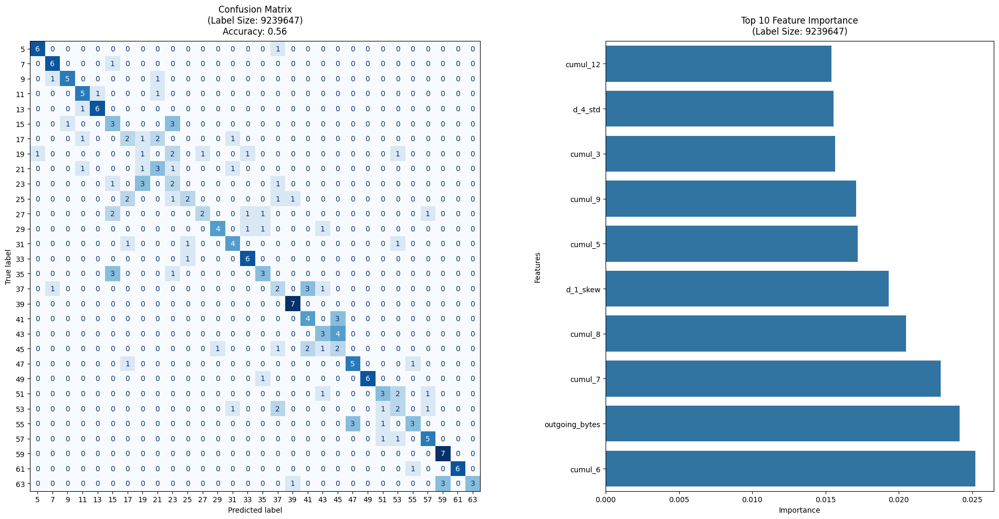

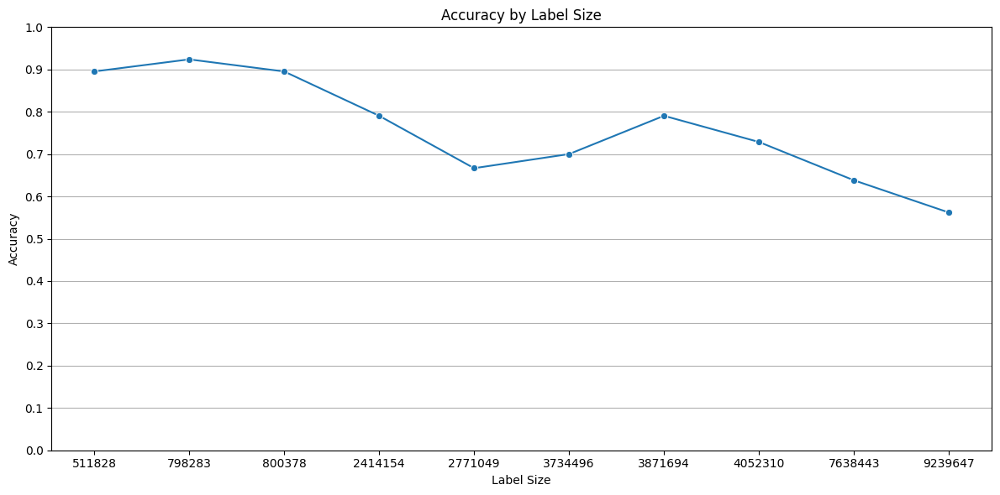

In [292]:
all_metrics = []

label_sizes = sorted(cumul_wavelets['label_size'].unique())
for label_size in label_sizes:
    subset = cumul_wavelets[cumul_wavelets['label_size'] == label_size].reset_index(drop=True)

    X_cumul_wavelets = pd.concat([subset.drop(["cumul_interpolated", "label_size", "label_imgs", "label"], axis=1).reset_index(drop=True), pd.DataFrame(subset["cumul_interpolated"].tolist(), columns=[f"cumul_{i}" for i in range(100)])], axis=1)
    y = subset["label_imgs"].reset_index(drop=True).astype(str)
    
    X_train, X_test, y_train, y_test = train_test_split(X_cumul_wavelets, y, test_size=0.2, random_state=42, stratify=y)
    
    pipe = Pipeline([
        ('scaler', StandardScaler()),
        ('rf', RandomForestClassifier(n_estimators=200, random_state=42))
    ])
    
    pipe.fit(X_train, y_train)
    
    y_pred = pipe.predict(X_test)
    y_pred_proba = pipe.predict_proba(X_test)
    
    accuracy = accuracy_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred, average='weighted', zero_division=0)
    recall = recall_score(y_test, y_pred, average='weighted', zero_division=0)
    f1 = f1_score(y_test, y_pred, average='weighted', zero_division=0)
    
    y_test_bin = label_binarize(y_test, classes=pipe.classes_)
    roc_auc = roc_auc_score(y_test_bin, y_pred_proba, multi_class='ovr', average='weighted')

    metrics = {
        'Label Size': label_size,
        'Accuracy': accuracy,
        'Precision': precision,
        'Recall': recall,
        'F1-Score': f1,
        'ROC-AUC': roc_auc
    }
    all_metrics.append(metrics)

    fig = plt.figure(figsize=(20, 10))
    gs = GridSpec(1, 2, width_ratios=[3, 2], figure=fig)

    # Confusion Matrix (wider)
    ax0 = fig.add_subplot(gs[0])
    cm = confusion_matrix(y_test, y_pred)
    sorted_classes = sorted(pipe.classes_, key=int)
    idx = [list(pipe.classes_).index(c) for c in sorted_classes]
    cm_sorted = cm[idx, :][:, idx]
    disp = ConfusionMatrixDisplay(confusion_matrix=cm_sorted, display_labels=sorted_classes)
    disp.plot(cmap='Blues', values_format='.0f', ax=ax0, colorbar=False)
    ax0.set_title(f'Confusion Matrix\n(Label Size: {label_size})\nAccuracy: {accuracy:.2f}', pad=10)

    # Feature Importance
    ax1 = fig.add_subplot(gs[1])
    feature_importance = pipe.named_steps['rf'].feature_importances_
    feature_names = X_cumul_wavelets.columns
    sorted_idx = np.argsort(feature_importance)[-10:]  # Top 10 features
    sns.barplot(x=feature_importance[sorted_idx], y=feature_names[sorted_idx], ax=ax1)
    ax1.set_title(f'Top 10 Feature Importance\n(Label Size: {label_size})', pad=10)
    ax1.set_xlabel('Importance')
    ax1.set_ylabel("Features")

    plt.tight_layout()
    plt.show()
    
cumul_wavelets_metrics = pd.DataFrame(all_metrics)
plt.figure(figsize=(12, 6))
sns.lineplot(x=cumul_wavelets_metrics["Label Size"].astype(str), y=cumul_wavelets_metrics["Accuracy"], marker='o')
plt.title("Accuracy by Label Size")
plt.xlabel("Label Size")
plt.ylabel("Accuracy")
plt.ylim(0, 1)
plt.yticks(np.arange(0, 1.1, 0.1))
plt.grid(axis='y')
plt.tight_layout()
plt.show()

In [293]:
cumul = df[["cumul_interpolated", "incoming_packets", "incoming_bytes", "outgoing_packets", "outgoing_bytes", "label", "label_size", "label_imgs"]].copy()
cumul.head()

wavelets_features2 = pd.json_normalize(df["wavelet_features2"])
wavelets_features2.head()

cumul_wavelets2 = pd.concat([cumul.reset_index(drop=True), wavelets_features2.reset_index(drop=True)], axis=1)
cumul_wavelets2.head()

,cumul_interpolated,incoming_packets,incoming_bytes,outgoing_packets,outgoing_bytes,label,label_size,label_imgs,db4_a_5_energy,db4_a_5_mean,...,haar_d_4_std,haar_d_4_kurtosis,haar_d_4_skew,haar_d_4_entropy,haar_d_5_energy,haar_d_5_mean,haar_d_5_std,haar_d_5_kurtosis,haar_d_5_skew,haar_d_5_entropy
0,"[-74, -1942, -2207, -2639, -1457, 11, 5271, 11...",433,565410,179,61737,511828_57_0000,511828,57,4.890315e+08,3165.383756,...,779.184455,0.048406,-0.335262,6.590034,109662677.5,24.797264,598.130302,1.078601,-0.769324,6.922273
1,"[-74, -3066, -2337, -1615, -24, 7669, 17789, 1...",549,769807,217,35657,4052310_35_0000,4052310,35,8.043528e+08,4085.678875,...,645.347159,0.132661,-0.326030,6.728877,219816236.0,53.806580,755.670287,-0.733715,-0.175647,7.601329
2,"[-74, -1532, -3298, -2647, -2297, -865, -1721,...",257,330534,132,29333,511828_25_0000,511828,25,2.969850e+08,2372.630015,...,724.059226,-0.081009,-0.298633,6.016142,110733235.5,-30.420096,752.952431,-0.376167,0.027375,6.641330
3,"[-74, -2317, -692, 17934, 30513, 48828, 59991,...",1148,1644128,424,66503,9239647_47_0000,9239647,47,1.720332e+09,4984.220892,...,672.353199,0.176561,-0.283838,7.845772,462533117.5,7.426420,767.078467,-0.766017,-0.080895,8.630043
4,"[-74, -2919, 5342, 27879, 46577, 73847, 102705...",1397,2010601,491,81197,7638443_61_0000,7638443,61,2.096140e+09,5097.115021,...,685.056628,0.836237,0.006310,8.022145,547110244.0,-10.269528,761.223012,-0.669409,-0.120441,8.851866


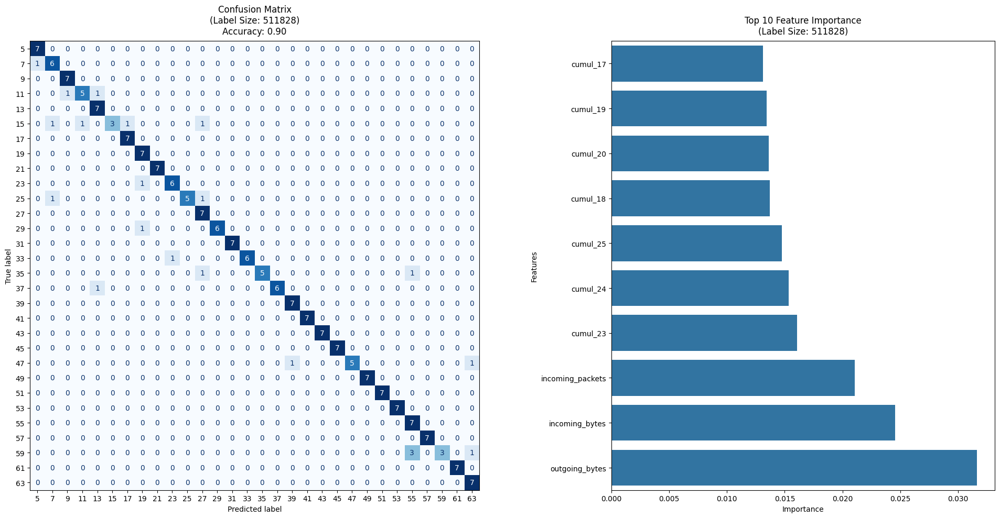

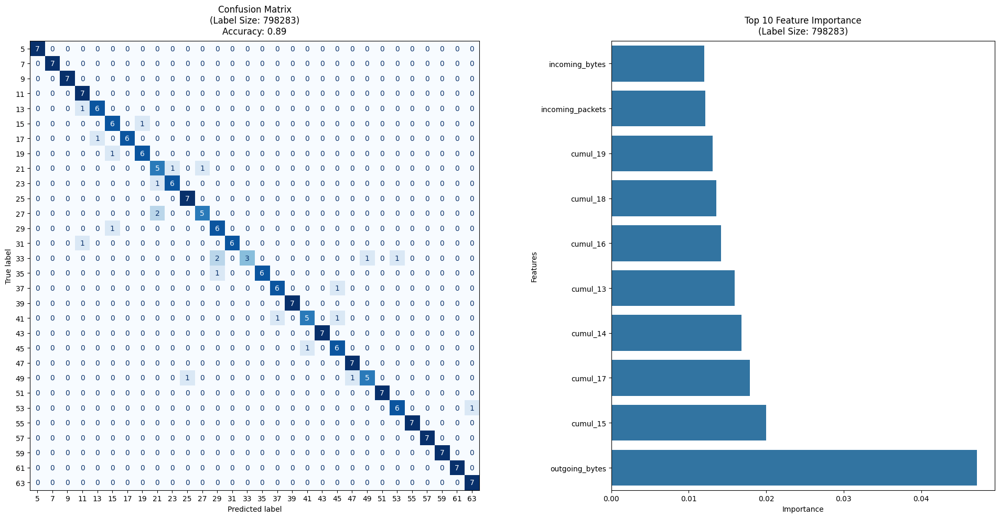

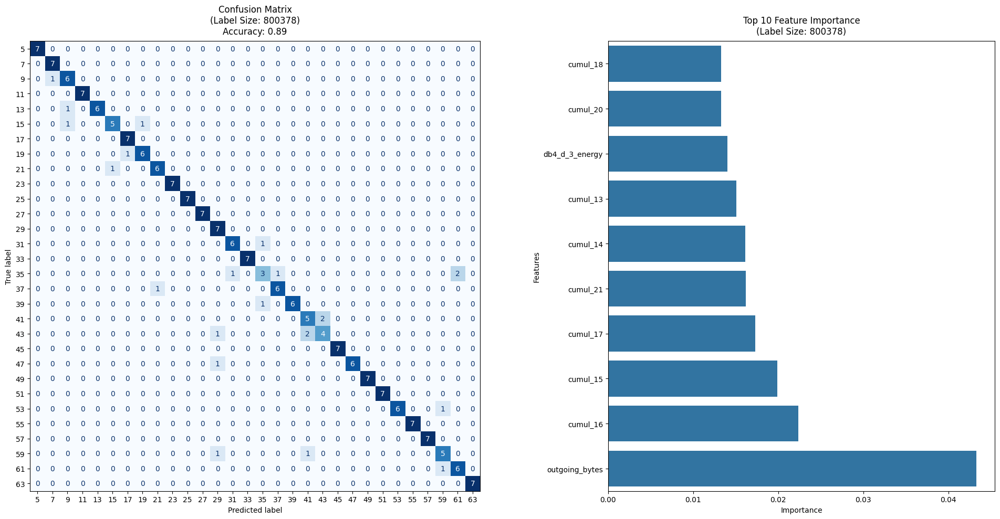

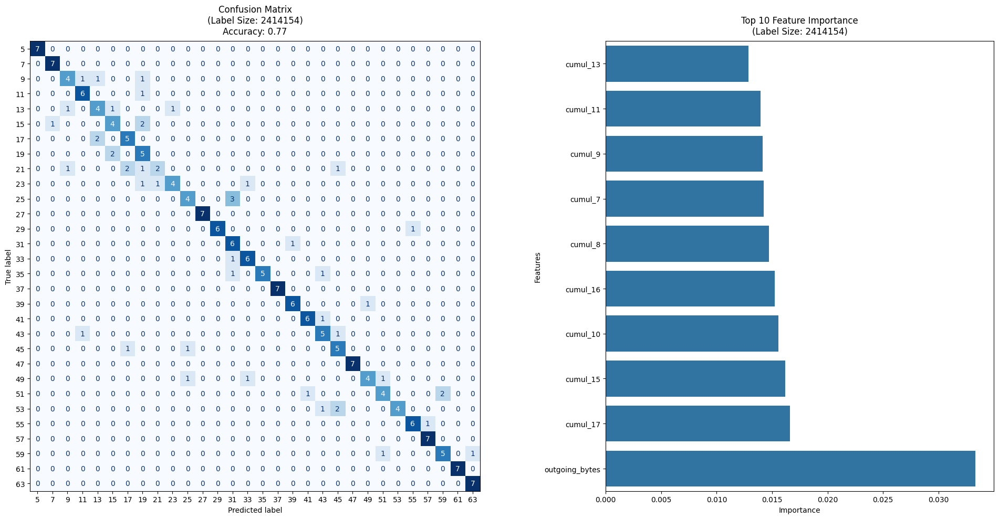

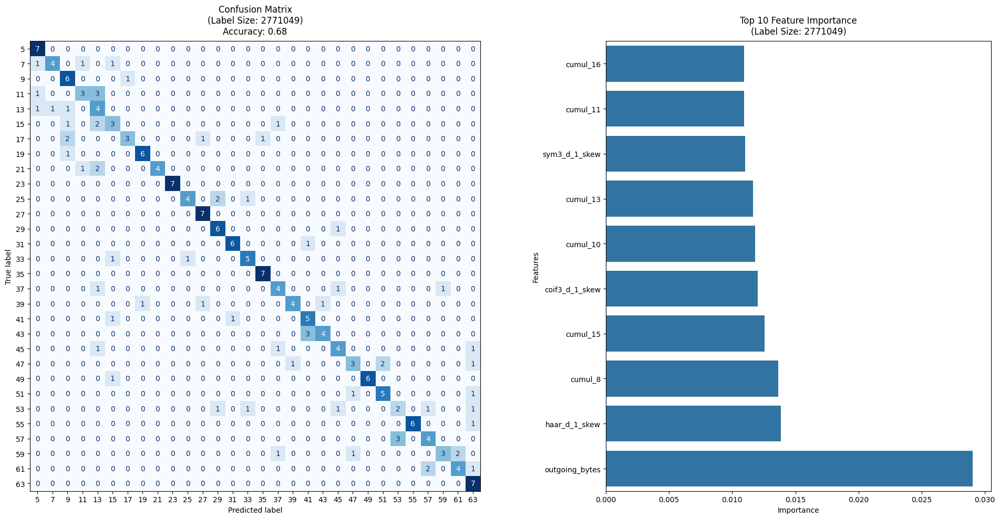

...

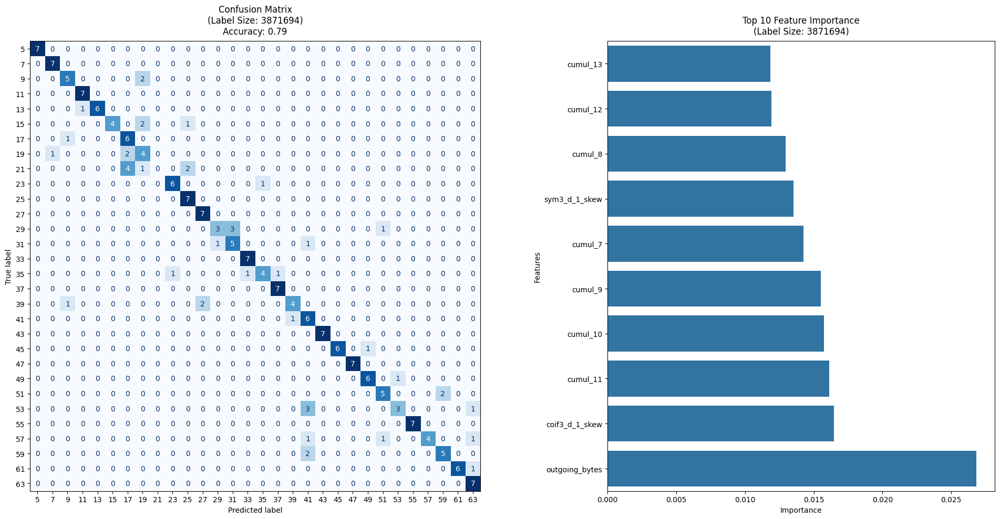

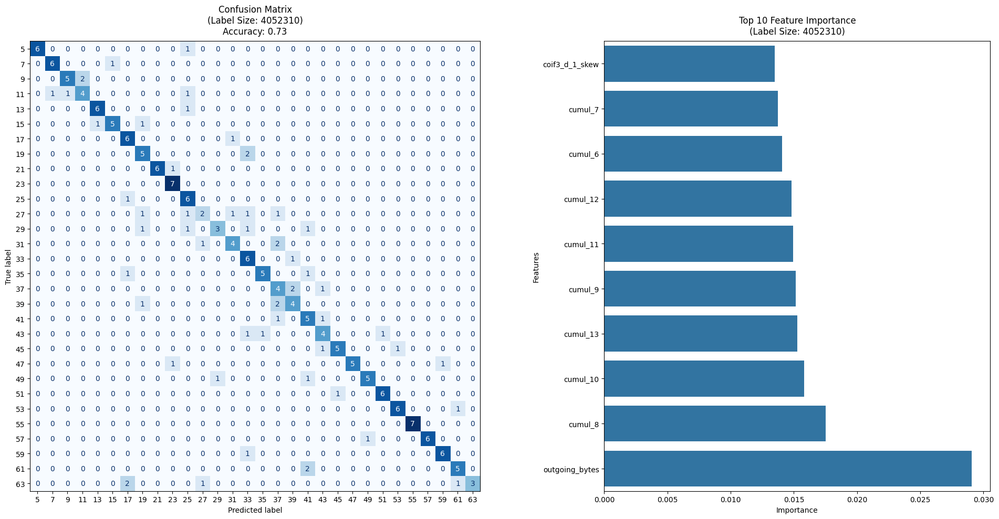

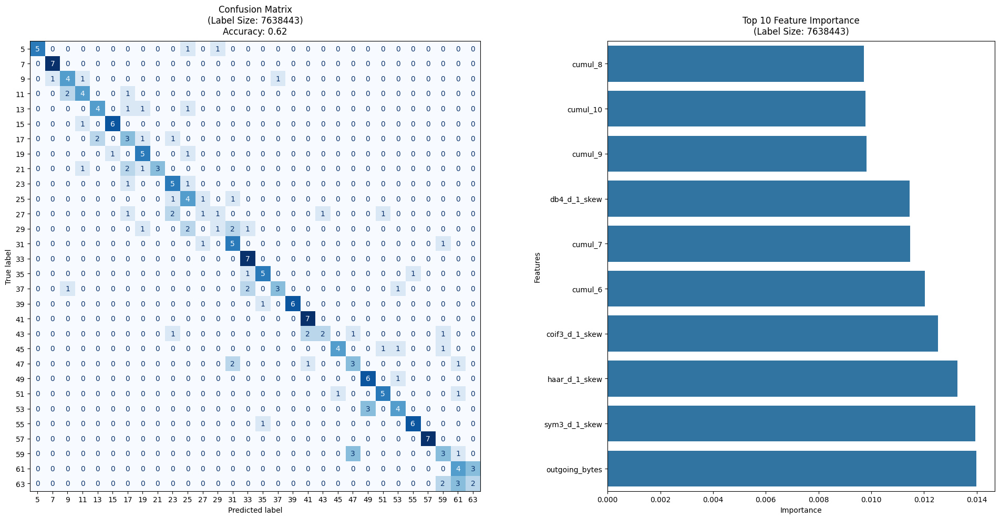

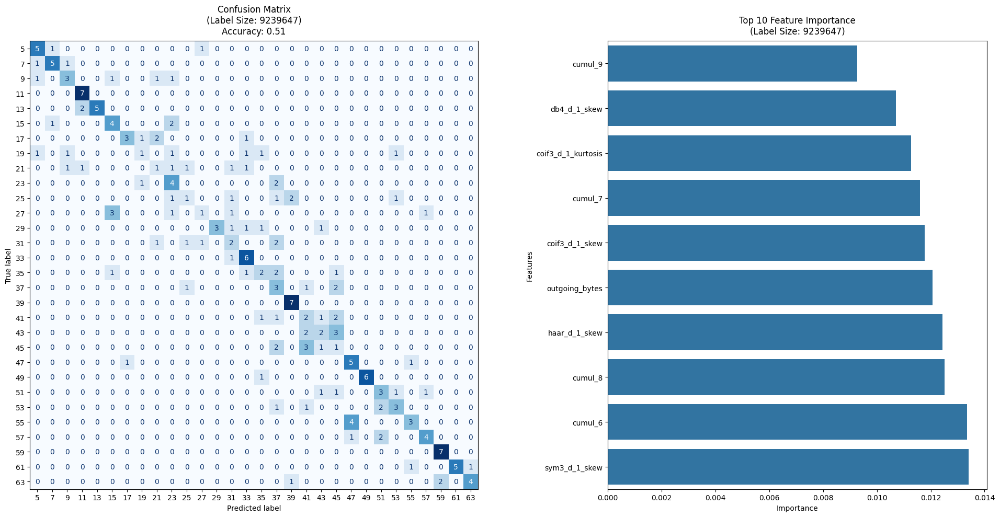

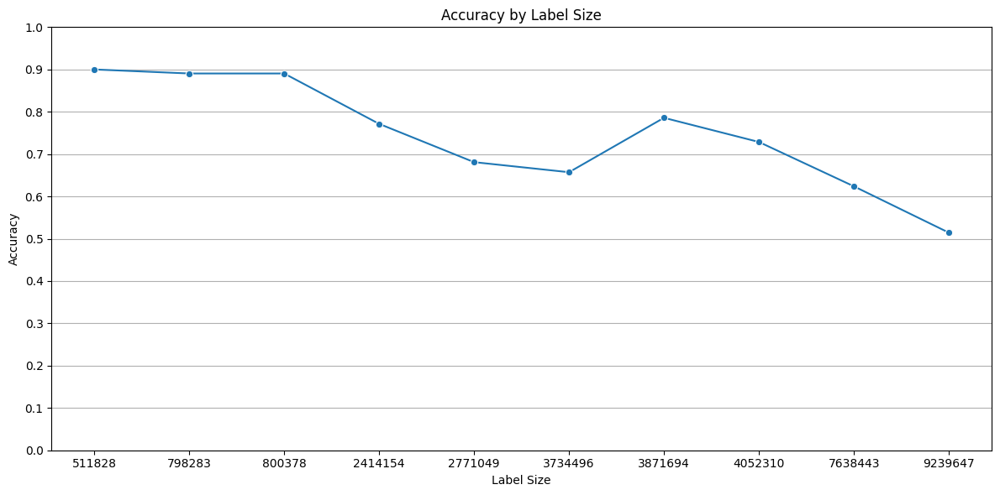

In [294]:
all_metrics = []

label_sizes = sorted(cumul_wavelets2['label_size'].unique())
for label_size in label_sizes:
    subset = cumul_wavelets2[cumul_wavelets2['label_size'] == label_size].reset_index(drop=True)

    X_cumul_wavelets2 = pd.concat([subset.drop(["cumul_interpolated", "label_size", "label_imgs", "label"], axis=1).reset_index(drop=True), pd.DataFrame(subset["cumul_interpolated"].tolist(), columns=[f"cumul_{i}" for i in range(100)])], axis=1)
    y = subset["label_imgs"].reset_index(drop=True).astype(str)
    
    X_train, X_test, y_train, y_test = train_test_split(X_cumul_wavelets2, y, test_size=0.2, random_state=42, stratify=y)
    
    pipe = Pipeline([
        ('scaler', StandardScaler()),
        ('rf', RandomForestClassifier(n_estimators=200, random_state=42))
    ])
    
    pipe.fit(X_train, y_train)
    
    y_pred = pipe.predict(X_test)
    y_pred_proba = pipe.predict_proba(X_test)
    
    accuracy = accuracy_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred, average='weighted', zero_division=0)
    recall = recall_score(y_test, y_pred, average='weighted', zero_division=0)
    f1 = f1_score(y_test, y_pred, average='weighted', zero_division=0)
    
    y_test_bin = label_binarize(y_test, classes=pipe.classes_)
    roc_auc = roc_auc_score(y_test_bin, y_pred_proba, multi_class='ovr', average='weighted')

    metrics = {
        'Label Size': label_size,
        'Accuracy': accuracy,
        'Precision': precision,
        'Recall': recall,
        'F1-Score': f1,
        'ROC-AUC': roc_auc
    }
    all_metrics.append(metrics)

    fig = plt.figure(figsize=(20, 10))
    gs = GridSpec(1, 2, width_ratios=[3, 2], figure=fig)

    # Confusion Matrix (wider)
    ax0 = fig.add_subplot(gs[0])
    cm = confusion_matrix(y_test, y_pred)
    sorted_classes = sorted(pipe.classes_, key=int)
    idx = [list(pipe.classes_).index(c) for c in sorted_classes]
    cm_sorted = cm[idx, :][:, idx]
    disp = ConfusionMatrixDisplay(confusion_matrix=cm_sorted, display_labels=sorted_classes)
    disp.plot(cmap='Blues', values_format='.0f', ax=ax0, colorbar=False)
    ax0.set_title(f'Confusion Matrix\n(Label Size: {label_size})\nAccuracy: {accuracy:.2f}', pad=10)

    # Feature Importance
    ax1 = fig.add_subplot(gs[1])
    feature_importance = pipe.named_steps['rf'].feature_importances_
    feature_names = X_cumul_wavelets2.columns
    sorted_idx = np.argsort(feature_importance)[-10:]  # Top 10 features
    sns.barplot(x=feature_importance[sorted_idx], y=feature_names[sorted_idx], ax=ax1)
    ax1.set_title(f'Top 10 Feature Importance\n(Label Size: {label_size})', pad=10)
    ax1.set_xlabel('Importance')
    ax1.set_ylabel("Features")

    plt.tight_layout()
    plt.show()
    
cumul_wavelets2_metrics = pd.DataFrame(all_metrics)
plt.figure(figsize=(12, 6))
sns.lineplot(x=cumul_wavelets2_metrics["Label Size"].astype(str), y=cumul_wavelets2_metrics["Accuracy"], marker='o')
plt.title("Accuracy by Label Size")
plt.xlabel("Label Size")
plt.ylabel("Accuracy")
plt.ylim(0, 1)
plt.yticks(np.arange(0, 1.1, 0.1))
plt.grid(axis='y')
plt.tight_layout()
plt.show()

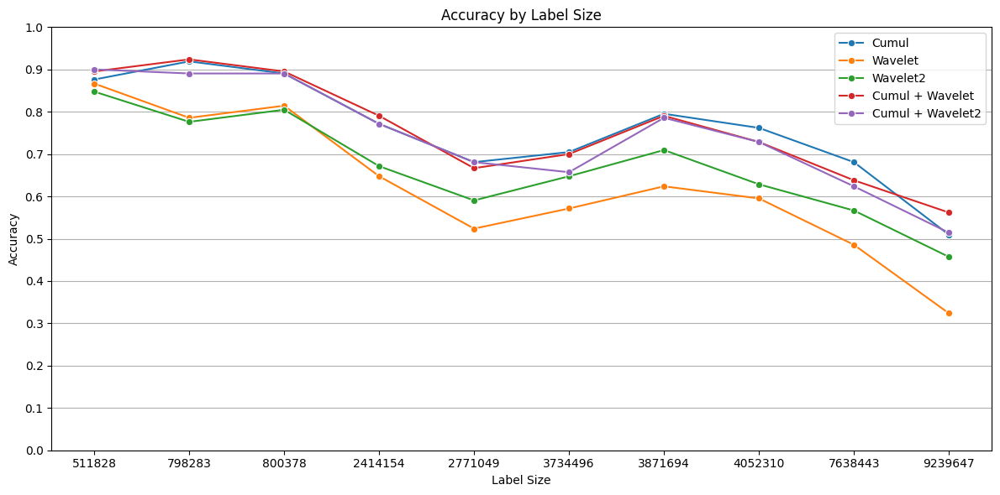

In [299]:
fig, ax = plt.subplots(figsize=(12, 6))

# Plot each DataFrame's accuracy on the same axis
sns.lineplot(x=cumul_metrics["Label Size"].astype(str), y=cumul_metrics["Accuracy"], marker='o', label="Cumul", ax=ax)
sns.lineplot(x=wavelet_metrics["Label Size"].astype(str), y=wavelet_metrics["Accuracy"], marker='o', label="Wavelet", ax=ax)
sns.lineplot(x=wavelet2_metrics["Label Size"].astype(str), y=wavelet2_metrics["Accuracy"], marker='o', label="Wavelet2", ax=ax)
sns.lineplot(x=cumul_wavelets_metrics["Label Size"].astype(str), y=cumul_wavelets_metrics["Accuracy"], marker='o', label="Cumul + Wavelet", ax=ax)
sns.lineplot(x=cumul_wavelets2_metrics["Label Size"].astype(str), y=cumul_wavelets2_metrics["Accuracy"], marker='o', label="Cumul + Wavelet2", ax=ax)

# Customize the plot to match the provided style
plt.title("Accuracy by Label Size")
plt.xlabel("Label Size")
plt.ylabel("Accuracy")
plt.ylim(0, 1)
plt.yticks(np.arange(0, 1.1, 0.1))
plt.grid(axis='y')
plt.tight_layout()

# Show the plot
plt.show()